In [1]:
#Astropy
import astropy
from astropy.io import fits
from astropy.table import Table

# Matplotlib
import matplotlib
import matplotlib.pyplot as plt
# %matplotlib inline
matplotlib.rcParams.update({'font.size': 25})

#Numpy/Scipy
import numpy as np
from scipy.interpolate import InterpolatedUnivariateSpline as IUS
from scipy.interpolate import UnivariateSpline as US
from scipy.optimize import curve_fit

from dlnpyutils import robust
from scipy.stats import binned_statistic, binned_statistic_2d
from tqdm import tqdm_notebook
from scipy.stats import binned_statistic_2d

import statsmodels.api as sm 
import itertools as it

In [2]:
leff = {'BP':0.5387,'G':0.6419,'RP':0.7667,'J':1.2345,'H':1.6393,'K':2.1757}
def ccm_a(x):
    '''
    a(x) function from Cardelli et al. 1989
    
    Input:
    -----
        x: effective wavelength in units of 1/micron
        
    Output:
    ------
        a: a function value  
    '''
    if 0.3 <= x < 1.1:
        a = 0.574*(x**1.61)
        return a
    
    elif 1.1 <= x < 3.3:
        y = x - 1.82
        a = (1.+0.17699*y-0.50477*(y**2)-0.02427*(y**3)+0.72085*(y**4)+
                0.01979*(y**5)-0.77530*(y**6)+0.32999*(y**7))
        return a
    
    elif 3.3 <= x < 8.0:
        if x < 5.9:
            a = 1.752-0.136*x-0.104/((x-4.67)**2+0.341)
            return a
        
        else:
            fa = -0.04473*((x-5.9)**2)+0.1207*((x-5.9)**3)
            a = 1.752-0.136*x-0.104/((x-4.67)**2+0.341)+fa
            return a       
    
def ccm_b(x):
    '''
    b(x) function from Cardelli et al. 1989
    
    Input:
    -----
        x: effective wavelength in units of 1/micron
        
    Output:
    ------
        b: b function value 
    '''
    if 0.3 <= x < 1.1:
        b = -0.527*(x**1.61)
        return b
    
    elif 1.1 <= x <= 3.3:
        y = x - 1.82
        b = (1.41338*y+2.28305*(y**2)+1.07233*(y**3)-5.38434*(y**4)-
                0.62251*(y**5)+5.30260*(y**6)-2.09002*(y**7))
        return b
    
    elif 3.3 <= x < 8.0:
        if x < 5.9:
            b = -3.090+1.825*x+1.206/((x-4.62)**2+0.263)
            return b
        
        else:
            fb = 0.2130*((x-5.9)**2)+0.1207*((x-5.9)**3)
            b = -3.090+1.825*x+1.206/((x-4.62)**2+0.263)+fb
            return b
    
def ccm_alav(wave,rv):
    '''
    Calculate A\lambda/Av
    
    Inputs:
    ------
        wave: effective wavelength in units of micron
        rv: Rv value (=Av/E(B_V))
        
    Output:
    ------
        alav: A\lambda/Av
    '''
    x=1/wave
    alav = ccm_a(x)+ccm_b(x)/rv
    return alav

ejk_ak = (ccm_alav(leff['J'],3.1)-ccm_alav(leff['K'],3.1))/ccm_alav(leff['K'],3.1)
ebv_ak = (ccm_alav(0.445,3.1)-ccm_alav(0.551,3.1))/ccm_alav(leff['K'],3.1)

def closest(data,value):
    '''
    Find nearest value in array to given value
        
    Inputs:
    ------
        data: data to search through 
        value: value of interest
    '''
        
    data = np.asarray(data)
    return data[(np.abs(np.subtract(data,value))).argmin()]

def mad(dat):
    return np.nanmedian(np.abs(dat-np.nanmedian(dat)))

abp_ebv = ccm_alav(leff['BP'],3.1)/(ccm_alav(0.445,3.1)-ccm_alav(0.551,3.1))
arp_ebv = ccm_alav(leff['RP'],3.1)/(ccm_alav(0.445,3.1)-ccm_alav(0.551,3.1))
aj_ebv = ccm_alav(leff['J'],3.1)/(ccm_alav(0.445,3.1)-ccm_alav(0.551,3.1))
ah_ebv = ccm_alav(leff['H'],3.1)/(ccm_alav(0.445,3.1)-ccm_alav(0.551,3.1))
ak_ebv = ccm_alav(leff['K'],3.1)/(ccm_alav(0.445,3.1)-ccm_alav(0.551,3.1))

ajak = ccm_alav(leff['J'],3.1)/ccm_alav(leff['K'],3.1)
ahak = ccm_alav(leff['H'],3.1)/ccm_alav(leff['K'],3.1)

<font size='45'>
    <b>
        Data
    </b>
</font>

# Parsec

In [3]:
massive = fits.getdata('/Users/joshuapovick/Desktop/Research/parsec/parsec_massive_lite.fits.gz')
massive = Table(massive[np.where(massive['label']==3.0)])
massive['index'] = np.arange(len(massive))
massive = massive[np.argsort(massive['logAge'])]
massive = massive['index','MH','Mass','logAge','logTe','logg','Gmag','G_BPmag','G_RPmag','Jmag','Hmag','Ksmag']

# APOKASC

<ipython-input-4-667563cc9a0d>:31: RuntimeWarning: invalid value encountered in sqrt
  apoafe_err = np.sqrt(kdr17['ALPHA_M']**2+kdr17['M_H']**2-kdr17['FE_H']**2)


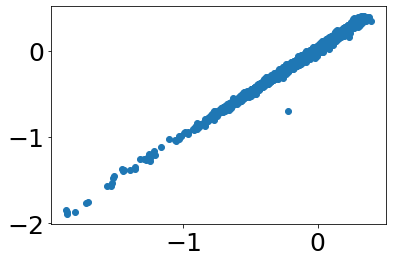

In [4]:
from astropy.io import ascii

kasc672 = fits.getdata('/Users/joshuapovick/Desktop/Research/APOKASC/APOKASC_cat_v6.7.2.fits.gz')
kasc3 = ascii.read('MLtesterr3bDR16A3PalphaM_july5.out')
dr17 = fits.getdata('/Users/joshuapovick/Desktop/Research/fits/allStarLite-dr17-synspec.fits.gz')
dr17max = fits.getdata('/Users/joshuapovick/Desktop/Research/fits/allStar-dr17-synspec.fits.gz')

# xmatch APOKASC Catalogs
_, k672idx, k3idx = np.intersect1d(kasc672['2MASS_ID'],kasc3['2MASSID'],return_indices=True)
k672 = kasc672[k672idx]
k3 = kasc3[k3idx]

# xmatch APOKASC with DR17
_, k3idx, dr17idx = np.intersect1d(k3['2MASSID'],dr17['APOGEE_ID'],return_indices=True)

k672dr17 = k672[k3idx]
k3dr17 = k3[k3idx]
kdr17 = dr17[dr17idx]
kdr17max = dr17max[dr17idx]

# Select RGB stars
ageevs = np.where((k3dr17['IntAge']>-10.)&(k672dr17['APOKASC3_CONS_EVSTATES']==1.0)&
                  (kdr17['GAIAEDR3_PARALLAX']/kdr17['GAIAEDR3_PARALLAX_ERROR']>3.0))

k672dr17 = k672dr17[ageevs]
k3dr17 = k3dr17[ageevs]
kdr17 = kdr17[ageevs]
kdr17max = kdr17max[ageevs]

apoafe = kdr17['ALPHA_M']+kdr17['M_H']-kdr17['FE_H']
apoafe_err = np.sqrt(kdr17['ALPHA_M']**2+kdr17['M_H']**2-kdr17['FE_H']**2)

plt.scatter(kdr17['FE_H'],k3dr17['Fe/H'])

# Gaia Magnitude Errors

In [5]:
from scipy.stats import binned_statistic
gaiaedr3 = fits.getdata('/Users/joshuapovick/Desktop/Research/gaia/GAIAEDR3allStar.fits.gz')

In [6]:
binnum = 75

### BP
bp_fin = np.where(np.isfinite(gaiaedr3['phot_bp_mean_mag'])==True)

bpmin = min(gaiaedr3['phot_bp_mean_mag'][bp_fin])
bpmax = max(gaiaedr3['phot_bp_mean_mag'][bp_fin])

bpdiff = bpmax-bpmin
bpfluxerr = (2.5*0.434)/gaiaedr3['phot_bp_mean_flux_over_error'][bp_fin]
bpmagerr = np.sqrt((bpfluxerr)**2+0.0027901700**2)

bpbin ,_,_ = binned_statistic(gaiaedr3['phot_bp_mean_mag'][bp_fin],np.log10(bpmagerr),'median',bins=binnum)

### RP 
rp_fin = np.where(np.isfinite(gaiaedr3['phot_rp_mean_mag'])==True)

rpmin = min(gaiaedr3['phot_rp_mean_mag'][rp_fin])
rpmax = max(gaiaedr3['phot_rp_mean_mag'][rp_fin])

rpdiff = rpmax-rpmin
rpfluxerr = (2.5*0.434)/gaiaedr3['phot_rp_mean_flux_over_error'][rp_fin]
rpmagerr = np.sqrt((rpfluxerr)**2+0.0037793818**2)

rpbin ,_,_ = binned_statistic(gaiaedr3['phot_rp_mean_mag'][rp_fin],np.log10(rpmagerr),'median',bins=binnum)

bperrfunc = IUS(np.arange(bpmin,bpmax,bpdiff/binnum),bpbin)
rperrfunc = IUS(np.arange(rpmin,rpmax,rpdiff/binnum),rpbin)

bperr = 10**bperrfunc(kdr17['GAIAEDR3_PHOT_BP_MEAN_MAG'])
rperr = 10**rperrfunc(kdr17['GAIAEDR3_PHOT_RP_MEAN_MAG'])

<font size='45'>
    <b>
      Teff and Log(g)  
    </b>
</font>

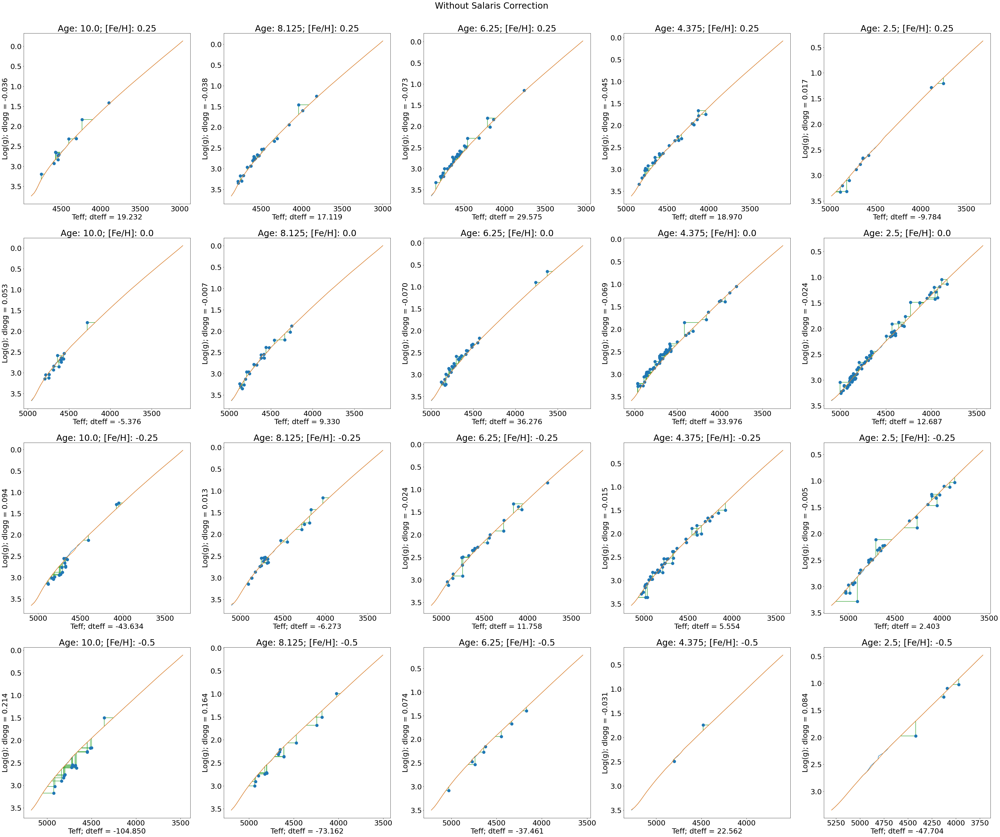

In [7]:
fehs = np.array([0.25,0.0,-0.25,-0.5])
ages = np.array([10,8.125,6.25,4.375,2.5])

dteff_arr = np.zeros((4,5))
dlogg_arr = np.zeros((4,5))

fig, ax = plt.subplots(4,5,figsize=[60,50])
for i in range(4):
    for j in range(5):
        
        ### Select stars and isochrone
        stars_select = np.where((k3dr17['IntAge']>=ages[j]-0.25)&(k3dr17['IntAge']<=ages[j]+0.25)&
                                (k3dr17['Fe/H']<=fehs[i]+0.05)&(k3dr17['Fe/H']>=fehs[i]-0.05))
        
        starslogg = k3dr17['Logg'][stars_select]
        starsteff = kdr17['TEFF'][stars_select]
        
        starslogg = starslogg[np.argsort(starsteff)]
        starsteff = starsteff[np.argsort(starsteff)]
        
        salcorr = 0 #np.median(np.log10(0.655*(10**(apoafe[stars_select]))+0.345))
        
        stars_iso = massive[np.where((massive['MH']==closest(massive['MH'],fehs[i]+salcorr))&
                                     (massive['logAge']==closest(massive['logAge'],np.log10(ages[j]*10**9))))]
        
        ### plot stars
        ax[i,j].scatter(starsteff,starslogg,s=100)
        
        ### dteff 
        stars_iso = stars_iso[np.argsort(stars_iso['logg'])]

        spl1 = US(stars_iso['logg'][::2],10**stars_iso['logTe'][::2],s=0)
        spl_xs1 = np.linspace(min(stars_iso['logg']),max(stars_iso['logg']))
        dteffs = starsteff-spl1(starslogg)
        dteff_arr[i,j] = np.nanmedian(dteffs)
        
        for k in range(len(dteffs)):
            ax[i,j].hlines(y=starslogg[k],xmin=starsteff[k],xmax=starsteff[k]-dteffs[k],
                           color='tab:green',zorder=0)
        
        ax[i,j].plot(spl1(spl_xs1),spl_xs1)
        
        ### dlogg
        stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]
        
        spl2 = US(10**stars_iso['logTe'][::2],stars_iso['logg'][::2],s=0)
        spl_xs2 = np.linspace(min(10**stars_iso['logTe']),max(10**stars_iso['logTe']))
        dloggs = starslogg - spl2(starsteff)
        dlogg_arr[i,j] = np.nanmedian(dloggs)
        
        for k in range(len(dloggs)):
            ax[i,j].vlines(x=starsteff[k],ymin=starslogg[k],ymax=starslogg[k]-dloggs[k],
                           color='tab:green',zorder=0)
            
        ax[i,j].plot(spl_xs2,spl2(spl_xs2))
        
        ### Formatting
        ax[i,j].invert_xaxis()
        ax[i,j].invert_yaxis()
        
        ax[i,j].set_title(r'Age: {}; [Fe/H]: {}'.format(ages[j],fehs[i]))
        
        ax[i,j].set_xlabel(r'Teff; dteff = {:.3f}'.format(np.nanmedian(dteffs)))
        ax[i,j].set_ylabel(r'Log(g); dlogg = {:.3f}'.format(np.nanmedian(dloggs)))

plt.suptitle(r'Without Salaris Correction',y=0.91)
plt.savefig('../plots/isochrone_compare_NoSalaris.pdf',dpi=300,bbox_inches='tight')
plt.show()

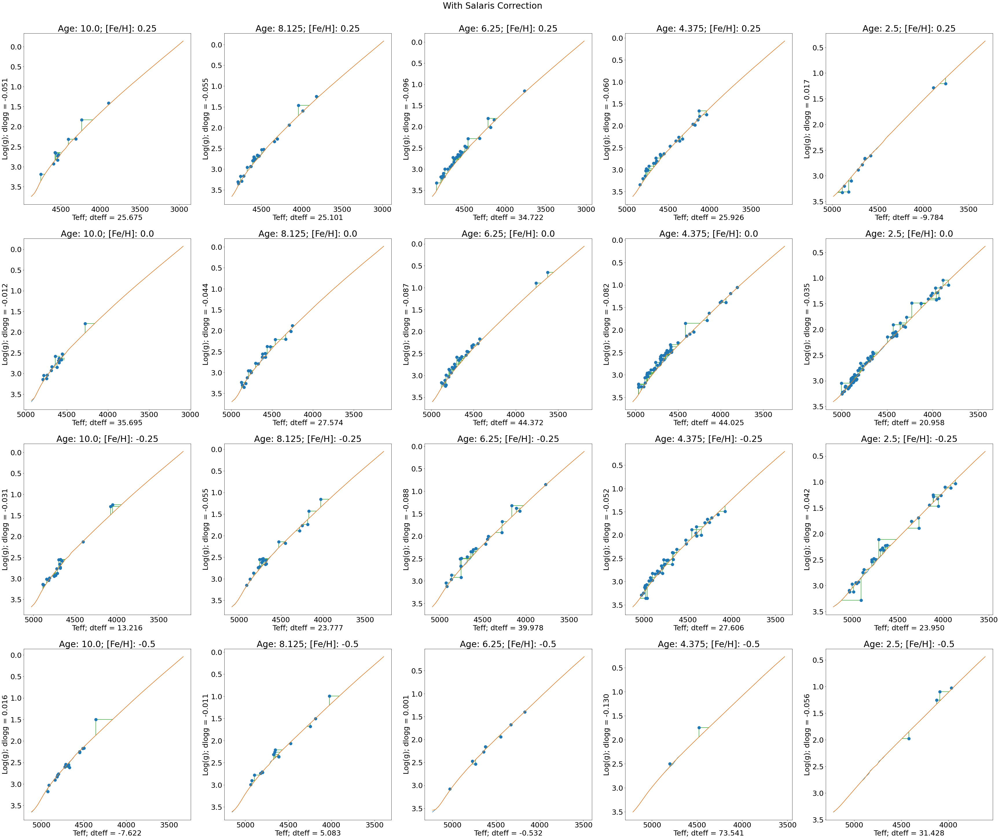

In [8]:
fehs = np.array([0.25,0.0,-0.25,-0.5])
ages = np.array([10,8.125,6.25,4.375,2.5])

dteff_arr_salaris = np.zeros((4,5))
dlogg_arr_salaris = np.zeros((4,5))

fehs_arr = np.zeros((4,5))
ages_arr = np.zeros((4,5))

alpha_arr = np.zeros((4,5))
salcorr_arr = np.zeros((4,5))

ids_single = np.array([])

sal_dlg_single = np.array([])
sal_dlt_single = np.array([])

fig, ax = plt.subplots(4,5,figsize=[60,50])
for i in range(4):
    for j in range(5):
        
        fehs_arr[i,j] = fehs[i]
        ages_arr[i,j] = ages[j]
        
        ### Select stars and their properties
        stars_select = np.where((k3dr17['IntAge']>=ages[j]-0.25)&(k3dr17['IntAge']<=ages[j]+0.25)&
                                (k3dr17['Fe/H']<=fehs[i]+0.05)&(k3dr17['Fe/H']>=fehs[i]-0.05))
        
        starslogg = k3dr17['Logg'][stars_select]
        starsids = kdr17['APOGEE_ID'][stars_select]
        starsteff = kdr17['TEFF'][stars_select]
        
        salcorr = np.nanmedian(np.log10(0.655*(10**(apoafe[stars_select]))+0.345))
        starsals = np.log10(0.655*(10**(apoafe[stars_select]))+0.345)
        alpha_arr[i,j] = np.nanmedian(apoafe[stars_select])
        salcorr_arr[i,j] = salcorr
        
        starsids = starsids[np.argsort(starsteff)]
        ids_single = np.append(ids_single,starsids)

        ### Select isochrone
        stars_iso = massive[np.where((massive['MH']==closest(massive['MH'],fehs[i]+salcorr))&
                                     (massive['logAge']==closest(massive['logAge'],np.log10(ages[j]*10**9))))]
        
        ### plot stars
        ax[i,j].scatter(starsteff,starslogg,s=100)
        
        ### dteff
        stars_iso = stars_iso[np.argsort(stars_iso['logg'])]

        spl1 = US(stars_iso['logg'][::2],10**stars_iso['logTe'][::2],s=0)
        spl_xs1 = np.linspace(min(stars_iso['logg']),max(stars_iso['logg']))
        dteffs = starsteff-spl1(starslogg)
        sal_dlt_single = np.append(sal_dlt_single,dteffs)
        dteff_arr_salaris[i,j] = np.nanmedian(dteffs)
        
        for k in range(len(dteffs)):
            ax[i,j].hlines(y=starslogg[k],xmin=starsteff[k],xmax=starsteff[k]-dteffs[k],
                           color='tab:green',zorder=0)
        
        ax[i,j].plot(spl1(spl_xs1),spl_xs1)
        
        ### dlogg
        stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]
        
        spl2 = US(10**stars_iso['logTe'][::2],stars_iso['logg'][::2],s=0)
        spl_xs2 = np.linspace(min(10**stars_iso['logTe']),max(10**stars_iso['logTe']))
        dloggs = starslogg - spl2(starsteff)
        sal_dlg_single = np.append(sal_dlg_single,dloggs)
        dlogg_arr_salaris[i,j] = np.nanmedian(dloggs)
        
        for k in range(len(dloggs)):
            ax[i,j].vlines(x=starsteff[k],ymin=starslogg[k],ymax=starslogg[k]-dloggs[k],
                           color='tab:green',zorder=0)
            
        ax[i,j].plot(spl_xs2,spl2(spl_xs2))
        
        ### Formatting
        ax[i,j].invert_xaxis()
        ax[i,j].invert_yaxis()
        
        ax[i,j].set_title(r'Age: {}; [Fe/H]: {}'.format(ages[j],fehs[i]))
        
        ax[i,j].set_xlabel(r'Teff; dteff = {:.3f}'.format(np.nanmedian(dteffs)))
        ax[i,j].set_ylabel(r'Log(g); dlogg = {:.3f}'.format(np.nanmedian(dloggs)))

plt.suptitle(r'With Salaris Correction',y=0.91)
plt.savefig('../plots/isochrone_compare_Salaris.pdf',dpi=300,bbox_inches='tight')
plt.show()

# Old Shifts Teff-Log(g)

/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


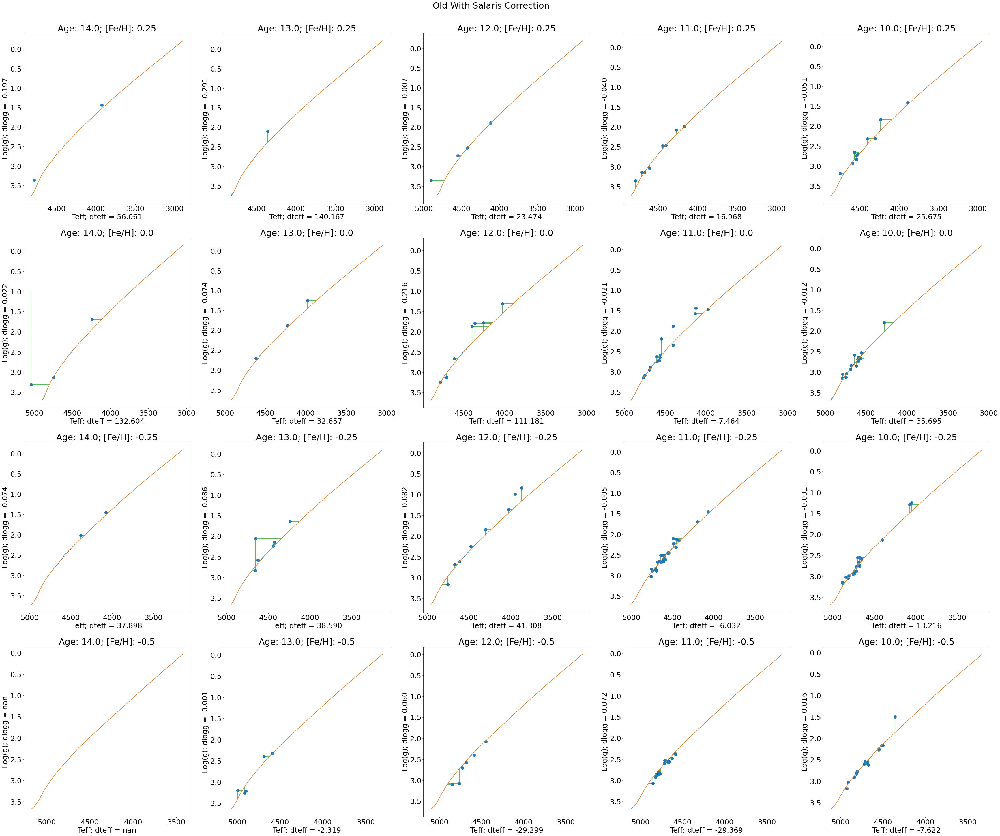

In [355]:
fehs = np.array([0.25,0.0,-0.25,-0.5])
ages = np.array([14.,13.,12.,11.,10.])

dteff_arr_salaris_old = np.zeros((4,5))
dlogg_arr_salaris_old = np.zeros((4,5))

fehs_arr_old = np.zeros((4,5))
ages_arr_old = np.zeros((4,5))

alpha_arr_old = np.zeros((4,5))
salcorr_arr_old = np.zeros((4,5))

ids_single_old = np.array([])

sal_dlg_single_old = np.array([])
sal_dlt_single_old = np.array([])

fig, ax = plt.subplots(4,5,figsize=[60,50])
for i in range(4):
    for j in range(5):
        
        fehs_arr_old[i,j] = fehs[i]
        ages_arr_old[i,j] = ages[j]
        
        ### Select stars and their properties
        stars_select = np.where((k3dr17['IntAge']>=ages[j]-0.25)&(k3dr17['IntAge']<=ages[j]+0.25)&
                                (k3dr17['Fe/H']<=fehs[i]+0.05)&(k3dr17['Fe/H']>=fehs[i]-0.05))
        
        starslogg = k3dr17['Logg'][stars_select]
        starsids = kdr17['APOGEE_ID'][stars_select]
        starsteff = kdr17['TEFF'][stars_select]
        
        salcorr = np.nanmedian(np.log10(0.655*(10**(apoafe[stars_select]))+0.345))
        starsals = np.log10(0.655*(10**(apoafe[stars_select]))+0.345)
        alpha_arr_old[i,j] = np.nanmedian(apoafe[stars_select])
        salcorr_arr_old[i,j] = salcorr
        
        starsids = starsids[np.argsort(starsteff)]
        ids_single_old = np.append(ids_single_old,starsids)

        ### Select isochrone
        stars_iso = massive[np.where((massive['MH']==closest(massive['MH'],fehs[i]+salcorr))&
                                     (massive['logAge']==closest(massive['logAge'],np.log10(ages[j]*10**9))))]
        
        ### plot stars
        ax[i,j].scatter(starsteff,starslogg,s=100)
        
        ### dteff
        stars_iso = stars_iso[np.argsort(stars_iso['logg'])]

        spl1 = US(stars_iso['logg'][::2],10**stars_iso['logTe'][::2],s=0)
        spl_xs1 = np.linspace(min(stars_iso['logg']),max(stars_iso['logg']))
        dteffs = starsteff-spl1(starslogg)
        sal_dlt_single_old = np.append(sal_dlt_single_old,dteffs)
        dteff_arr_salaris_old[i,j] = np.nanmedian(dteffs)
        
        for k in range(len(dteffs)):
            ax[i,j].hlines(y=starslogg[k],xmin=starsteff[k],xmax=starsteff[k]-dteffs[k],
                           color='tab:green',zorder=0)
        
        ax[i,j].plot(spl1(spl_xs1),spl_xs1)
        
        ### dlogg
        stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]
        
        spl2 = US(10**stars_iso['logTe'][::2],stars_iso['logg'][::2],s=0)
        spl_xs2 = np.linspace(min(10**stars_iso['logTe']),max(10**stars_iso['logTe']))
        dloggs = starslogg - spl2(starsteff)
        sal_dlg_single_old = np.append(sal_dlg_single_old,dloggs)
        dlogg_arr_salaris_old[i,j] = np.nanmedian(dloggs)
        
        for k in range(len(dloggs)):
            ax[i,j].vlines(x=starsteff[k],ymin=starslogg[k],ymax=starslogg[k]-dloggs[k],
                           color='tab:green',zorder=0)
            
        ax[i,j].plot(spl_xs2,spl2(spl_xs2))
        
        ### Formatting
        ax[i,j].invert_xaxis()
        ax[i,j].invert_yaxis()
        
        ax[i,j].set_title(r'Age: {}; [Fe/H]: {}'.format(ages[j],fehs[i]))
        
        ax[i,j].set_xlabel(r'Teff; dteff = {:.3f}'.format(np.nanmedian(dteffs)))
        ax[i,j].set_ylabel(r'Log(g); dlogg = {:.3f}'.format(np.nanmedian(dloggs)))

plt.suptitle(r'Old With Salaris Correction',y=0.91)
plt.savefig('../plots/isochrone_compare_Salaris_old.pdf',dpi=300,bbox_inches='tight')
plt.show()

# Young Shifts Teff-Log(g)

/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=ke

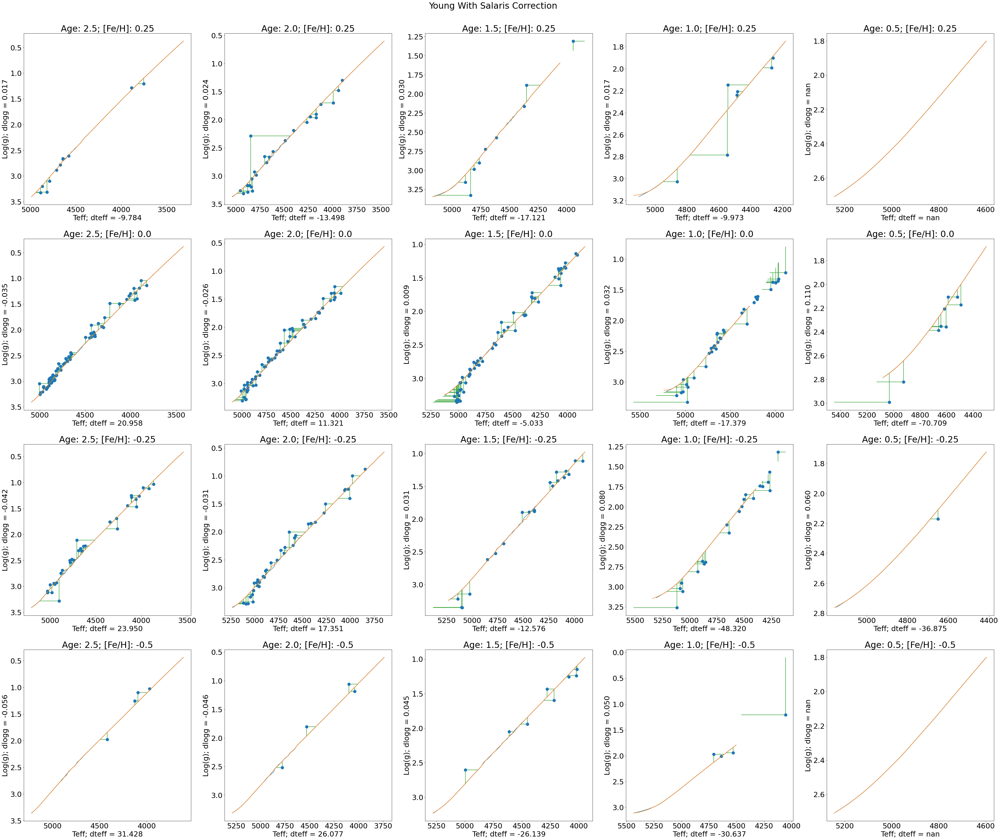

In [357]:
fehs = np.array([0.25,0.0,-0.25,-0.5])
ages =  np.array([2.5,2.0,1.5,1.0,0.5])

dteff_arr_salaris_young = np.zeros((4,5))
dlogg_arr_salaris_young = np.zeros((4,5))

fehs_arr_young = np.zeros((4,5))
ages_arr_young = np.zeros((4,5))

alpha_arr_young = np.zeros((4,5))
salcorr_arr_young = np.zeros((4,5))

ids_single_young = np.array([])

sal_dlg_single_young = np.array([])
sal_dlt_single_young = np.array([])

fig, ax = plt.subplots(4,5,figsize=[60,50])
for i in range(4):
    for j in range(5):
        
        fehs_arr_young[i,j] = fehs[i]
        ages_arr_young[i,j] = ages[j]
        
        ### Select stars and their properties
        stars_select = np.where((k3dr17['IntAge']>=ages[j]-0.25)&(k3dr17['IntAge']<=ages[j]+0.25)&
                                (k3dr17['Fe/H']<=fehs[i]+0.05)&(k3dr17['Fe/H']>=fehs[i]-0.05))
        
        starslogg = k3dr17['Logg'][stars_select]
        starsids = kdr17['APOGEE_ID'][stars_select]
        starsteff = kdr17['TEFF'][stars_select]
        
        salcorr = np.nanmedian(np.log10(0.655*(10**(apoafe[stars_select]))+0.345))
        starsals = np.log10(0.655*(10**(apoafe[stars_select]))+0.345)
        alpha_arr_young[i,j] = np.nanmedian(apoafe[stars_select])
        salcorr_arr_young[i,j] = salcorr
        
        starsids = starsids[np.argsort(starsteff)]
        ids_single_young = np.append(ids_single_young,starsids)

        ### Select isochrone
        stars_iso = massive[np.where((massive['MH']==closest(massive['MH'],fehs[i]+salcorr))&
                                     (massive['logAge']==closest(massive['logAge'],np.log10(ages[j]*10**9))))]
        
        ### plot stars
        ax[i,j].scatter(starsteff,starslogg,s=100)
        
        ### dteff
        stars_iso = stars_iso[np.argsort(stars_iso['logg'])]

        spl1 = US(stars_iso['logg'][::2],10**stars_iso['logTe'][::2],s=0)
        spl_xs1 = np.linspace(min(stars_iso['logg']),max(stars_iso['logg']))
        dteffs = starsteff-spl1(starslogg)
        sal_dlt_single_young = np.append(sal_dlt_single_young,dteffs)
        dteff_arr_salaris_young[i,j] = np.nanmedian(dteffs)
        
        for k in range(len(dteffs)):
            ax[i,j].hlines(y=starslogg[k],xmin=starsteff[k],xmax=starsteff[k]-dteffs[k],
                           color='tab:green',zorder=0)
        
        ax[i,j].plot(spl1(spl_xs1),spl_xs1)
        
        ### dlogg
        stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]
        
        spl2 = US(10**stars_iso['logTe'][::2],stars_iso['logg'][::2],s=0)
        spl_xs2 = np.linspace(min(10**stars_iso['logTe']),max(10**stars_iso['logTe']))
        dloggs = starslogg - spl2(starsteff)
        sal_dlg_single_young = np.append(sal_dlg_single_young,dloggs)
        dlogg_arr_salaris_young[i,j] = np.nanmedian(dloggs)
        
        for k in range(len(dloggs)):
            ax[i,j].vlines(x=starsteff[k],ymin=starslogg[k],ymax=starslogg[k]-dloggs[k],
                           color='tab:green',zorder=0)
            
        ax[i,j].plot(spl_xs2,spl2(spl_xs2))
        
        ### Formatting
        ax[i,j].invert_xaxis()
        ax[i,j].invert_yaxis()
        
        ax[i,j].set_title(r'Age: {}; [Fe/H]: {}'.format(ages[j],fehs[i]))
        
        ax[i,j].set_xlabel(r'Teff; dteff = {:.3f}'.format(np.nanmedian(dteffs)))
        ax[i,j].set_ylabel(r'Log(g); dlogg = {:.3f}'.format(np.nanmedian(dloggs)))

plt.suptitle(r'Young With Salaris Correction',y=0.91)
plt.savefig('../plots/isochrone_compare_Salaris_young.pdf',dpi=300,bbox_inches='tight')
plt.show()

In [9]:
c1 = fits.Column(name='FE_H', array=fehs_arr.ravel(), format='E')
c2 = fits.Column(name='FE_H_SALARIS', array=salcorr_arr.ravel(), format='E')
c3 = fits.Column(name='ALPHA_FE', array=alpha_arr.ravel(), format='E')
c4 = fits.Column(name='AGE', array=ages_arr.ravel(), format='E')
c5 = fits.Column(name='DTEFF', array=dteff_arr.ravel(), format='E')
c6 = fits.Column(name='DTEFF_SALARIS', array=dteff_arr_salaris.ravel(), format='E')
c7 = fits.Column(name='DLOGG', array=dlogg_arr.ravel(), format='E')
c8 = fits.Column(name='DLOGG_SALARIS', array=dlogg_arr_salaris.ravel(), format='E')

table_hdu = fits.BinTableHDU.from_columns([c1, c2, c3, c4, c5, c6, c7, c8])
table_hdu.writeto('isochrone_shifts.fits',overwrite=True)

shift = Table(fits.getdata('isochrone_shifts.fits'))
shift.columns

<TableColumns names=('FE_H','FE_H_SALARIS','ALPHA_FE','AGE','DTEFF','DTEFF_SALARIS','DLOGG','DLOGG_SALARIS')>

In [10]:
shift

FE_H,FE_H_SALARIS,ALPHA_FE,AGE,DTEFF,DTEFF_SALARIS,DLOGG,DLOGG_SALARIS
float32,float32,float32,float32,float32,float32,float32,float32
0.25,0.03930176,0.0586555,10.0,19.231604,25.674973,-0.035659403,-0.05098512
0.25,0.023674851,0.035644554,8.125,17.119152,25.100933,-0.03773554,-0.055155568
0.25,0.02425673,0.0365085,6.25,29.574804,34.72181,-0.07292667,-0.096344545
0.25,0.020876773,0.03148225,4.375,18.970068,25.926023,-0.04507876,-0.060408287
0.25,0.005464894,0.008315995,2.5,-9.783704,-9.783704,0.016646001,0.016646001
0.0,0.062582605,0.0922446,10.0,-5.376014,35.694954,0.053368397,-0.012287725
0.0,0.033403516,0.0500158,8.125,9.330027,27.573906,-0.0071319477,-0.043690797
0.0,0.029361835,0.0440642,6.25,36.276363,44.372166,-0.070391424,-0.08680267
0.0,0.02366926,0.0356362,4.375,33.9759,44.024635,-0.06877852,-0.08219561


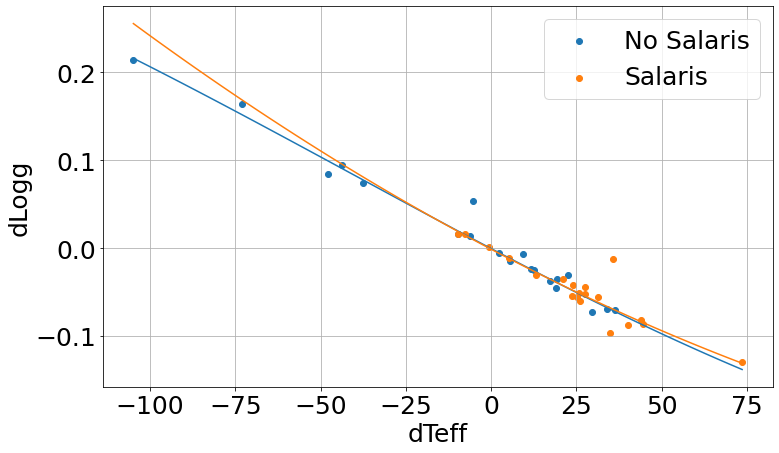

In [11]:
plt.figure(figsize=[12,7])
plt.scatter(shift['DTEFF'],shift['DLOGG'],label='No Salaris')

poly = np.poly1d(robust.polyfit(shift['DTEFF'][np.argsort(shift['DTEFF'])]
                            ,shift['DLOGG'][np.argsort(shift['DTEFF'])],3))
poly_xs = np.linspace(min(shift['DTEFF']),max(shift['DTEFF_SALARIS']))
plt.plot(poly_xs,poly(poly_xs),c='tab:blue')

plt.scatter(shift['DTEFF_SALARIS'],shift['DLOGG_SALARIS'],label='Salaris')

poly_sal = np.poly1d(robust.polyfit(shift['DTEFF_SALARIS'][np.argsort(shift['DTEFF_SALARIS'])]
                            ,shift['DLOGG_SALARIS'][np.argsort(shift['DTEFF_SALARIS'])],2))
poly_sal_xs = np.linspace(min(shift['DTEFF']),max(shift['DTEFF_SALARIS']))
plt.plot(poly_sal_xs,poly_sal(poly_sal_xs),c='tab:orange')

plt.legend()

plt.grid()

plt.xlabel(r'dTeff')
plt.ylabel(r'dLogg')
plt.savefig('../plots/dloggdteff.pdf',dpi=300,bbox_inches='tight')
plt.show()

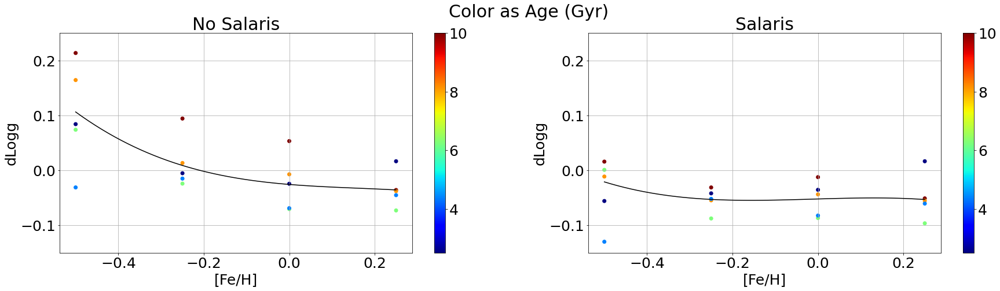

In [12]:
plt.figure(figsize=[30,7])
plt.suptitle(r'Color as Age (Gyr)')

plt.subplot(121)
plt.scatter(shift['FE_H'],shift['DLOGG'],c=shift['AGE'],cmap='jet',label='No Salaris')
plt.colorbar()

poly = np.poly1d(robust.polyfit(shift['FE_H'][np.argsort(shift['FE_H'])],
                                shift['DLOGG'][np.argsort(shift['FE_H'])],3))
poly_xs = np.linspace(min(shift['FE_H'][np.argsort(shift['FE_H'])]),
                           max(shift['FE_H'][np.argsort(shift['FE_H'])]))
plt.plot(poly_xs,poly(poly_xs),c='k')

plt.title(r'No Salaris')
plt.ylabel(r'dLogg')
plt.xlabel(r'[Fe/H]')

plt.ylim(-0.15,0.25)

plt.grid()

plt.subplot(122)
plt.scatter(shift['FE_H'],shift['DLOGG_SALARIS'],c=shift['AGE'],cmap='jet',label='Salaris')
plt.colorbar()

poly_sal = np.poly1d(robust.polyfit(shift['FE_H'][np.argsort(shift['FE_H'])],
                                shift['DLOGG_SALARIS'][np.argsort(shift['FE_H'])],3))
poly_sal_xs = np.linspace(min(shift['FE_H'][np.argsort(shift['FE_H'])]),
                           max(shift['FE_H'][np.argsort(shift['FE_H'])]))
plt.plot(poly_sal_xs,poly_sal(poly_sal_xs),c='k')

plt.title(r'Salaris')
plt.ylabel(r'dLogg')
plt.xlabel(r'[Fe/H]')

plt.ylim(-0.15,0.25)

plt.grid()

plt.savefig('../plots/feh_dlogg_age.pdf',dpi=300,bbox_inches='tight')
plt.show()

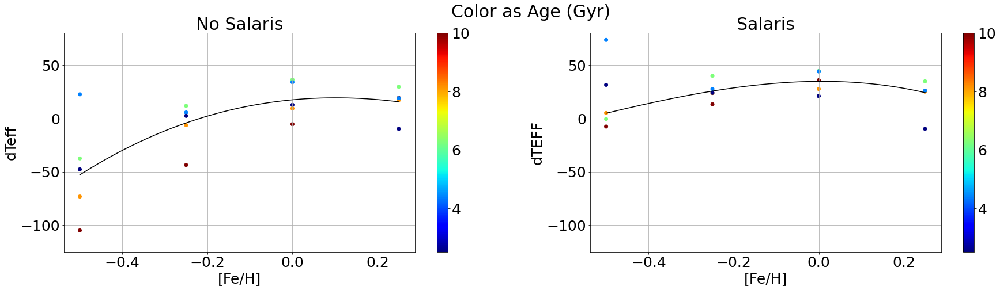

In [13]:
plt.figure(figsize=[30,7])
plt.suptitle(r'Color as Age (Gyr)')

plt.subplot(121)
plt.scatter(shift['FE_H'],shift['DTEFF'],c=shift['AGE'],cmap='jet',label='No Salaris')
plt.colorbar()

poly = np.poly1d(robust.polyfit(shift['FE_H'][np.argsort(shift['FE_H'])],
                                shift['DTEFF'][np.argsort(shift['FE_H'])],3))
poly_xs = np.linspace(min(shift['FE_H'][np.argsort(shift['FE_H'])]),
                           max(shift['FE_H'][np.argsort(shift['FE_H'])]))
plt.plot(poly_xs,poly(poly_xs),c='k')

plt.title(r'No Salaris')
plt.ylabel(r'dTeff')
plt.xlabel(r'[Fe/H]')

plt.ylim(-125,80)

plt.grid()

plt.subplot(122)
plt.scatter(shift['FE_H'],shift['DTEFF_SALARIS'],c=shift['AGE'],cmap='jet',label='Salaris')
plt.colorbar()

poly_sal = np.poly1d(robust.polyfit(shift['FE_H'][np.argsort(shift['FE_H'])],
                                shift['DTEFF_SALARIS'][np.argsort(shift['FE_H'])],3))
poly_sal_xs = np.linspace(min(shift['FE_H'][np.argsort(shift['FE_H'])]),
                           max(shift['FE_H'][np.argsort(shift['FE_H'])]))
plt.plot(poly_sal_xs,poly_sal(poly_sal_xs),c='k')

plt.title(r'Salaris')
plt.ylabel(r'dTEFF')
plt.xlabel(r'[Fe/H]')

plt.ylim(-125,80)

plt.grid()

plt.savefig('../plots/feh_dteff_age.pdf',dpi=300,bbox_inches='tight')
plt.show()

# Individual Stars

In [14]:
kdteffs = 999999.0*np.ones(len(kdr17))
kdloggs = 999999.0*np.ones(len(kdr17))

for i in tqdm_notebook(range(len(kdr17))):
    
    salcorr = np.nanmedian(np.log10(0.655*(10**(apoafe[i]))+0.345))

    stars_iso = massive[np.where((massive['MH']==closest(massive['MH'],kdr17['FE_H'][i]+salcorr))&
                             (massive['logAge']==closest(massive['logAge'],np.log10(k3dr17['IntAge'][i]*10**9))))]
    
    try:
        
        ### dteff 
        stars_iso = stars_iso[np.argsort(stars_iso['logg'])]
        spl1 = US(stars_iso['logg'][::2],10**stars_iso['logTe'][::2],s=0)
        kdteffs[i] = kdr17['Teff'][i]-spl1(k3dr17['Logg'][i])

        ### dlogg
        stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]
        spl2 = US(10**stars_iso['logTe'][::2],stars_iso['logg'][::2],s=0)
        kdloggs[i] = k3dr17['Logg'][i] - spl2(k3dr17['Teff'][i])
    
    except:
        
        try:
            ### dteff 
            stars_iso = stars_iso[np.argsort(stars_iso['logg'])]
            spl1 = US(stars_iso['logg'][::3],10**stars_iso['logTe'][::3],s=0)
            kdteffs[i] = kdr17['Teff'][i]-spl1(k3dr17['Logg'][i])

            ### dlogg
            stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]
            spl2 = US(10**stars_iso['logTe'][::3],stars_iso['logg'][::3],s=0)
            kdloggs[i] = k3dr17['Logg'][i] - spl2(k3dr17['Teff'][i])
            
        except:
            kdteffs[i] = 999999.0
            kdloggs[i] = 999999.0

<ipython-input-14-035391b272fb>:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i in tqdm_notebook(range(len(kdr17))):


/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


Text(0, 0.5, 'dLogg')

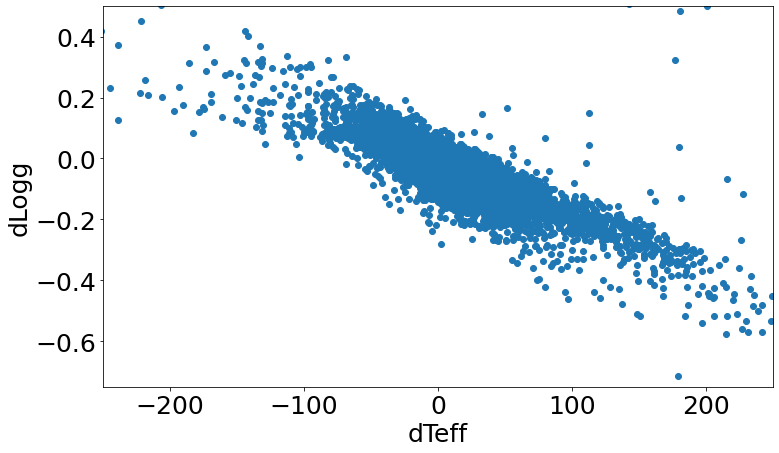

In [15]:
plt.figure(figsize=[12,7])
plt.scatter(kdteffs,kdloggs)
plt.xlim(-250,250)
plt.ylim(-0.75,0.5)
plt.xlabel(r'dTeff')
plt.ylabel(r'dLogg')

## Iron dTeff From Teff-log(g)

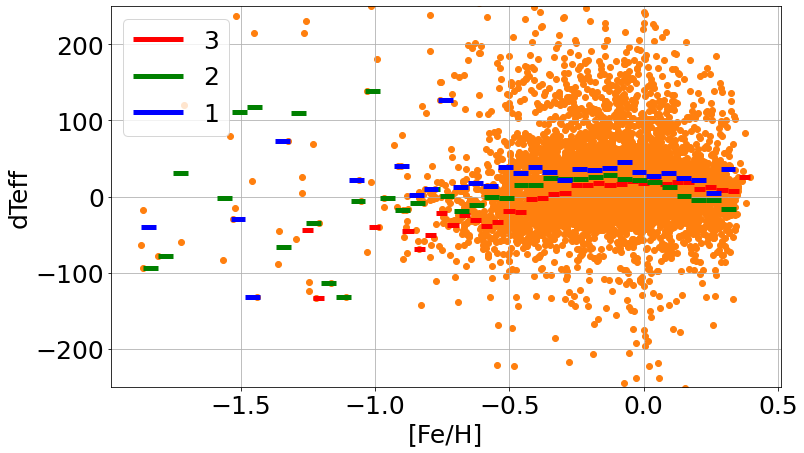

In [16]:
dfull_colors = np.array([kdr17['TEFF'],k3dr17['Logg'],apoafe,k3dr17['IntAge']])
dfull_titles = np.array(['Teff','Log(g)','[alpha/Fe]','Age'])

binhalf = 0.5
lgg3 = np.where((k3dr17['Logg']<3.0+binhalf)&(k3dr17['Logg']>3.0-binhalf)&
                (np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(kdteffs)==True))
lgg2 = np.where((k3dr17['Logg']<2.0+binhalf)&(k3dr17['Logg']>2.0-binhalf)&
                (np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(kdteffs)==True))
lgg1 = np.where((k3dr17['Logg']<1.0+binhalf)&(k3dr17['Logg']>1.0-binhalf)&
                (np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(kdteffs)==True))
    
bin_means3, bin_edges3, _ = binned_statistic(kdr17['FE_H'][lgg3],kdteffs[lgg3],statistic='median',bins=40)
bin_means2, bin_edges2, _ = binned_statistic(kdr17['FE_H'][lgg2],kdteffs[lgg2],statistic='median',bins=40)
bin_means1, bin_edges1, _ = binned_statistic(kdr17['FE_H'][lgg1],kdteffs[lgg1],statistic='median',bins=40)

plt.figure(figsize=[12,7])
# plt.scatter(kdr17['FE_H'][lgg3],kdteffs[lgg3],c='r',label='3.0')
# plt.scatter(kdr17['FE_H'][lgg2],kdteffs[lgg2],c='g',label='2.0')
# plt.scatter(kdr17['FE_H'][lgg1],kdteffs[lgg1],c='b',label='1.0')

plt.scatter(kdr17['FE_H'],kdteffs,c='tab:orange')

# plt.colorbar()

plt.hlines(bin_means3, bin_edges3[:-1], bin_edges3[1:], colors='r', lw=5.,label='3')
plt.hlines(bin_means2, bin_edges2[:-1], bin_edges2[1:], colors='g', lw=5.,label='2')
plt.hlines(bin_means1, bin_edges1[:-1], bin_edges1[1:], colors='b', lw=5.,label='1')
plt.legend()

plt.ylim(-250,250)

# plt.title(r'Color as {}')
plt.xlabel(r'[Fe/H]')
plt.ylabel(r'dTeff')
plt.grid()
plt.show()

In [144]:


# def dteff_feh(feh,feh0,dteff0,a,b):
#     if feh < feh0:
#         return dteff0
#     else:
#         return a*(feh**2-feh0**2)+b*(feh-feh0)+dteff0
    
# dteff_feh_vec = np.vectorize(dteff_feh)

# def dteff_feh_vec_self(feh,feh0,dteff0,a,b):
#     y = np.zeros(feh.shape)
#     for i in range(len(y)):
#         y[i] = dteff_feh(feh[i],feh0,dteff0,a,b)
#     return y

# def dteff_feh(feh,feh0,dteff0,a,b):
#     return np.piecewise(feh,[feh < feh0],[lambda feh: dteff0,
#                                                       lambda feh: a*(feh**2-feh0**2)+b*(feh-feh0)+dteff0])

# cut = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(kdteffs)==True)&(kdteffs>-250)&(kdteffs<250))
# bin_means, bin_edges, _ = binned_statistic(kdr17['FE_H'][cut],kdteffs[cut],statistic='median',bins=40)
# bin_centers = (bin_edges[:-1]+np.diff(bin_edges)/2)

# fincut = np.where((np.isfinite(bin_means)==True)&(np.isfinite(bin_centers)==True))
# popt, _ = curve_fit(dteff_feh,bin_centers[fincut],bin_means[fincut])
# print(popt)

# xs = np.linspace(min(kdr17['FE_H'][cut]),max(kdr17['FE_H'][cut]))

# plt.figure(figsize=[12,7])
# plt.scatter(kdr17['FE_H'],kdteffs,c='tab:blue')
# plt.plot(xs,dteff_feh(xs,*popt),c='k')
# plt.ylim(-250,250)
# plt.plot()

Fit Parameters:
a = -110.86459
b = -11.38174
feh0 = -0.69217
dteff0 = -24.20264


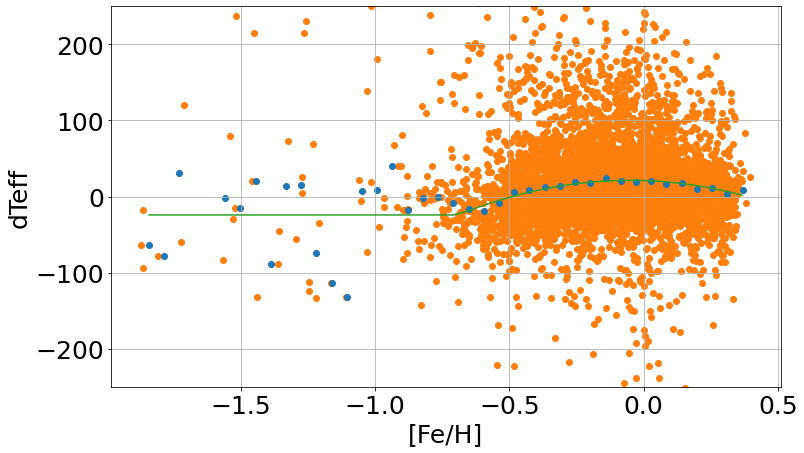

In [241]:
from scipy.optimize import curve_fit

def dteff_feh(x,a,b,feh0,dteff0):
    return np.piecewise(x,[x<feh0],[lambda x: dteff0, 
                                    lambda x: a*(x**2-feh0**2)+b*(x-feh0)+dteff0])

cut = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(kdteffs)==True)&(kdteffs>-250)&(kdteffs<250))
bin_means, bin_edges, _ = binned_statistic(kdr17['FE_H'][cut],kdteffs[cut],statistic='median',bins=40)
bin_centers = (bin_edges[:-1]+np.diff(bin_edges)/2)

fincut = np.where((np.isfinite(bin_means)==True)&(np.isfinite(bin_centers)==True))

param_labels = np.array(['a','b','feh0','dteff0'])
popt_feh, _ = curve_fit(dteff_feh, bin_centers[fincut], bin_means[fincut], p0 = [1., 1., -0.5, 0.])

print('Fit Parameters:')
for i in range(4):
    print(r'{} = {:.5f}'.format(param_labels[i],popt[i]))

plt.figure(figsize=[12,7])
plt.scatter(kdr17['FE_H'],kdteffs,c='tab:orange')
plt.scatter(bin_centers[fincut], bin_means[fincut],c='tab:blue')
plt.plot(bin_centers[fincut],dteff_feh(bin_centers[fincut],*popt),c='tab:green')
plt.ylim(-250,250)
plt.grid()

plt.xlabel(r'[Fe/H]')
plt.ylabel(r'dTeff')
plt.show()

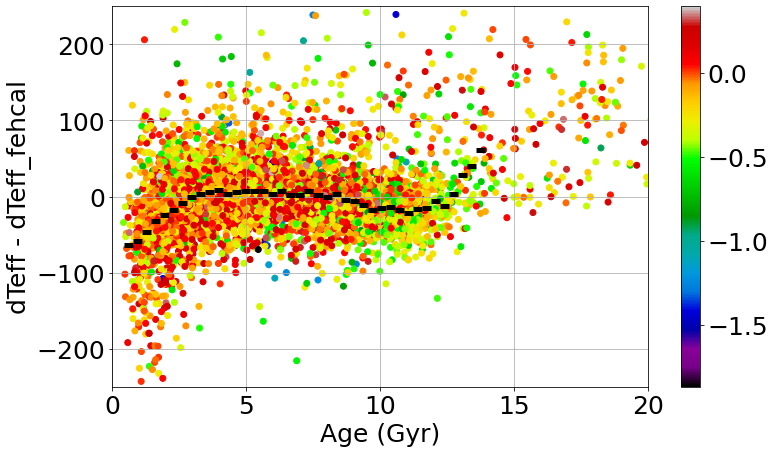

Fit Parameters:
a = 0.38488
b = -8.61162
c = 56.32289
dteff0_age = 45.25014


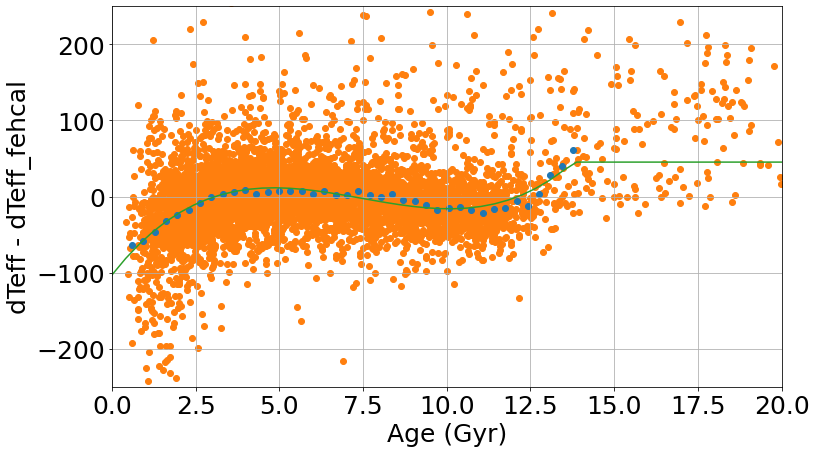

In [172]:
dteff_resid = kdteffs-dteff_feh(kdr17['FE_H'],*popt)

cut = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(k3dr17['IntAge'])==True)&
               (k3dr17['IntAge']<14))
bin_means, bin_edges, _ = binned_statistic(k3dr17['IntAge'][cut],dteff_fehcal[cut],statistic='median',bins=40)
bin_centers = (bin_edges[:-1]+np.diff(bin_edges)/2)

plt.figure(figsize=[12,7])
plt.scatter(k3dr17['IntAge'],dteff_fehcal,c=kdr17['FE_H'],cmap='nipy_spectral')
plt.hlines(bin_means, bin_edges[:-1], bin_edges[1:], colors='k', lw=5.)
plt.colorbar()

plt.xlim(0,20)
plt.ylim(-250,250)
plt.grid()

plt.xlabel(r'Age (Gyr)')
plt.ylabel(r'dTeff - dTeff_fehcal')
plt.show()

# ##############################
# def dteffresid_age(x,a,b,c,d):
#     return a*x**3+b*x**2+c*x+d

def dteffresid_age(x,a,b,c,dteff0_age):
    return np.piecewise(x,[x>13.787],[lambda x: dteff0_age, 
                                    lambda x: a*(x**3-13.787**3)+b*(x**2-13.787**2)+c*(x-13.787)+dteff0_age])

popt_age, _ = curve_fit(dteffresid_age, bin_centers, bin_means)

param_labels = np.array(['a','b','c','dteff0_age'])
print('Fit Parameters:')
for i in range(4):
    print(r'{} = {:.5f}'.format(param_labels[i],popt_age[i]))
    
plt.figure(figsize=[12,7])
plt.scatter(k3dr17['IntAge'],dteff_fehcal,c='tab:orange')
plt.scatter(bin_centers, bin_means,c='tab:blue')
plt.plot(np.linspace(0,20),dteffresid_age(np.linspace(0,20),*popt_age),c='tab:green')
plt.xlim(0,20)
plt.ylim(-250,250)
plt.grid()

plt.xlabel(r'Age (Gyr)')
plt.ylabel(r'dTeff - dTeff_fehcal')
plt.show()

In [ ]:
cut_feh = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(k3dr17['IntAge'])==True)&
               (k3dr17['IntAge']<14))
bin_means_feh, bin_edges_feh, _ = binned_statistic(k3dr17['IntAge'][cut_feh],corr_resid[cut_feh],statistic='median',bins=40)
bin_centers_feh = (bin_edges_feh[:-1]+np.diff(bin_edges_feh)/2)

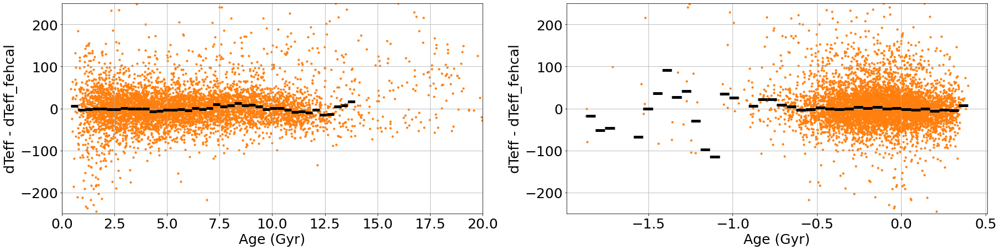

In [329]:
corr_resid = dteff_fehcal-dteffresid_age(k3dr17['IntAge'],*popt_age)

plt.figure(figsize=[30,7])

###
plt.subplot(121)

cut_age = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(k3dr17['IntAge'])==True)&
               (k3dr17['IntAge']<14))
bin_means_age, bin_edges_age, _ = binned_statistic(k3dr17['IntAge'][cut_age],corr_resid[cut_age],statistic='median',bins=40)
bin_centers_age = (bin_edges_age[:-1]+np.diff(bin_edges_age)/2)

plt.scatter(k3dr17['IntAge'],corr_resid,c='tab:orange',s=10)
plt.hlines(bin_means_age, bin_edges_age[:-1], bin_edges_age[1:], colors='k', lw=5.)
plt.xlim(0,20)
plt.ylim(-250,250)
plt.grid()
plt.xlabel(r'Age (Gyr)')
plt.ylabel(r'dTeff - dTeff_fehcal')

###
plt.subplot(122)

cut_feh = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(k3dr17['IntAge'])==True)&
               (k3dr17['IntAge']<14))
bin_means_feh, bin_edges_feh, _ = binned_statistic(kdr17['FE_H'][cut_feh],corr_resid[cut_feh],statistic='median',bins=40)
bin_centers_feh = (bin_edges_feh[:-1]+np.diff(bin_edges_feh)/2)

plt.scatter(kdr17['FE_H'],corr_resid,c='tab:orange',s=10)
plt.hlines(bin_means_feh, bin_edges_feh[:-1], bin_edges_feh[1:], colors='k', lw=5.)
plt.ylim(-250,250)
plt.grid()
plt.xlabel(r'Age (Gyr)')
plt.ylabel(r'dTeff - dTeff_fehcal')

plt.show()

In [333]:
### See IsochroneShiftsCleanedUp

def dteff_feh(x,a,b,feh0,dteff0):
    return np.piecewise(x,[x<feh0],[lambda x: dteff0, 
                                    lambda x: a*(x**2-feh0**2)+b*(x-feh0)+dteff0])
# Fit Parameters:
# a = -110.86459
# b = -11.38174
# feh0 = -0.69217
# dteff0 = -24.20264

def dteffresid_age(x,a,b,c,dteff0_age):
    return np.piecewise(x,[x>13.787],[lambda x: dteff0_age, 
                                    lambda x: a*(x**3-13.787**3)+b*(x**2-13.787**2)+c*(x-13.787)+dteff0_age])

# Fit Parameters:
# a = 0.38488
# b = -8.61162
# c = 56.32289
# dteff0_age = 45.25014

# newTeff = kdr17['TEFF'] - (dteffresid_age(firstage['AGE'],0.38488488,-8.61161965,56.3228872,45.25014462)+
#                            dteff_feh(kdr17['FE_H'],-110.8645924,-11.3817418,-0.69216973,-24.20263959))


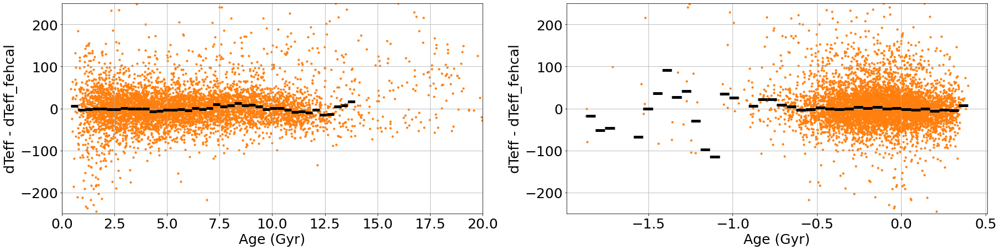

In [332]:
corr_resid = kdteffs-(dteffresid_age(k3dr17['IntAge'],0.38488488,-8.61161965,56.3228872,45.25014462)+
              dteff_feh(kdr17['FE_H'],-110.8645924,-11.3817418,-0.69216973,-24.20263959))

#dteff_fehcal-dteffresid_age(k3dr17['IntAge'],*popt_age)

plt.figure(figsize=[30,7])

###
plt.subplot(121)

cut_age = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(k3dr17['IntAge'])==True)&
               (k3dr17['IntAge']<14))
bin_means_age, bin_edges_age, _ = binned_statistic(k3dr17['IntAge'][cut_age],corr_resid[cut_age],statistic='median',bins=40)
bin_centers_age = (bin_edges_age[:-1]+np.diff(bin_edges_age)/2)

plt.scatter(k3dr17['IntAge'],corr_resid,c='tab:orange',s=10)
plt.hlines(bin_means_age, bin_edges_age[:-1], bin_edges_age[1:], colors='k', lw=5.)
plt.xlim(0,20)
plt.ylim(-250,250)
plt.grid()
plt.xlabel(r'Age (Gyr)')
plt.ylabel(r'dTeff - dTeff_fehcal')

###
plt.subplot(122)

cut_feh = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(k3dr17['IntAge'])==True)&
               (k3dr17['IntAge']<14))
bin_means_feh, bin_edges_feh, _ = binned_statistic(kdr17['FE_H'][cut_feh],corr_resid[cut_feh],statistic='median',bins=40)
bin_centers_feh = (bin_edges_feh[:-1]+np.diff(bin_edges_feh)/2)

plt.scatter(kdr17['FE_H'],corr_resid,c='tab:orange',s=10)
plt.hlines(bin_means_feh, bin_edges_feh[:-1], bin_edges_feh[1:], colors='k', lw=5.)
plt.ylim(-250,250)
plt.grid()
plt.xlabel(r'Age (Gyr)')
plt.ylabel(r'dTeff - dTeff_fehcal')

plt.show()

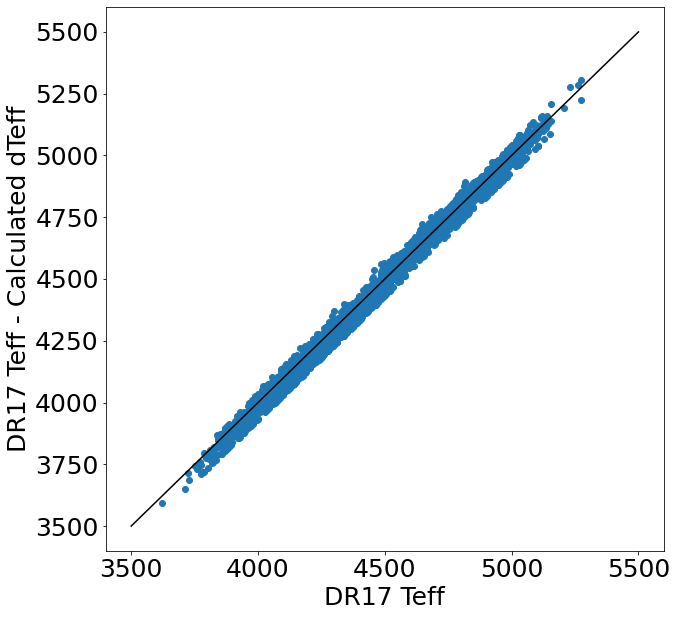

In [189]:
dteff_new = dteffresid_age(k3dr17['IntAge'],*popt_age)+dteff_feh(kdr17['FE_H'],*popt_feh)

plt.figure(figsize=[10,10])
plt.scatter(kdr17['TEFF'],kdr17['TEFF']-dteff_new)
plt.plot([3500,5500],[3500,5500],c='k')
plt.xlabel(r'DR17 Teff')
plt.ylabel(r'DR17 Teff - Calculated dTeff')
plt.show()

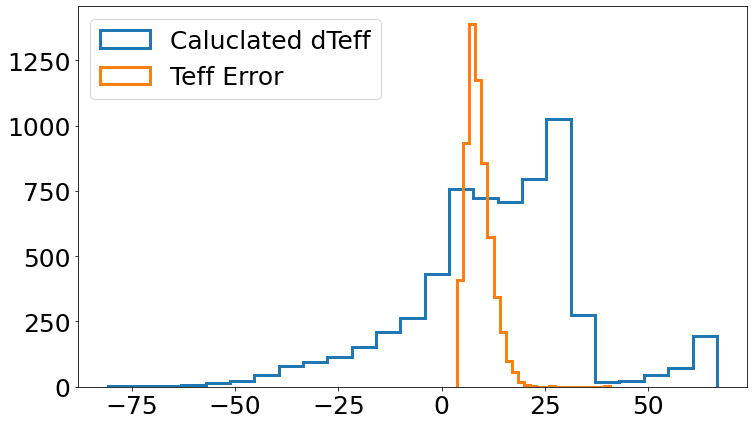

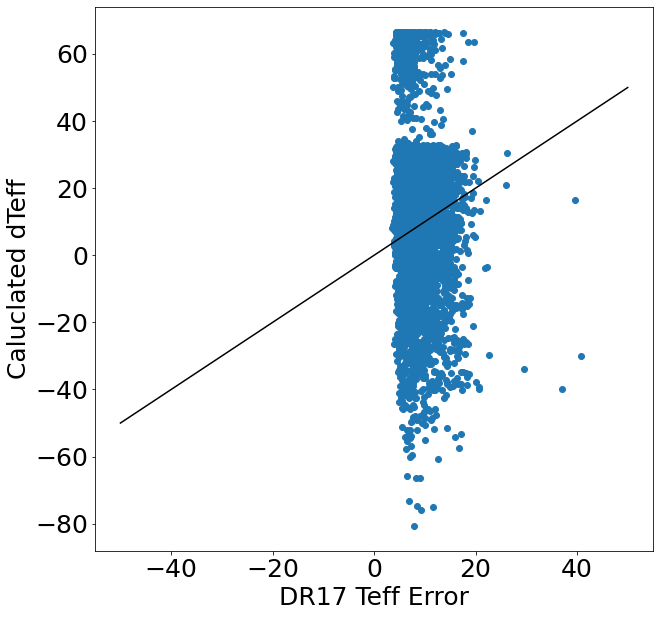

In [188]:
plt.figure(figsize=[12,7])
plt.hist(dteff_new,bins=25,histtype='step',lw=3.0,label='Caluclated dTeff')
plt.hist(kdr17['TEFF_ERR'],bins=25,histtype='step',lw=3.0,label='Teff Error')
plt.legend()
plt.show()

plt.figure(figsize=[10,10])
plt.scatter(kdr17['TEFF_ERR'],dteff_new)
plt.plot([-50,50],[-50,50],c='k')
plt.xlabel(r'DR17 Teff Error')
plt.ylabel(r'Caluclated dTeff')
plt.show()

(array([  3.,   0.,  12.,  38.,  69.,  96., 142., 178., 174., 172., 215.,
        226., 181., 251., 285., 254., 285., 599., 685., 383., 387., 429.,
        388., 352., 280.]),
 array([0.572047  , 0.68454632, 0.79704564, 0.90954496, 1.02204428,
        1.1345436 , 1.24704292, 1.35954224, 1.47204156, 1.58454088,
        1.6970402 , 1.80953952, 1.92203884, 2.03453816, 2.14703748,
        2.2595368 , 2.37203612, 2.48453544, 2.59703476, 2.70953408,
        2.8220334 , 2.93453272, 3.04703204, 3.15953136, 3.27203068,
        3.38453   ]),
 <a list of 25 Patch objects>)

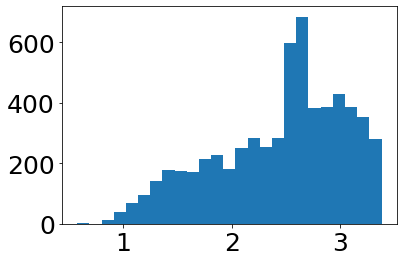

In [187]:
plt.hist(k3dr17['Logg'],bins=25)

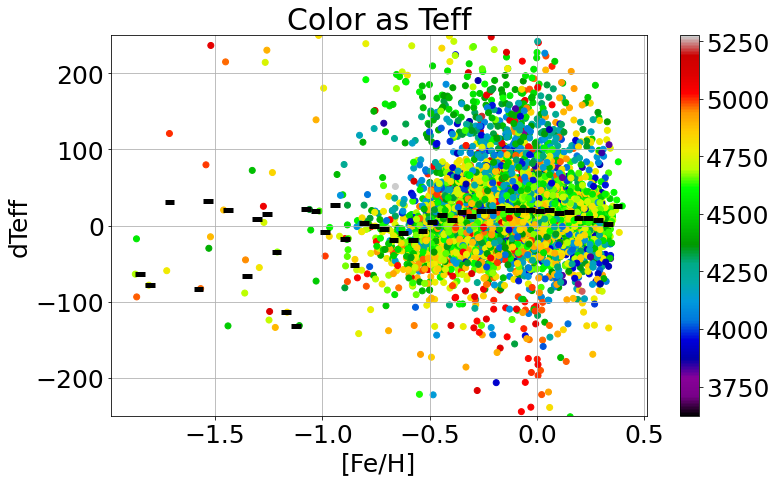

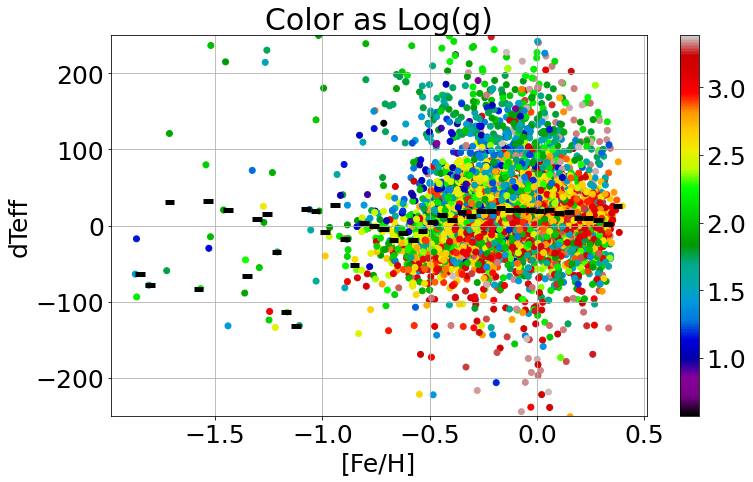

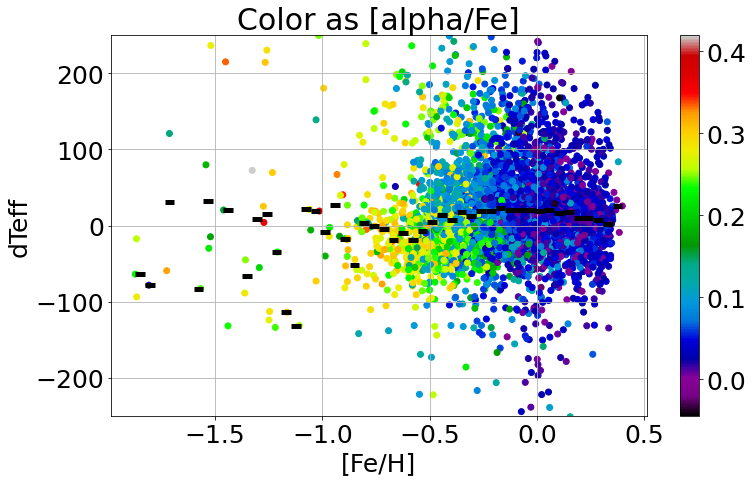

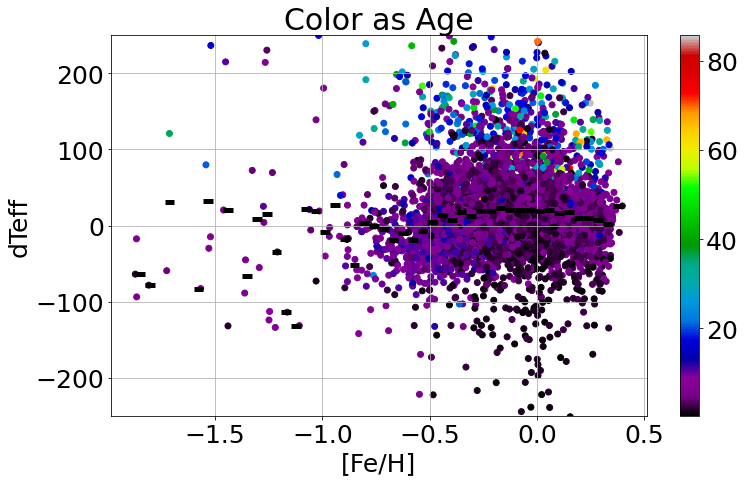

In [192]:
dfull_colors = np.array([kdr17['TEFF'],k3dr17['Logg'],apoafe,k3dr17['IntAge']])
dfull_titles = np.array(['Teff','Log(g)','[alpha/Fe]','Age'])

cut = np.where((np.isfinite(k3dr17['IntAge'])==True)&(np.isfinite(kdteffs)==True))

for i in range(len(dfull_colors)):
    
    bin_means, bin_edges, _ = binned_statistic(kdr17['FE_H'][cut],kdteffs[cut],statistic='median',bins=50)

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['FE_H'],kdteffs,c=dfull_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    
    plt.hlines(bin_means, bin_edges[:-1], bin_edges[1:], colors='k', lw=5.)
    
    plt.ylim(-250,250)

    plt.title(r'Color as {}'.format(dfull_titles[i]))
    plt.xlabel(r'[Fe/H]')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

## Iron dLog(g) From Teff-log(g)

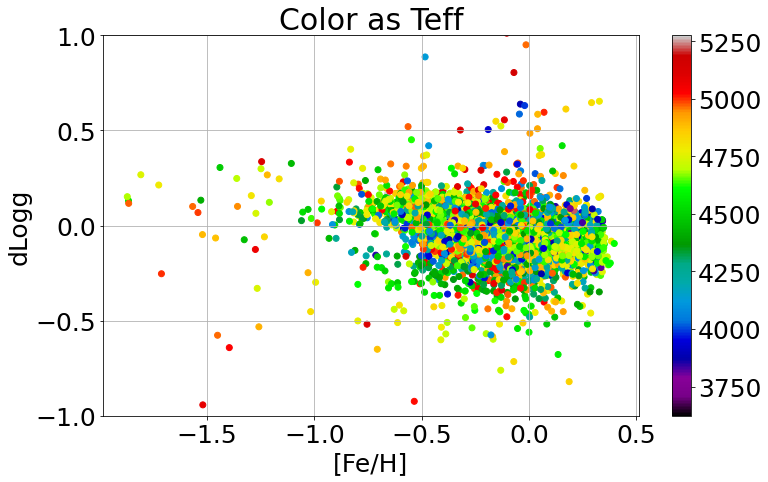

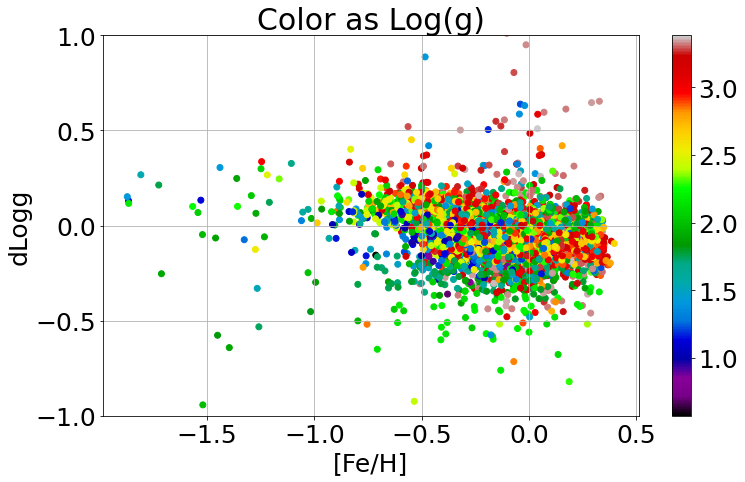

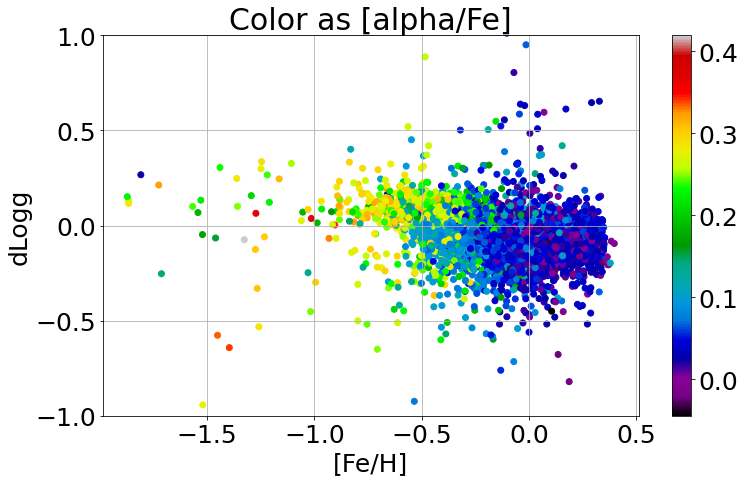

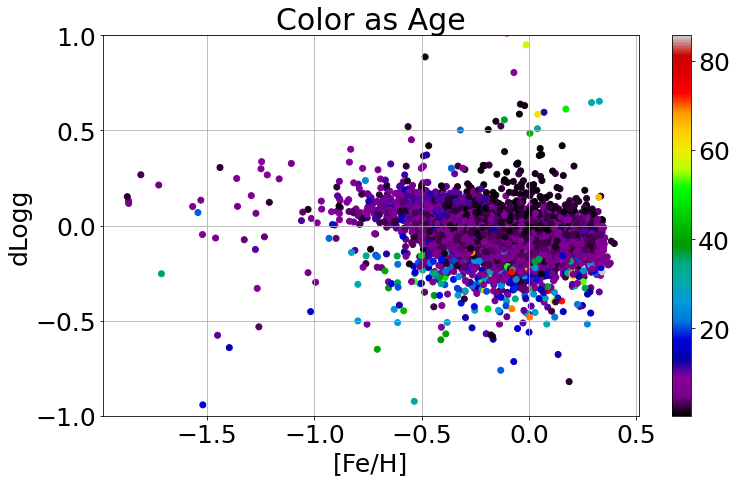

In [193]:
dfull_colors = np.array([kdr17['TEFF'],k3dr17['Logg'],apoafe,k3dr17['IntAge']])
dfull_titles = np.array(['Teff','Log(g)','[alpha/Fe]','Age'])

for i in range(len(dfull_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['FE_H'],kdloggs,c=dfull_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-1.0,1.0)

    plt.title(r'Color as {}'.format(dfull_titles[i]))
    plt.xlabel(r'[Fe/H]')
    plt.ylabel(r'dLogg')
    plt.grid()
    plt.show()

## Teff dTeff From Teff-log(g)

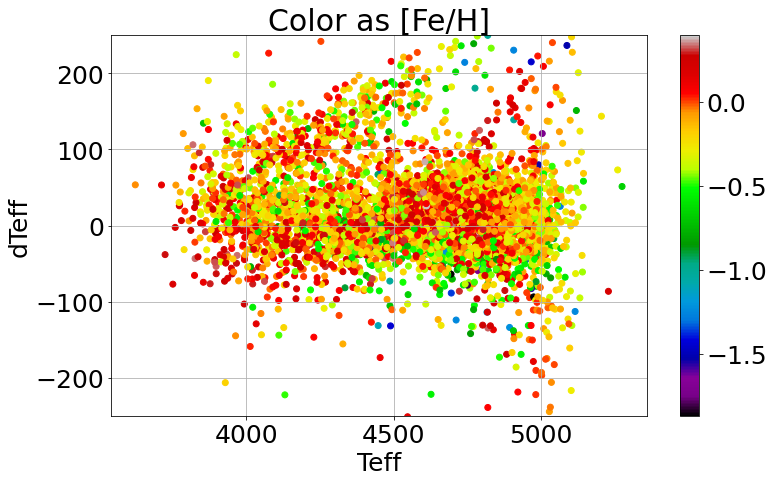

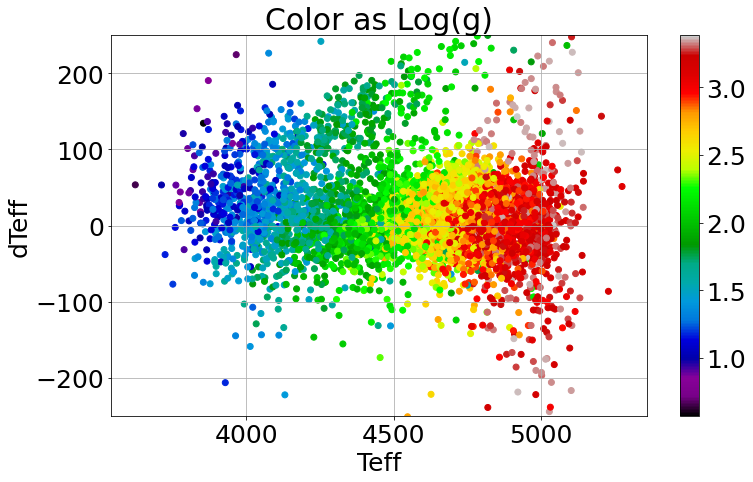

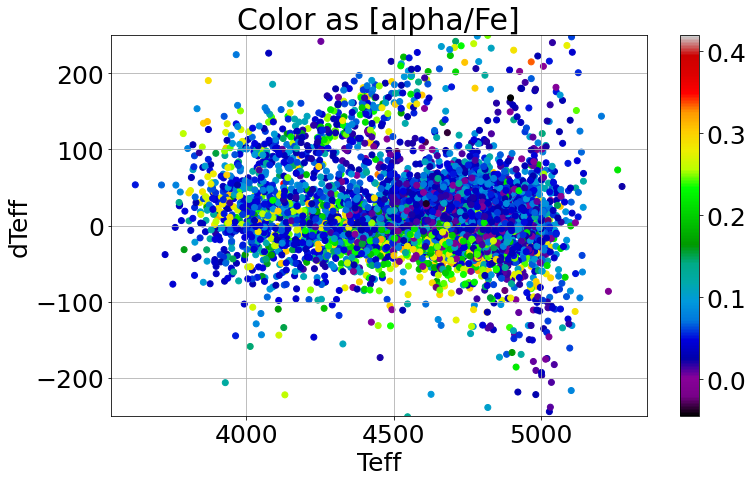

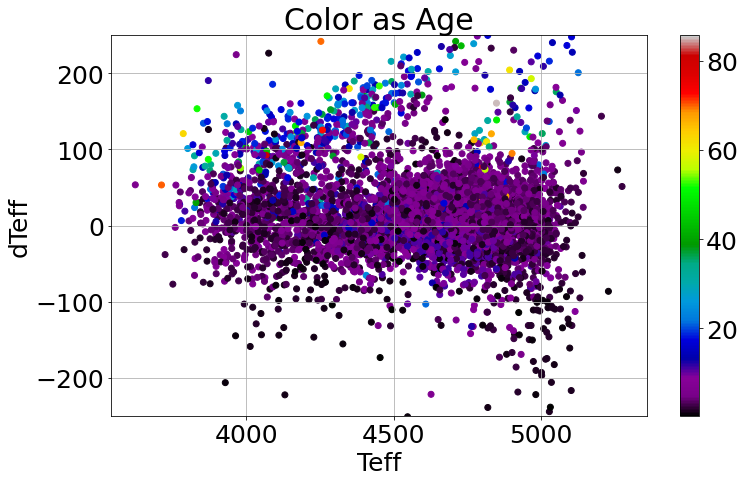

In [194]:
dfull_colors = np.array([kdr17['FE_H'],k3dr17['Logg'],apoafe,k3dr17['IntAge']])
dfull_titles = np.array(['[Fe/H]','Log(g)','[alpha/Fe]','Age'])

for i in range(len(dfull_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['TEFF'],kdteffs,c=dfull_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-250,250)

    plt.title(r'Color as {}'.format(dfull_titles[i]))
    plt.xlabel(r'Teff')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

## Teff dLog(g) From Teff-log(g)

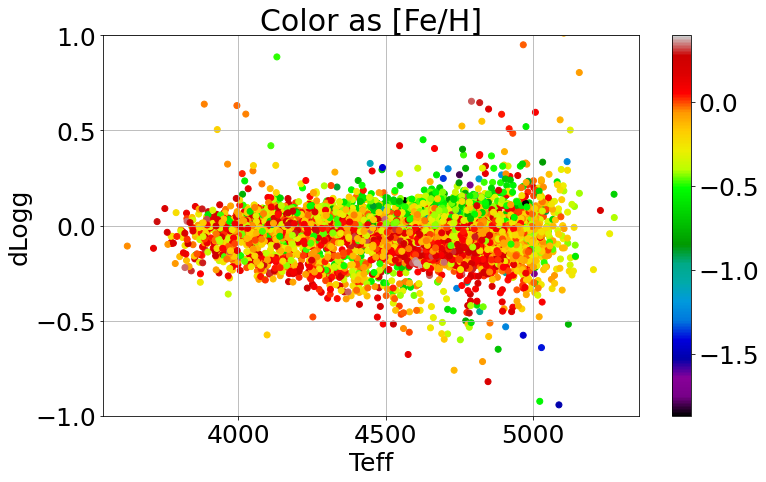

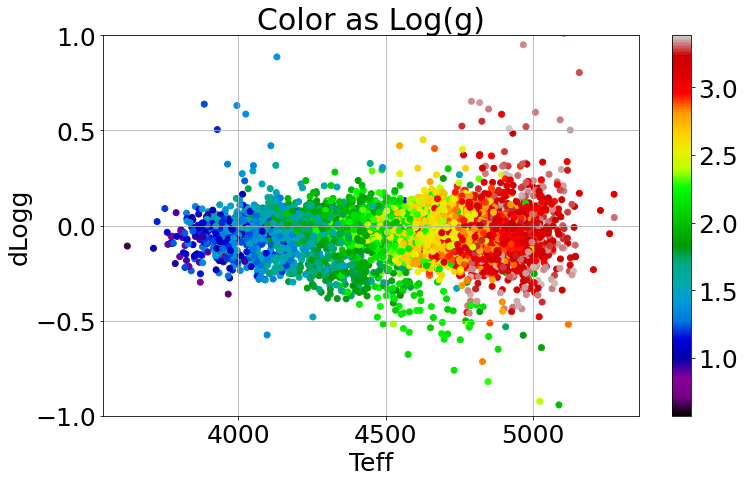

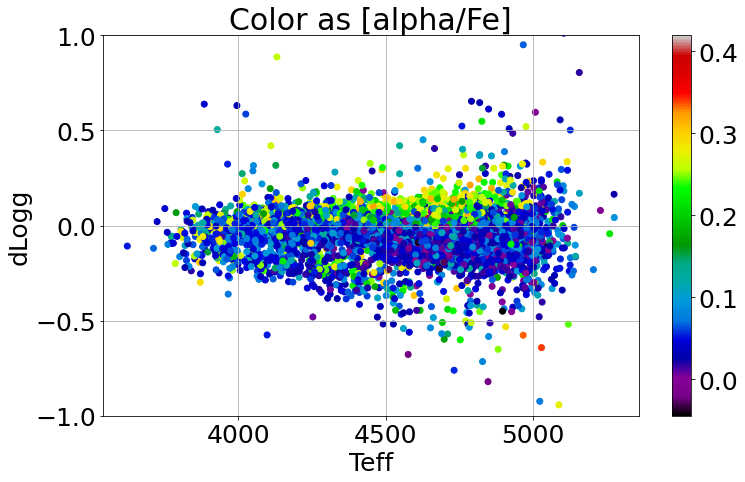

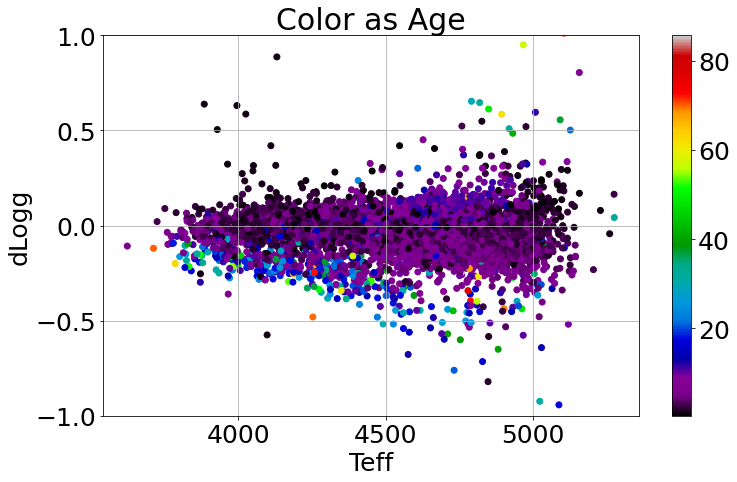

In [195]:
dfull_colors = np.array([kdr17['FE_H'],k3dr17['Logg'],apoafe,k3dr17['IntAge']])
dfull_titles = np.array(['[Fe/H]','Log(g)','[alpha/Fe]','Age'])

for i in range(len(dfull_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['TEFF'],kdloggs,c=dfull_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-1.0,1.0)

    plt.title(r'Color as {}'.format(dfull_titles[i]))
    plt.xlabel(r'Teff')
    plt.ylabel(r'dLogg')
    plt.grid()
    plt.show()

## Log(g) dTeff From Teff-log(g)

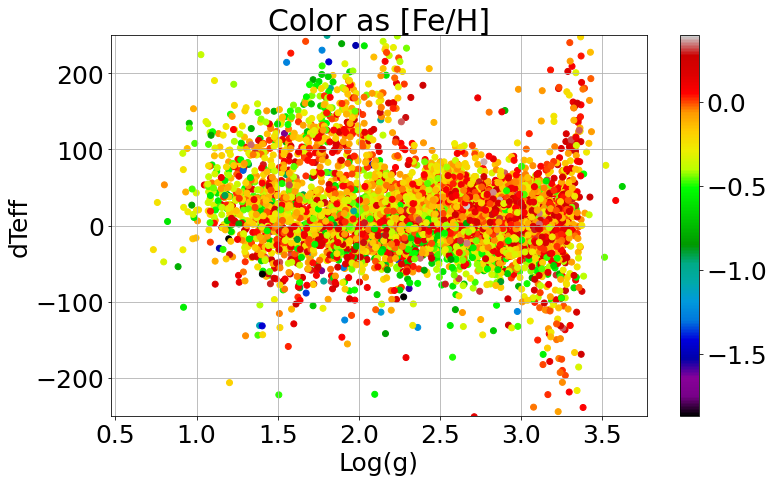

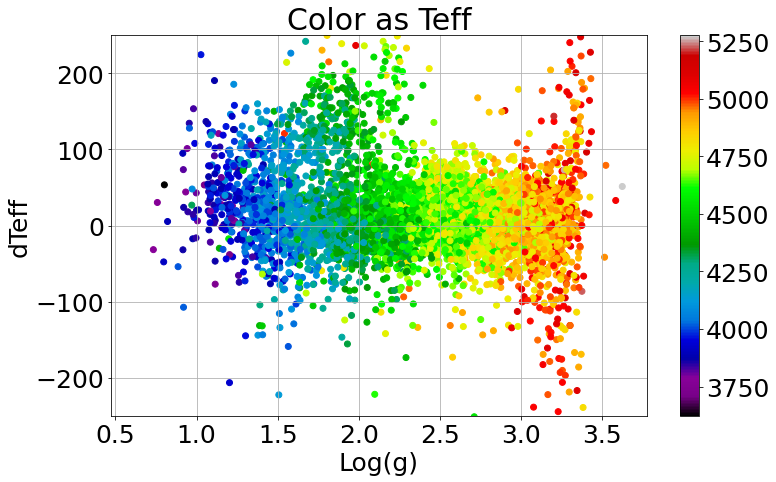

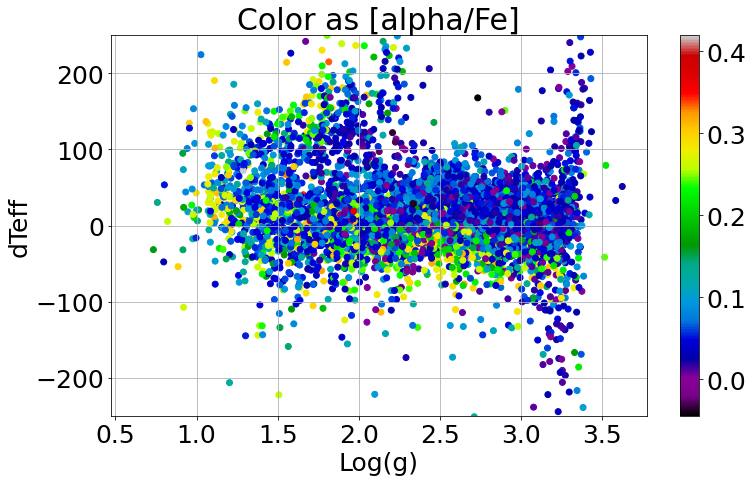

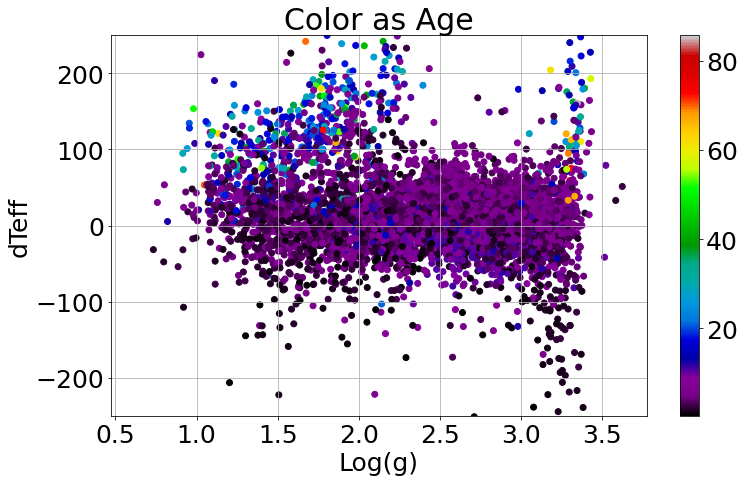

In [196]:
dfull_colors = np.array([kdr17['FE_H'],kdr17['TEFF'],apoafe,k3dr17['IntAge']])
dfull_titles = np.array(['[Fe/H]','Teff','[alpha/Fe]','Age'])

for i in range(len(dfull_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['LOGG'],kdteffs,c=dfull_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-250,250)

    plt.title(r'Color as {}'.format(dfull_titles[i]))
    plt.xlabel(r'Log(g)')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

## Log(g) dLog(g) From Teff-log(g)

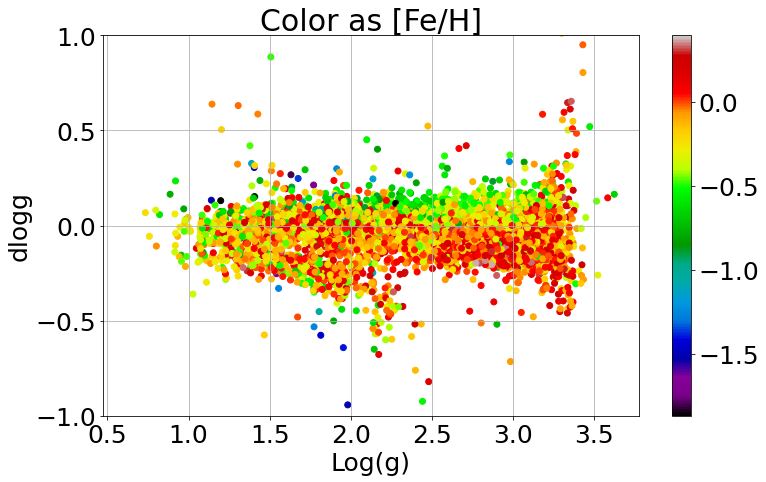

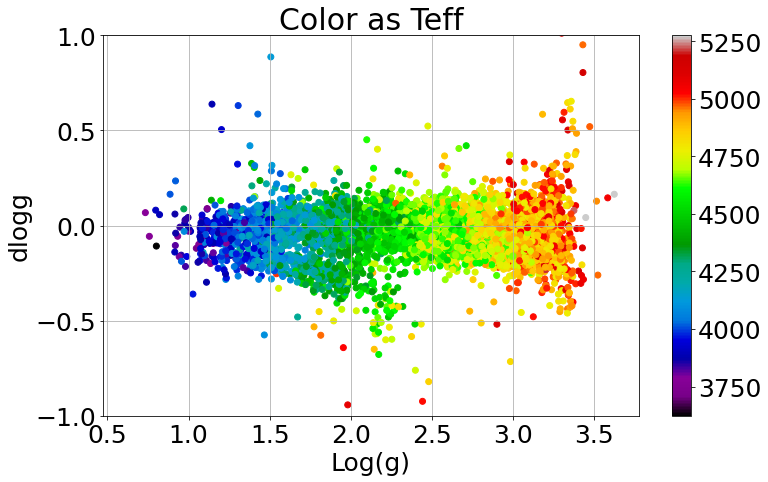

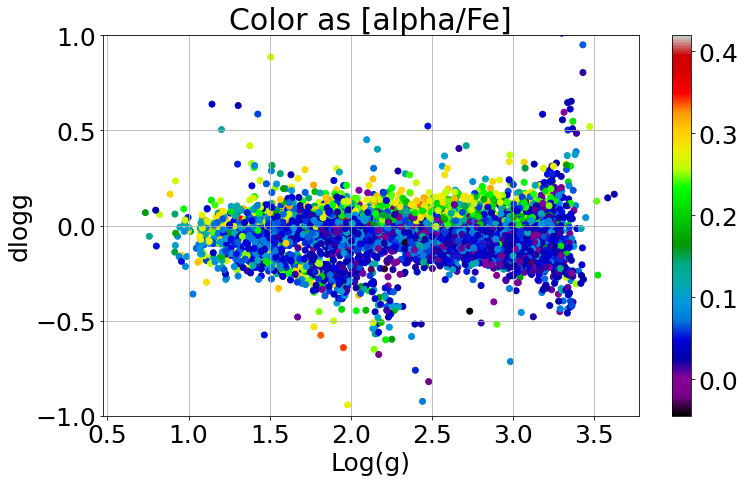

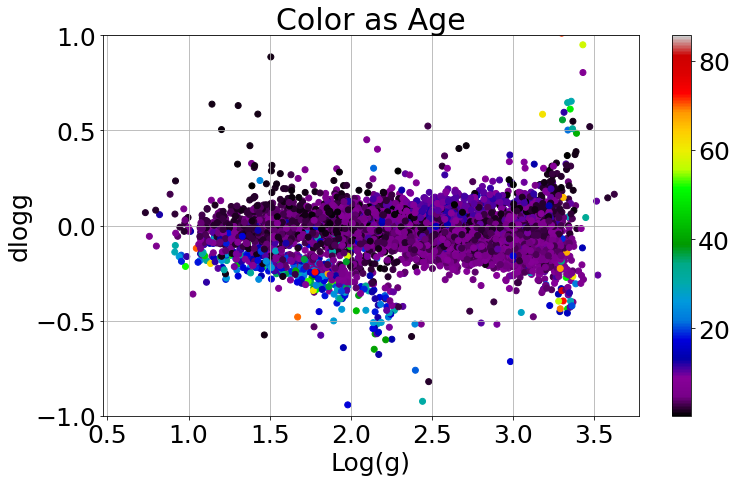

In [197]:
dfull_colors = np.array([kdr17['FE_H'],kdr17['TEFF'],apoafe,k3dr17['IntAge']])
dfull_titles = np.array(['[Fe/H]','Teff','[alpha/Fe]','Age'])

for i in range(len(dfull_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['LOGG'],kdloggs,c=dfull_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-1.0,1.0)

    plt.title(r'Color as {}'.format(dfull_titles[i]))
    plt.xlabel(r'Log(g)')
    plt.ylabel(r'dlogg')
    plt.grid()
    plt.show()

## [alpha/Fe] dTeff From Teff-log(g)

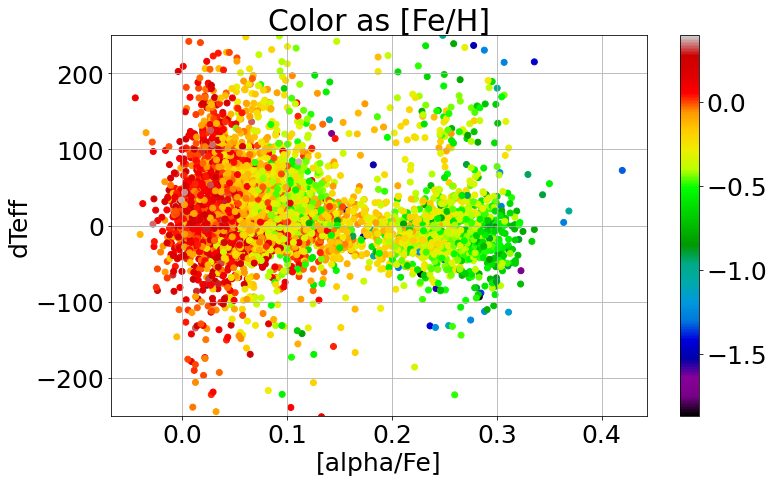

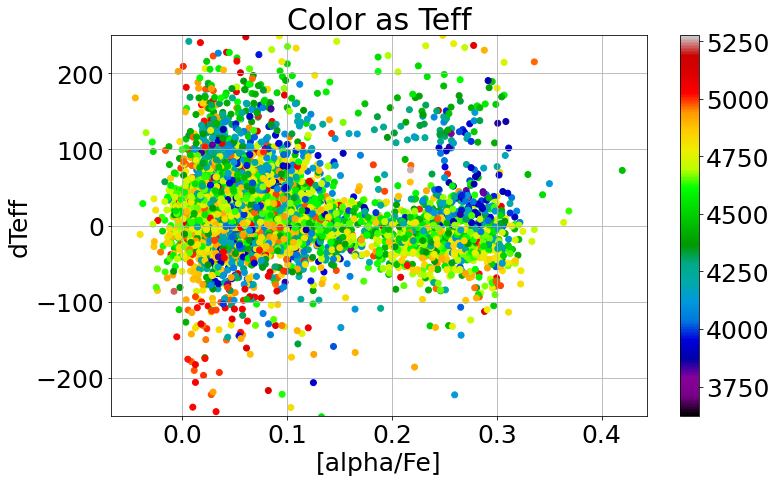

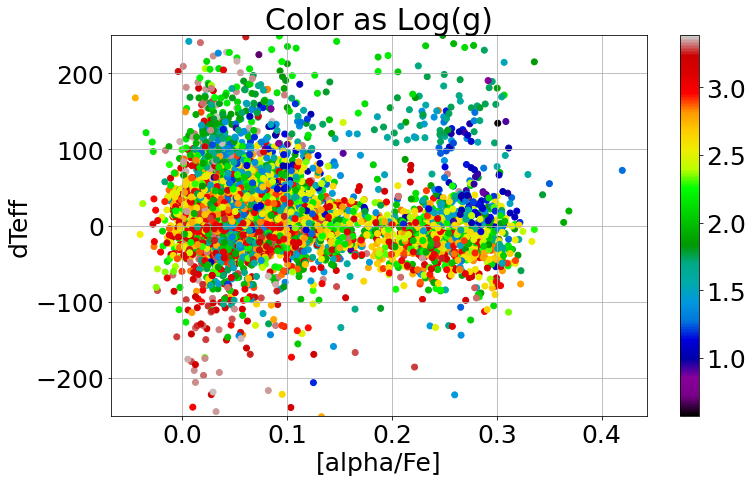

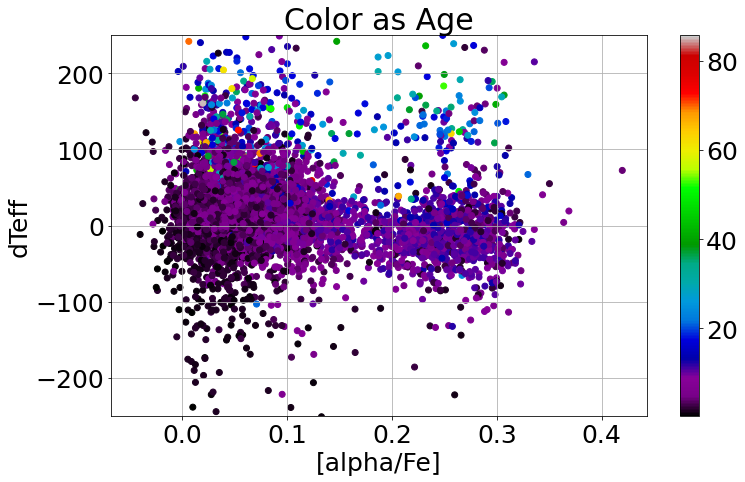

In [198]:
dfull_colors = np.array([kdr17['FE_H'],kdr17['TEFF'],k3dr17['Logg'],k3dr17['IntAge']])
dfull_titles = np.array(['[Fe/H]','Teff','Log(g)','Age'])

for i in range(len(dfull_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(apoafe,kdteffs,c=dfull_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-250,250)

    plt.title(r'Color as {}'.format(dfull_titles[i]))
    plt.xlabel(r'[alpha/Fe]')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

## [alpha/Fe] dLog(g) From Teff-log(g)

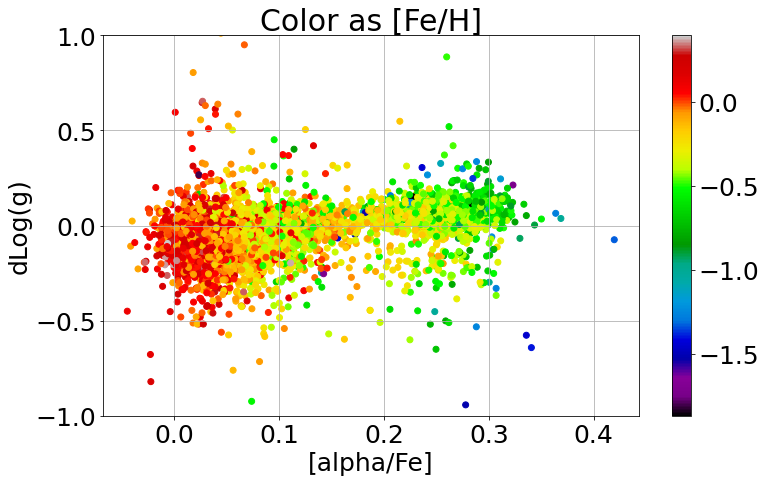

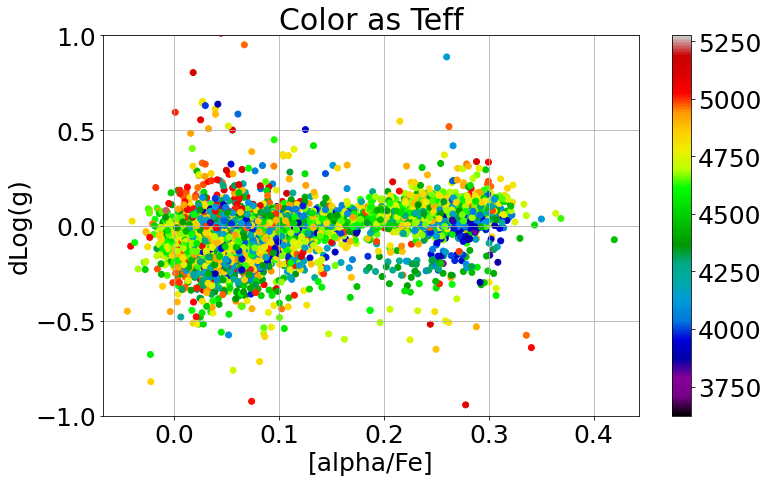

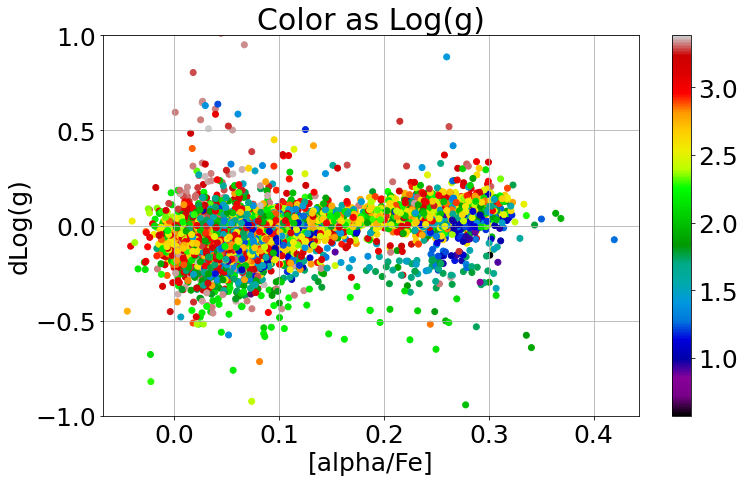

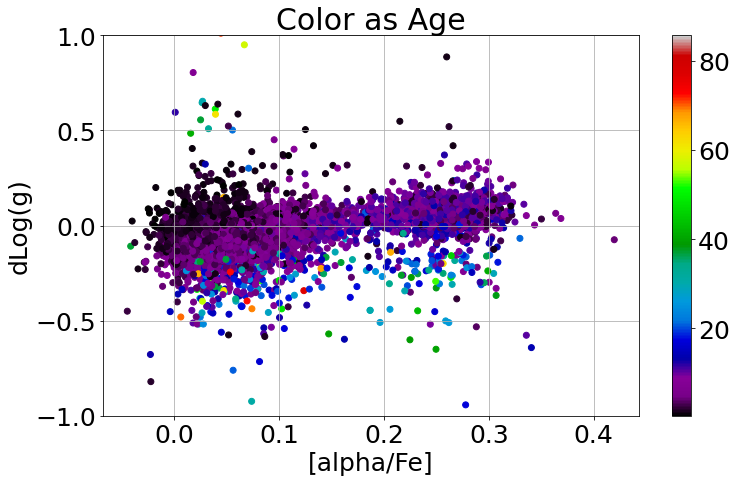

In [199]:
dfull_colors = np.array([kdr17['FE_H'],kdr17['TEFF'],k3dr17['Logg'],k3dr17['IntAge']])
dfull_titles = np.array(['[Fe/H]','Teff','Log(g)','Age'])

for i in range(len(dfull_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(apoafe,kdloggs,c=dfull_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-1.0,1.0)

    plt.title(r'Color as {}'.format(dfull_titles[i]))
    plt.xlabel(r'[alpha/Fe]')
    plt.ylabel(r'dLog(g)')
    plt.grid()
    plt.show()

## Age dTeff From Teff-log(g)

(-0.25, 0.25)

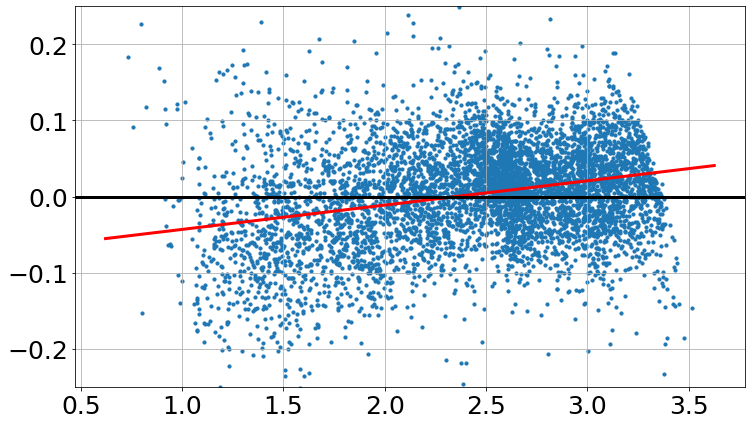

In [200]:
cut = np.where((np.isfinite(kdr17['LOGG'])==True)&(np.isfinite(k3dr17['Logg'])==True))

lggresid = np.poly1d(robust.polyfit(kdr17['LOGG'][cut],(k3dr17['Logg']-kdr17['LOGG'])[cut],1))
xs = np.linspace(min(kdr17['LOGG']),max(kdr17['LOGG']))

plt.figure(figsize=[12,7])
plt.scatter(kdr17['LOGG'],k3dr17['Logg']-kdr17['LOGG'],s=10)
plt.plot(xs,lggresid(xs),c='r',lw=3.0)
plt.axhline(0.0,lw=3.0,c='k')
plt.grid()
plt.ylim(-0.25,0.25)

In [201]:
logg_coef = [0.26630348932831838,    -0.063076373905130864]

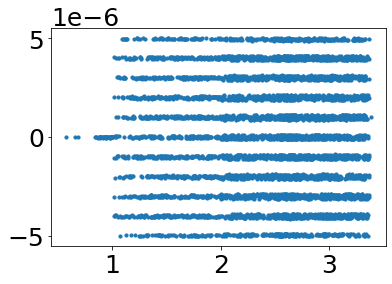

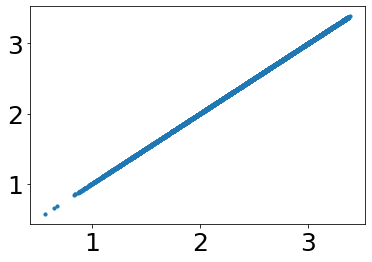

In [202]:
k672dr17['APOKASC3P_LOGG']

plt.scatter(k3dr17['Logg'],k672dr17['APOKASC3P_LOGG']-k3dr17['Logg'],s=10)
plt.show()

plt.scatter(k3dr17['Logg'],k672dr17['APOKASC3P_LOGG'],s=10)
plt.show()

In [204]:
# cut = np.where((np.isfinite(kdr17['FPARAM'][:,1])==True)&(np.isfinite(k3dr17['Logg'])==True))

# lggresid = np.poly1d(robust.polyfit(kdr17['FPARAM'][:,1][cut],(k3dr17['Logg']-kdr17['FPARAM'][:,1])[cut],1))
# xs = np.linspace(min(kdr17['FPARAM'][:,1]),max(kdr17['FPARAM'][:,1]))

# plt.figure(figsize=[12,7])
# plt.scatter(kdr17['FPARAM'][:,1],k3dr17['Logg']-kdr17['FPARAM'][:,1],s=10)
# plt.plot(xs,lggresid(xs),c='r',lw=3.0)
# plt.axhline(0.0,lw=3.0,c='k')
# plt.grid()
# plt.ylim(-0.25,0.25)

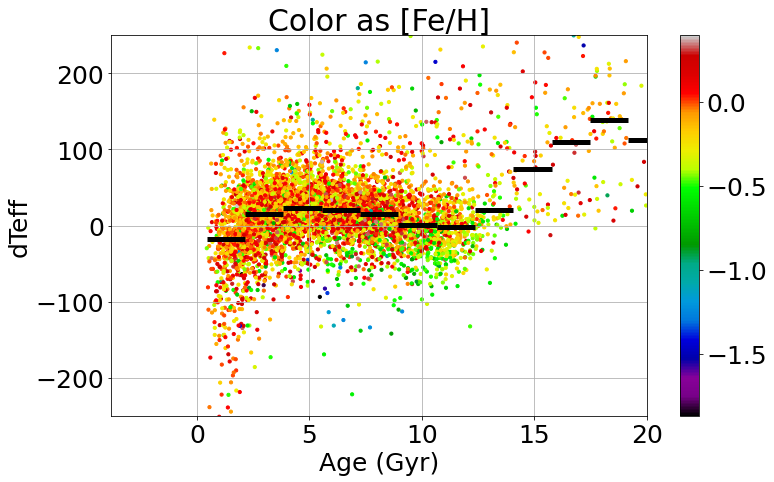

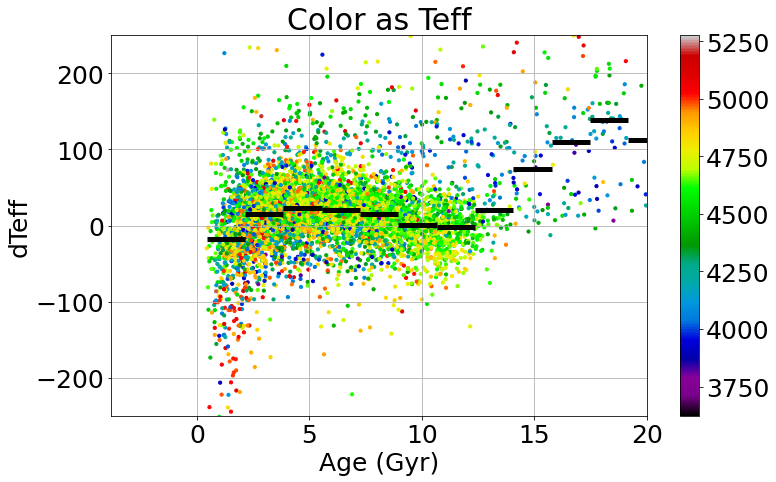

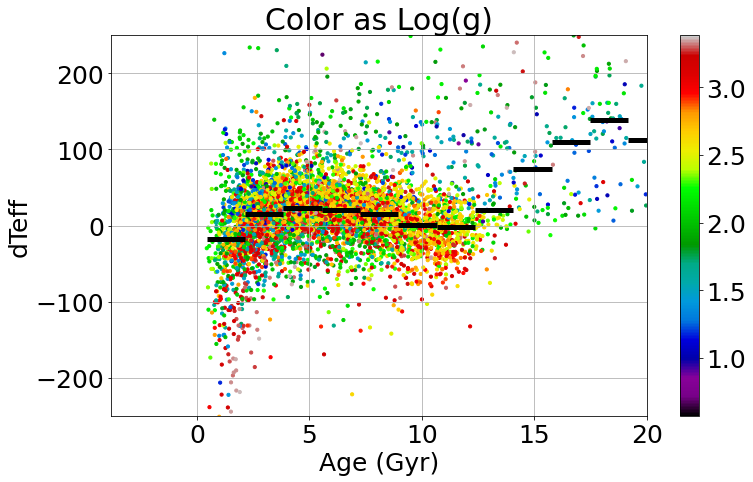

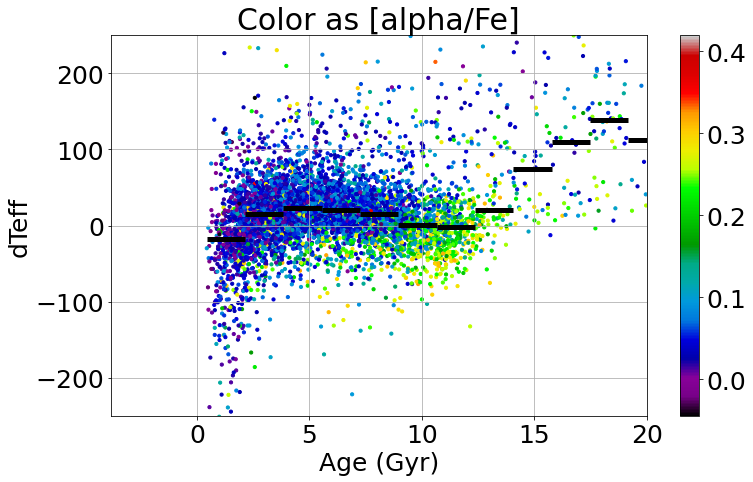

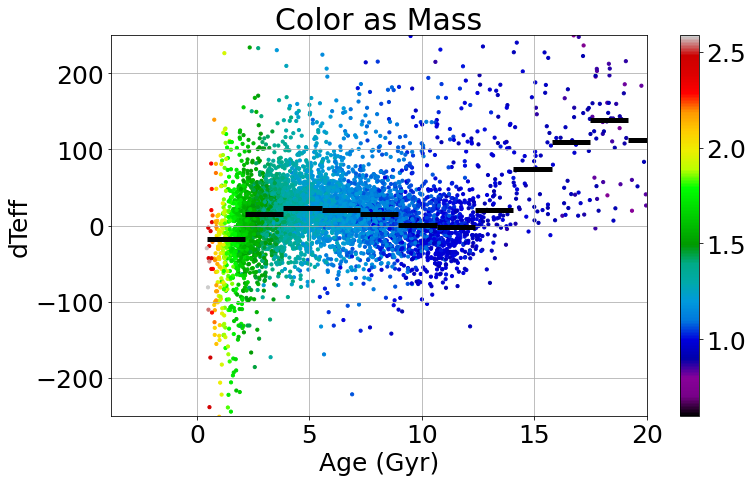

In [334]:
dfull_colors = np.array([kdr17['FE_H'],kdr17['TEFF'],k3dr17['Logg'],apoafe,k3dr17['Mass']])
dfull_titles = np.array(['[Fe/H]','Teff','Log(g)','[alpha/Fe]','Mass'])

cut = np.where((np.isfinite(k3dr17['IntAge'])==True)&(np.isfinite(kdteffs)==True))

for i in range(len(dfull_colors)):
    
    bin_means, bin_edges, _ = binned_statistic(k3dr17['IntAge'][cut],kdteffs[cut],statistic='median',bins=50)
    

    plt.figure(figsize=[12,7])
    plt.scatter(k3dr17['IntAge'],kdteffs,c=dfull_colors[i],cmap='nipy_spectral',s=10)
    plt.colorbar()
    
    plt.hlines(bin_means, bin_edges[:-1], bin_edges[1:], colors='k', lw=5.)
    
    plt.ylim(-250,250)

    plt.title(r'Color as {}'.format(dfull_titles[i]))
    plt.xlim(right=20)
    plt.xlabel(r'Age (Gyr)')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

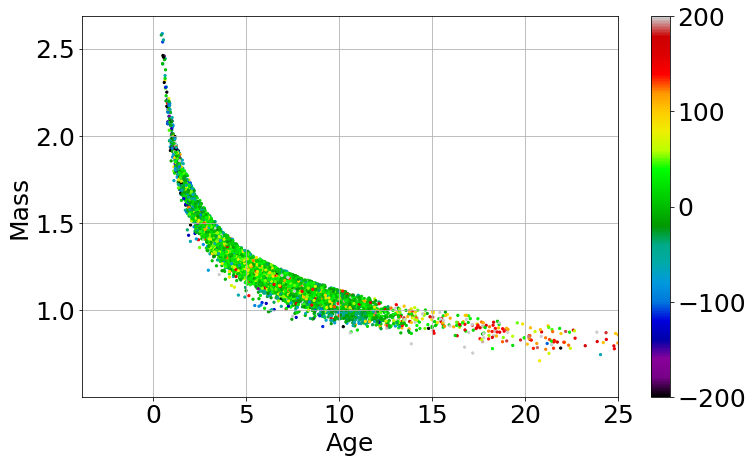

In [346]:
plt.figure(figsize=[12,7])
plt.scatter(k3dr17['IntAge'],k3dr17['Mass'],c=kdteffs,s=5,vmin=-200,vmax=200,cmap='nipy_spectral')
plt.colorbar()
plt.xlim(right=25)
plt.xlabel(r'Age')
plt.ylabel(r'Mass')
plt.grid()

Text(0, 0.5, 'Log(g)')

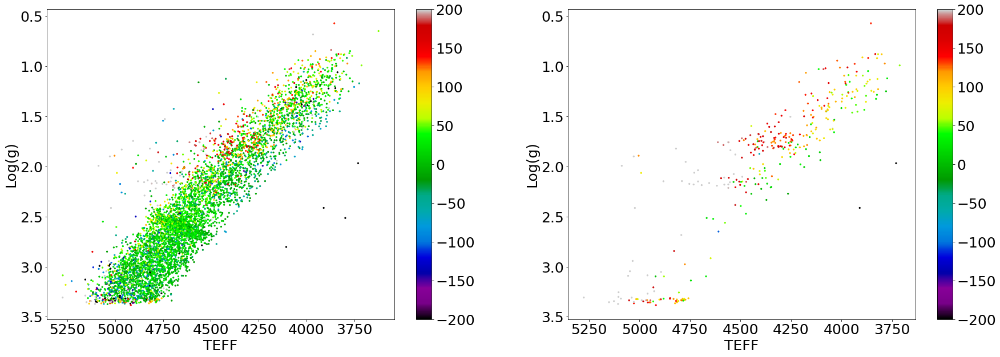

In [350]:
plt.figure(figsize=[30,10])

plt.subplot(121)
plt.scatter(kdr17['TEFF'],k3dr17['Logg'],c=kdteffs,s=5,vmin=-200,vmax=200,cmap='nipy_spectral')

plt.colorbar()

plt.gca().invert_xaxis()
plt.gca().invert_yaxis()

plt.xlabel(r'TEFF')
plt.ylabel(r'Log(g)')

plt.subplot(122)
wonky = np.where((k3dr17['IntAge']>=13.787)&(k3dr17['Mass']<1.0))

plt.scatter(kdr17['TEFF'][wonky],k3dr17['Logg'][wonky],c=kdteffs[wonky],s=5,vmin=-200,vmax=200,
            cmap='nipy_spectral')

plt.colorbar()

plt.gca().invert_xaxis()
plt.gca().invert_yaxis()

plt.xlabel(r'TEFF')
plt.ylabel(r'Log(g)')

## Age dLog(g) From Teff-log(g)

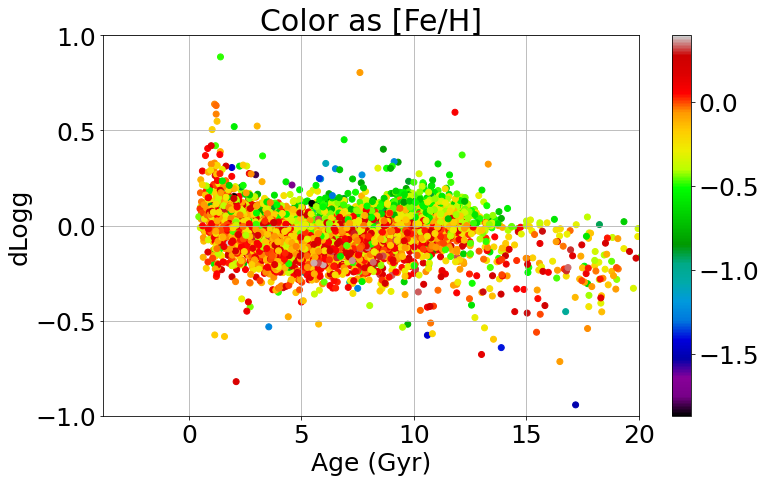

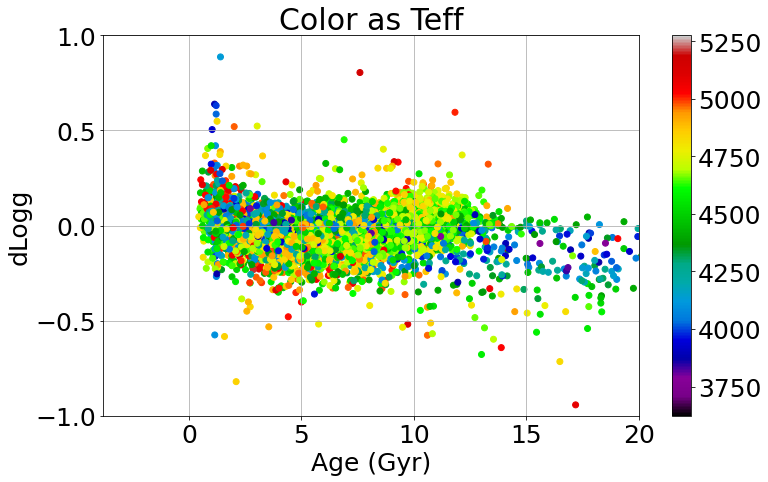

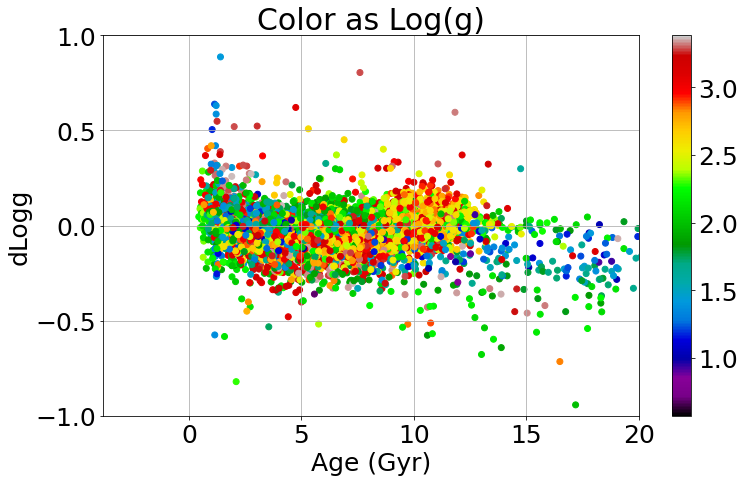

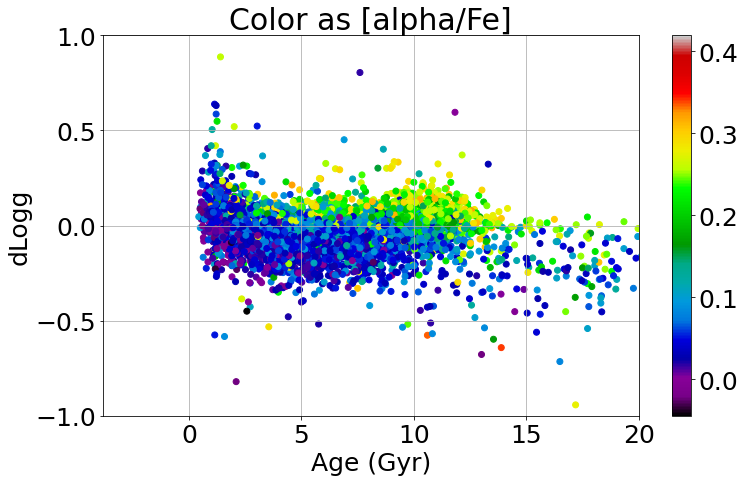

In [206]:
dfull_colors = np.array([kdr17['FE_H'],kdr17['TEFF'],k3dr17['Logg'],apoafe])
dfull_titles = np.array(['[Fe/H]','Teff','Log(g)','[alpha/Fe]'])

for i in range(len(dfull_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(k3dr17['IntAge'],kdloggs,c=dfull_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-1.0,1.0)

    plt.title(r'Color as {}'.format(dfull_titles[i]))
    plt.xlim(right=20)
    plt.xlabel(r'Age (Gyr)')
    plt.ylabel(r'dLogg')
    plt.grid()
    plt.show()

In [207]:
fincut = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(k3dr17['IntAge'])==True)&
                  (np.isfinite(apoafe)==True)&(np.isfinite(kdr17['LOGG'])==True)&
                  (np.isfinite(kdteffs)==True)&(k3dr17['IntAge']<20.)&(kdr17['FE_H']>-1.0)&
                  (kdteffs>-250)&(kdteffs<250))


### [Fe/H] age ###
print('Model: [Fe/H], Age')
pmodl = np.array([kdr17['FE_H'][fincut],k3dr17['IntAge'][fincut]]).T
pmodl = sm.add_constant(pmodl)
model = sm.RLM(kdteffs[fincut],pmodl).fit()
# print(model.summary())
predictions = model.predict(pmodl)
residual = predictions - kdteffs[fincut]
print('Params:',np.asarray(model.params))
print('Max Resid:',np.max(np.absolute(residual)))
print('Mad of Resid:',mad(residual))
print(r'-----')

print('Model: [Fe/H], [Fe/H]**2, age')
pmodl = np.array([kdr17['FE_H'][fincut],(kdr17['FE_H'][fincut])**2,k3dr17['IntAge'][fincut]]).T
pmodl = sm.add_constant(pmodl)
model = sm.RLM(kdteffs[fincut],pmodl).fit()
# print(model.summary())
predictions = model.predict(pmodl)
residual = predictions - kdteffs[fincut]
print('Params:',np.asarray(model.params))
print('Max Resid:',np.max(np.absolute(residual)))
print('Mad of Resid:',mad(residual))
print(r'-----')

print('Model: [Fe/H], [Fe/H]**2, [Fe/H]**3, age')
pmodl = np.array([kdr17['FE_H'][fincut],(kdr17['FE_H'][fincut])**2,(kdr17['FE_H'][fincut])**3,
                  k3dr17['IntAge'][fincut]]).T
pmodl = sm.add_constant(pmodl)
model = sm.RLM(kdteffs[fincut],pmodl).fit()
# print(model.summary())
predictions = model.predict(pmodl)
residual = predictions - kdteffs[fincut]
print('Params:',np.asarray(model.params))
print('Max Resid:',np.max(np.absolute(residual)))
print('Mad of Resid:',mad(residual))
print(r'-----')

Model: [Fe/H], Age
Params: [ 6.77890437 14.00328218  1.34248313]
Max Resid: 252.30255417988369
Mad of Resid: 24.203484654188273
-----
Model: [Fe/H], [Fe/H]**2, age
Params: [   8.12468849  -19.85900026 -107.90727765    1.69234745]
Max Resid: 256.076992280395
Mad of Resid: 24.000371787311032
-----
Model: [Fe/H], [Fe/H]**2, [Fe/H]**3, age
Params: [   9.58655109  -17.02686066 -164.05168864  -89.43655923    1.75652546]
Max Resid: 257.16168168583647
Mad of Resid: 24.071240909720018
-----


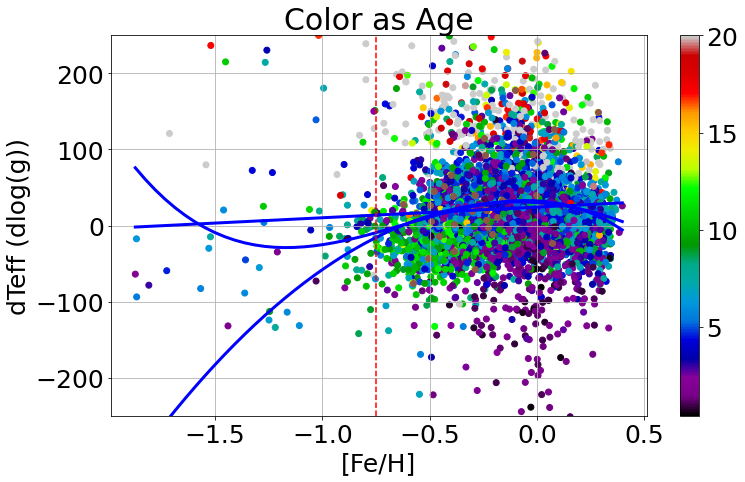

In [208]:
def fehage(feh,age):
    return 6.77890437 +  14.00328218*feh + 1.34248313*age

def fehsqage(feh,age):
    return 8.12468849 +  -19.85900026*feh -107.90727765*feh**2 + 1.69234745*age

def fehcuage(feh,age):
    return 9.58655109 + -17.02686066*feh -164.05168864*feh**2 -89.43655923*feh**3 + 1.75652546*age

consage = 13
agecut = np.where((k3dr17['IntAge']<consage+0.25)&(k3dr17['IntAge']>consage-0.25))

plt.figure(figsize=[12,7])
plt.scatter(kdr17['FE_H'],kdteffs,c=k3dr17['IntAge'],cmap='nipy_spectral',vmax=20)
plt.colorbar()
plt.scatter(kdr17['FE_H'][agecut],kdteffs[agecut],c='tab:brown')

xs = np.linspace(min(kdr17['FE_H']),max(kdr17['FE_H']))

plt.plot(xs,fehage(xs,consage),lw=3.,c='b',label='10 Gyr Line')
plt.plot(xs,fehsqage(xs,consage),lw=3.,c='b',label='10 Gyr Quad')
plt.plot(xs,fehcuage(xs,consage),lw=3.,c='b',label='10 Gyr Quad')

plt.axvline(-0.75,c='r',ls='--')

plt.ylim(-250,250)

plt.title(r'Color as Age')
plt.xlabel(r'[Fe/H]')
plt.ylabel(r'dTeff (dlog(g))')
plt.grid()
plt.show()

# dTeff Log(g) Mass

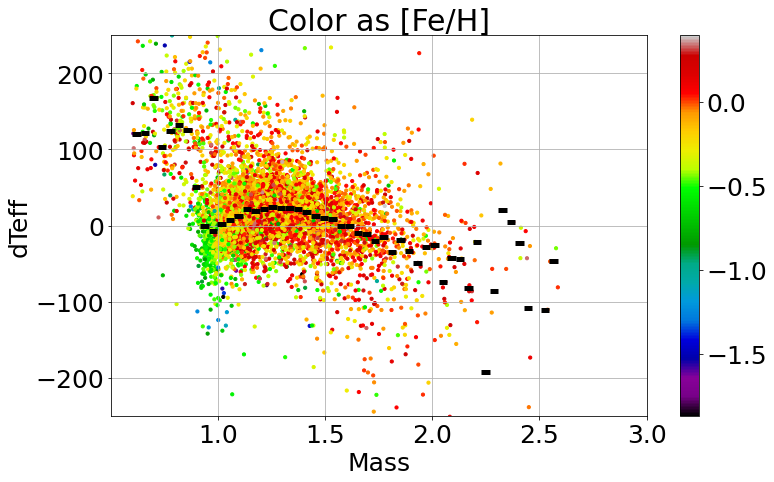

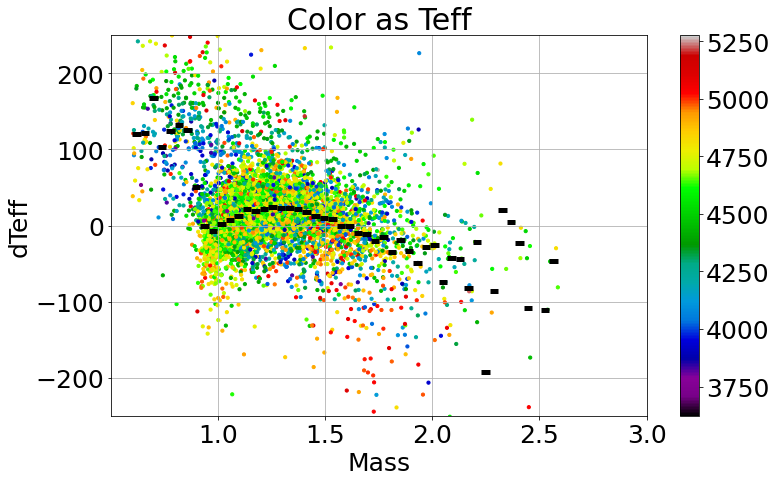

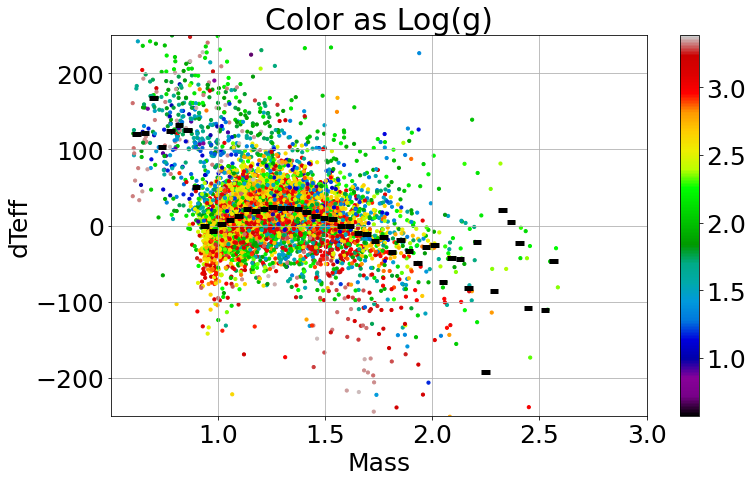

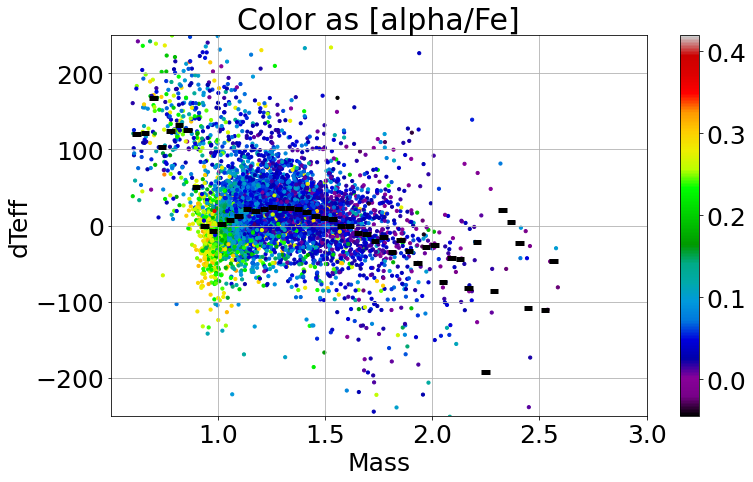

In [264]:
dfull_colors = np.array([kdr17['FE_H'],kdr17['TEFF'],k3dr17['Logg'],apoafe])
dfull_titles = np.array(['[Fe/H]','Teff','Log(g)','[alpha/Fe]'])

cut = np.where((np.isfinite(k3dr17['Mass'])==True)&(np.isfinite(kdteffs)==True))

for i in range(len(dfull_colors)):
    
    bin_means, bin_edges, _ = binned_statistic(k3dr17['Mass'][cut],kdteffs[cut],statistic='median',bins=50)
    

    plt.figure(figsize=[12,7])
    plt.scatter(k3dr17['Mass'],kdteffs,c=dfull_colors[i],cmap='nipy_spectral',s=10)
    plt.colorbar()
    
    plt.hlines(bin_means, bin_edges[:-1], bin_edges[1:], colors='k', lw=5.)
    
    plt.ylim(-250,250)

    plt.title(r'Color as {}'.format(dfull_titles[i]))
    plt.xlim(right=3.)
    plt.xlabel(r'Mass')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

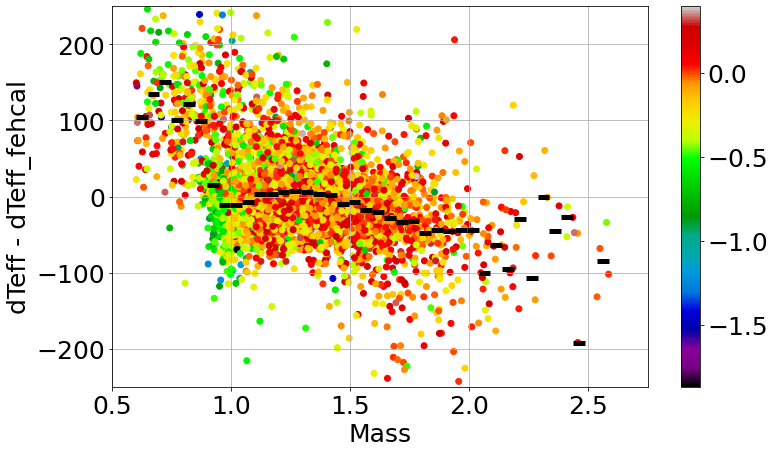

[0.62495482 0.67459647 0.72423812 0.77387977 0.82352142 0.87316307
 0.92280472 0.97244637 1.02208802 1.07172967 1.12137132 1.17101298
 1.22065462 1.27029627 1.31993793 1.36957957 1.41922122 1.46886287
 1.51850452 1.56814617 1.61778782 1.66742947 1.71707112 1.76671277
 1.81635442 1.86599607 1.91563772 1.96527937 2.01492102 2.06456267
 2.11420432 2.16384598 2.21348762 2.26312927 2.31277092 2.36241257
 2.41205422 2.46169587 2.56097917]
[ 104.23080207  134.66154599  150.9698194   100.99233797  121.39746323
   99.17767161   15.7207332   -10.7885727   -10.69138725   -6.76041729
    3.3145724     3.79992059    5.68685309    7.86740957    6.32570607
    2.86078264    1.95912703  -10.37312826   -7.39218075  -17.92169574
  -19.7282633   -28.8136405   -33.05368488  -31.74166498  -48.21845656
  -44.45646111  -44.70936562  -44.41950072  -44.42268446 -100.14052504
  -63.37303892  -95.79796797  -29.48717453 -106.64394968   -1.067041
  -45.18060222  -27.38342617 -191.92887117  -85.11806033]


ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [321]:
dteff_resid = kdteffs-dteff_feh(kdr17['FE_H'],*popt)

cut = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(k3dr17['Mass'])==True)&
               (k3dr17['Mass']<14))
bin_means, bin_edges, _ = binned_statistic(k3dr17['Mass'][cut],dteff_fehcal[cut],statistic='median',bins=40)
bin_centers = (bin_edges[:-1]+np.diff(bin_edges)/2)

plt.figure(figsize=[12,7])
plt.scatter(k3dr17['Mass'],dteff_fehcal,c=kdr17['FE_H'],cmap='nipy_spectral')
plt.hlines(bin_means, bin_edges[:-1], bin_edges[1:], colors='k', lw=5.)
plt.colorbar()

plt.xlim(0.5,2.75)
plt.ylim(-250,250)
plt.grid()

plt.xlabel(r'Mass')
plt.ylabel(r'dTeff - dTeff_fehcal')
plt.show()

# ##############################
# def dteffresid_mass(x,a,b,c):
#     return np.piecewise(x,[x>1.0],[lambda x: a*(x-1.)+b, 
#                                     lambda x: a*(x**3-1.0**3)+b*(x**2-1.0**2)+c*(x-1.0)+b])

def dteffresid_mass_logg(x,a,b,dteff0,mass01,mass02,mass03,mass04):
    return np.piecewise(x,[(x<=mass01),(mass01<x<=mass02),(mass02<x<=mass03),(mass03<x<=mass04),(mass04<x)],
                        [lambda x: dteff0, lambda x: a*(x-mass01), lambda x: a*(mass02-mass01),
                         lambda x: b*(x-mass03)+a*(mass02-mass01), lambda x: b*(mass04-mass03)+a*(mass02-mass01)])

bincut = np.where((np.isfinite(bin_centers)==True)&(np.isfinite(bin_means)==True))

print(bin_centers[bincut])
print(bin_means[bincut])

popt_mass, _ = curve_fit(dteffresid_mass_logg,bin_centers[bincut],bin_means[bincut])#,
#                          p0=[-1.,-1.,150.,0.875,1.0,1.5,2.0])

param_labels = np.array(['a','b','mass01','mass02','mass03','mass04'])
print('Fit Parameters:')
for i in range(len(param_labels)):
    print(r'{} = {:.5f}'.format(param_labels[i],popt_mass[i]))
    
plt.figure(figsize=[12,7])
plt.scatter(k3dr17['Mass'],dteff_fehcal,c='tab:orange')
plt.scatter(bin_centers, bin_means,c='tab:blue')
plt.plot(np.linspace(0,20),dteffresid_mass(np.linspace(0,20),*popt_mass),c='tab:green')
plt.xlim(0.5,2.75)
plt.ylim(-250,250)
plt.grid()

plt.xlabel(r'Mass')
plt.ylabel(r'dTeff - dTeff_fehcal')
plt.show()

In [211]:
# plt.figure(figsize=[12,10])
# plt.scatter((kdr17['J']-kdr17['K'])[np.where(absK<1000)],absK[np.where(absK<1000)],
#             c=kdteffs[np.where(absK<1000)],vmax=250,vmin=-250,cmap='nipy_spectral')
# plt.colorbar()
# plt.gca().invert_yaxis()
# plt.title('Color as dTeff')
# plt.xlabel(r'J - K')
# plt.ylabel(r'K')
# plt.show()

# plt.figure(figsize=[12,10])
# plt.scatter((kdr17['J']-kdr17['K'])[np.where(absK<1000)],absK[np.where(absK<1000)],
#             c=kdloggs[np.where(absK<1000)],vmax=0.5,vmin=-0.5,cmap='nipy_spectral')
# plt.colorbar()
# plt.gca().invert_yaxis()
# plt.title('Color as dLog(g)')
# plt.xlabel(r'J - K')
# plt.ylabel(r'K')
# plt.show()

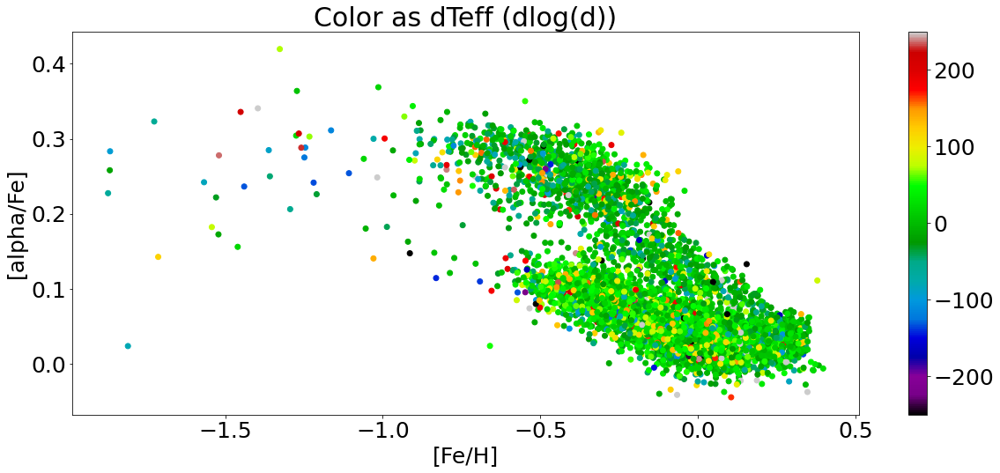

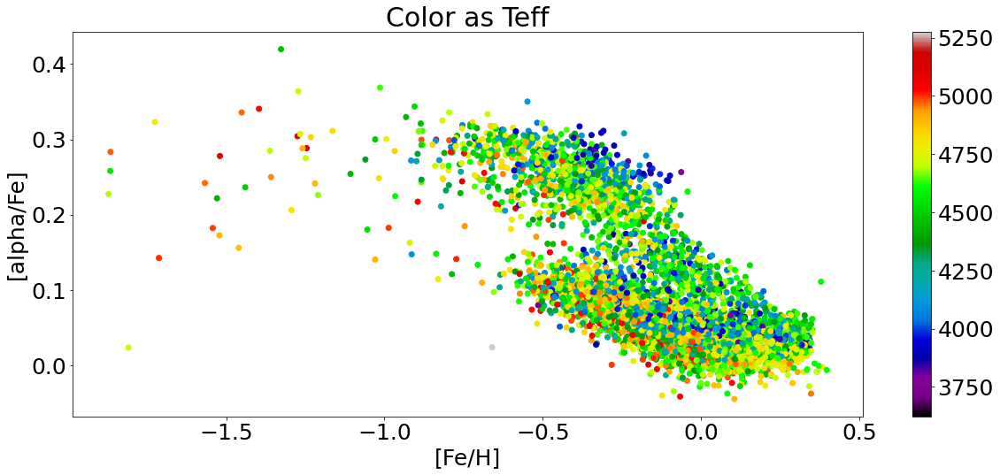

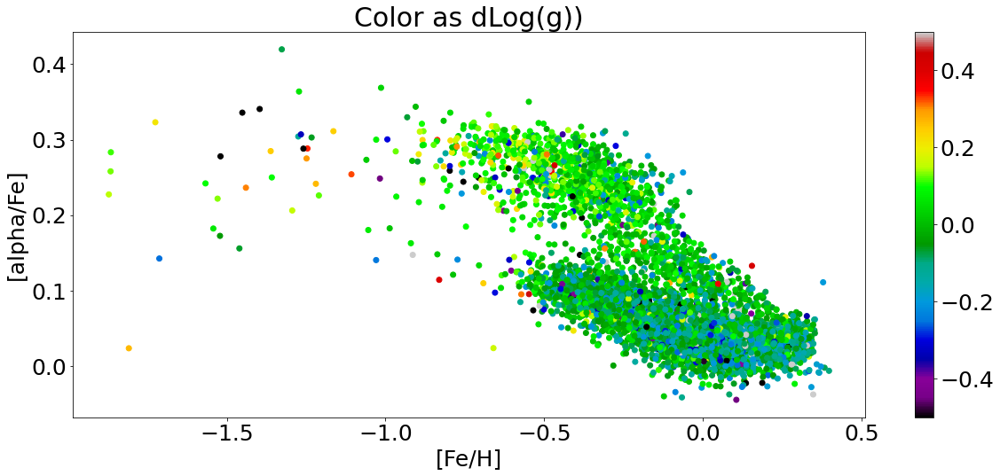

In [212]:
plt.figure(figsize=[20,8])
plt.scatter(kdr17['FE_H'],apoafe,c=kdteffs,cmap='nipy_spectral',vmax=250,vmin=-250)
plt.title(r'Color as dTeff (dlog(d))')
plt.xlabel(r'[Fe/H]')
plt.ylabel(r'[alpha/Fe]')
plt.colorbar()

plt.figure(figsize=[20,8])
plt.scatter(kdr17['FE_H'],apoafe,c=kdr17['TEFF'],cmap='nipy_spectral')#,vmax=250,vmin=-250)
plt.title(r'Color as Teff')
plt.xlabel(r'[Fe/H]')
plt.ylabel(r'[alpha/Fe]')
plt.colorbar()

plt.figure(figsize=[20,8])
plt.scatter(kdr17['FE_H'],apoafe,c=kdloggs,cmap='nipy_spectral',vmax=0.5,vmin=-0.5)
plt.title(r'Color as dLog(g))')
plt.xlabel(r'[Fe/H]')
plt.ylabel(r'[alpha/Fe]')
plt.colorbar()

<font size='45'>
    <b>
      Teff and K Magnitude  
    </b>
</font>

In [213]:
absK = kdr17['K']-5.*np.log10(1/kdr17['GAIAEDR3_PARALLAX']*1000)+5.-k672dr17['KIC_EBMV']*ak_ebv

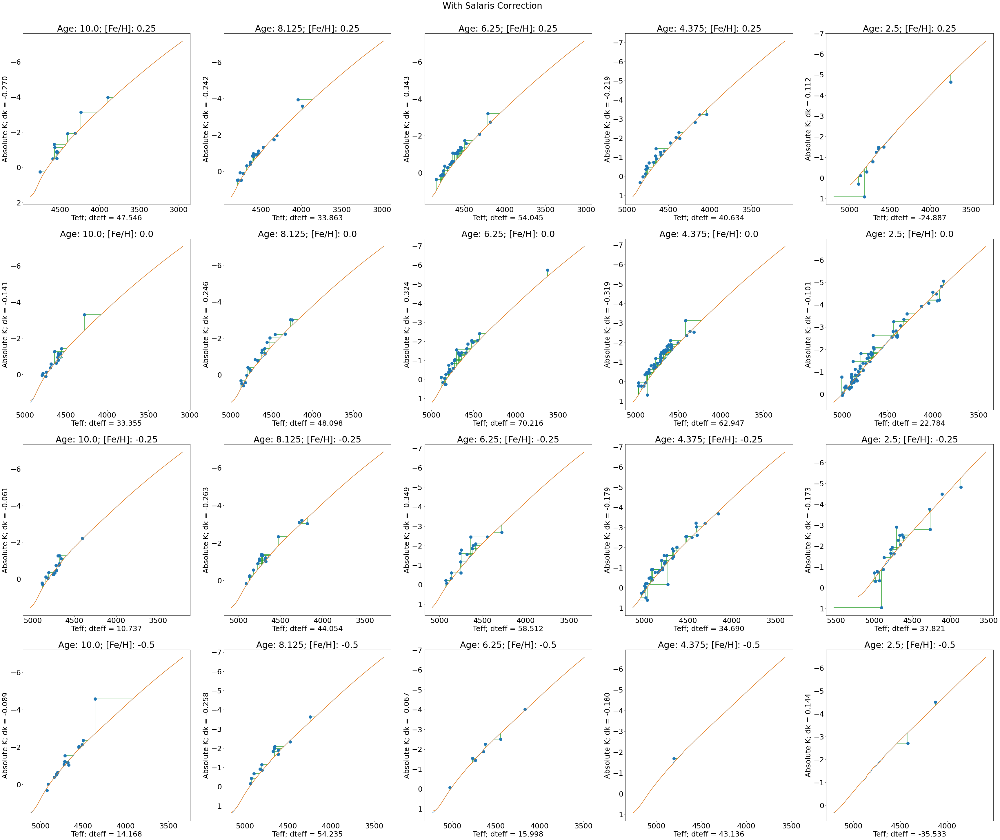

In [214]:
fehs = np.array([0.25,0.0,-0.25,-0.5])
ages = np.array([10,8.125,6.25,4.375,2.5])

dteff_arr_salaris = np.zeros((4,5))
dk_arr_salaris = np.zeros((4,5))

fehs_arr = np.zeros((4,5))
ages_arr = np.zeros((4,5))

alpha_arr = np.zeros((4,5))
salcorr_arr = np.zeros((4,5))

ids_single = np.array([])

sal_dlg_single = np.array([])
sal_dlt_single = np.array([])

fig, ax = plt.subplots(4,5,figsize=[60,50])
for i in range(4):
    for j in range(5):
        
        fehs_arr[i,j] = fehs[i]
        ages_arr[i,j] = ages[j]
        
        ### Select stars and their properties
        stars_select = np.where((k3dr17['IntAge']>=ages[j]-0.25)&(k3dr17['IntAge']<=ages[j]+0.25)&
                                (k3dr17['Fe/H']<=fehs[i]+0.05)&(k3dr17['Fe/H']>=fehs[i]-0.05)&(absK<100))
        
        starskmag = absK[stars_select]
        starsids = kdr17['APOGEE_ID'][stars_select]
        starsteff = kdr17['TEFF'][stars_select]
        
        salcorr = np.nanmedian(np.log10(0.655*(10**(apoafe[stars_select]))+0.345))
        starsals = np.log10(0.655*(10**(apoafe[stars_select]))+0.345)
        alpha_arr[i,j] = np.nanmedian(apoafe[stars_select])
        salcorr_arr[i,j] = salcorr
        
        starsids = starsids[np.argsort(starsteff)]
        ids_single = np.append(ids_single,starsids)

        ### Select isochrone
        stars_iso = massive[np.where((massive['MH']==closest(massive['MH'],fehs[i]+salcorr))&
                                     (massive['logAge']==closest(massive['logAge'],np.log10(ages[j]*10**9))))]
        
        ### plot stars
        ax[i,j].scatter(starsteff,starskmag,s=100)
        
        ### dteff
        stars_iso = stars_iso[np.argsort(stars_iso['Ksmag'])]

        spl1 = US(stars_iso['Ksmag'][::2],10**stars_iso['logTe'][::2],s=0)
        spl_xs1 = np.linspace(min(stars_iso['Ksmag']),max(stars_iso['Ksmag']))
        dteffs = starsteff-spl1(starskmag)
        sal_dlt_single = np.append(sal_dlt_single,dteffs)
        dteff_arr_salaris[i,j] = np.nanmedian(dteffs)
        
        for k in range(len(dteffs)):
            ax[i,j].hlines(y=starskmag[k],xmin=starsteff[k],xmax=starsteff[k]-dteffs[k],
                           color='tab:green',zorder=0)
        
        ax[i,j].plot(spl1(spl_xs1),spl_xs1)
        
        ### dk
        stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]
        
        spl2 = US(10**stars_iso['logTe'][::2],stars_iso['Ksmag'][::2],s=0)
        spl_xs2 = np.linspace(min(10**stars_iso['logTe']),max(10**stars_iso['logTe']))
        dks = starskmag - spl2(starsteff)
        sal_dlg_single = np.append(sal_dlg_single,dks)
        dk_arr_salaris[i,j] = np.nanmedian(dks)
        
        for k in range(len(dks)):
            ax[i,j].vlines(x=starsteff[k],ymin=starskmag[k],ymax=starskmag[k]-dks[k],
                           color='tab:green',zorder=0)
            
        ax[i,j].plot(spl_xs2,spl2(spl_xs2))
        
        ### Formatting
        ax[i,j].invert_xaxis()
        ax[i,j].invert_yaxis()
        
        ax[i,j].set_title(r'Age: {}; [Fe/H]: {}'.format(ages[j],fehs[i]))
        
        ax[i,j].set_xlabel(r'Teff; dteff = {:.3f}'.format(np.nanmedian(dteffs)))
        ax[i,j].set_ylabel(r'Absolute K; dk = {:.3f}'.format(np.nanmedian(dks)))

plt.suptitle(r'With Salaris Correction',y=0.91)
# plt.savefig('../plots/isochrone_compare_Salaris.pdf',dpi=300,bbox_inches='tight')
plt.show()

# Old Shifts Teff-K

/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


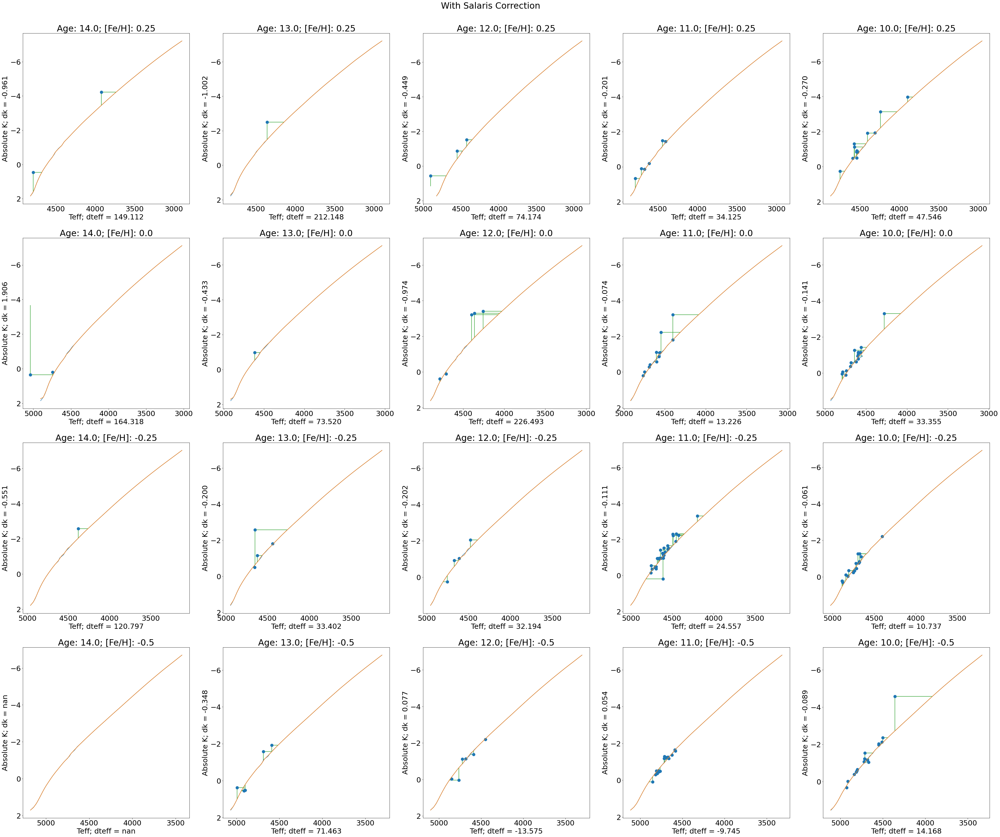

In [358]:
fehs = np.array([0.25,0.0,-0.25,-0.5])
ages = np.array([14.,13.,12.,11.,10.])

dteff_arr_salaris = np.zeros((4,5))
dk_arr_salaris = np.zeros((4,5))

fehs_arr = np.zeros((4,5))
ages_arr = np.zeros((4,5))

alpha_arr = np.zeros((4,5))
salcorr_arr = np.zeros((4,5))

# ids_single = np.array([])

# sal_dlg_single = np.array([])
# sal_dlt_single = np.array([])

fig, ax = plt.subplots(4,5,figsize=[60,50])
for i in range(4):
    for j in range(5):
        
        fehs_arr[i,j] = fehs[i]
        ages_arr[i,j] = ages[j]
        
        ### Select stars and their properties
        stars_select = np.where((k3dr17['IntAge']>=ages[j]-0.25)&(k3dr17['IntAge']<=ages[j]+0.25)&
                                (k3dr17['Fe/H']<=fehs[i]+0.05)&(k3dr17['Fe/H']>=fehs[i]-0.05)&(absK<100))
        
        starskmag = absK[stars_select]
        starsids = kdr17['APOGEE_ID'][stars_select]
        starsteff = kdr17['TEFF'][stars_select]
        
        salcorr = np.nanmedian(np.log10(0.655*(10**(apoafe[stars_select]))+0.345))
        starsals = np.log10(0.655*(10**(apoafe[stars_select]))+0.345)
#         alpha_arr[i,j] = np.nanmedian(apoafe[stars_select])
#         salcorr_arr[i,j] = salcorr
        
        starsids = starsids[np.argsort(starsteff)]
        ids_single = np.append(ids_single,starsids)

        ### Select isochrone
        stars_iso = massive[np.where((massive['MH']==closest(massive['MH'],fehs[i]+salcorr))&
                                     (massive['logAge']==closest(massive['logAge'],np.log10(ages[j]*10**9))))]
        
        ### plot stars
        ax[i,j].scatter(starsteff,starskmag,s=100)
        
        ### dteff
        stars_iso = stars_iso[np.argsort(stars_iso['Ksmag'])]

        spl1 = US(stars_iso['Ksmag'][::2],10**stars_iso['logTe'][::2],s=0)
        spl_xs1 = np.linspace(min(stars_iso['Ksmag']),max(stars_iso['Ksmag']))
        dteffs = starsteff-spl1(starskmag)
#         sal_dlt_single = np.append(sal_dlt_single,dteffs)
#         dteff_arr_salaris[i,j] = np.nanmedian(dteffs)
        
        for k in range(len(dteffs)):
            ax[i,j].hlines(y=starskmag[k],xmin=starsteff[k],xmax=starsteff[k]-dteffs[k],
                           color='tab:green',zorder=0)
        
        ax[i,j].plot(spl1(spl_xs1),spl_xs1)
        
        ### dk
        stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]
        
        spl2 = US(10**stars_iso['logTe'][::2],stars_iso['Ksmag'][::2],s=0)
        spl_xs2 = np.linspace(min(10**stars_iso['logTe']),max(10**stars_iso['logTe']))
        dks = starskmag - spl2(starsteff)
#         sal_dlg_single = np.append(sal_dlg_single,dks)
#         dk_arr_salaris[i,j] = np.nanmedian(dks)
        
        for k in range(len(dks)):
            ax[i,j].vlines(x=starsteff[k],ymin=starskmag[k],ymax=starskmag[k]-dks[k],
                           color='tab:green',zorder=0)
            
        ax[i,j].plot(spl_xs2,spl2(spl_xs2))
        
        ### Formatting
        ax[i,j].invert_xaxis()
        ax[i,j].invert_yaxis()
        
        ax[i,j].set_title(r'Age: {}; [Fe/H]: {}'.format(ages[j],fehs[i]))
        
        ax[i,j].set_xlabel(r'Teff; dteff = {:.3f}'.format(np.nanmedian(dteffs)))
        ax[i,j].set_ylabel(r'Absolute K; dk = {:.3f}'.format(np.nanmedian(dks)))

plt.suptitle(r'With Salaris Correction',y=0.91)
# plt.savefig('../plots/isochrone_compare_Salaris.pdf',dpi=300,bbox_inches='tight')
plt.show()

# Young Shifts Teff-K

/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


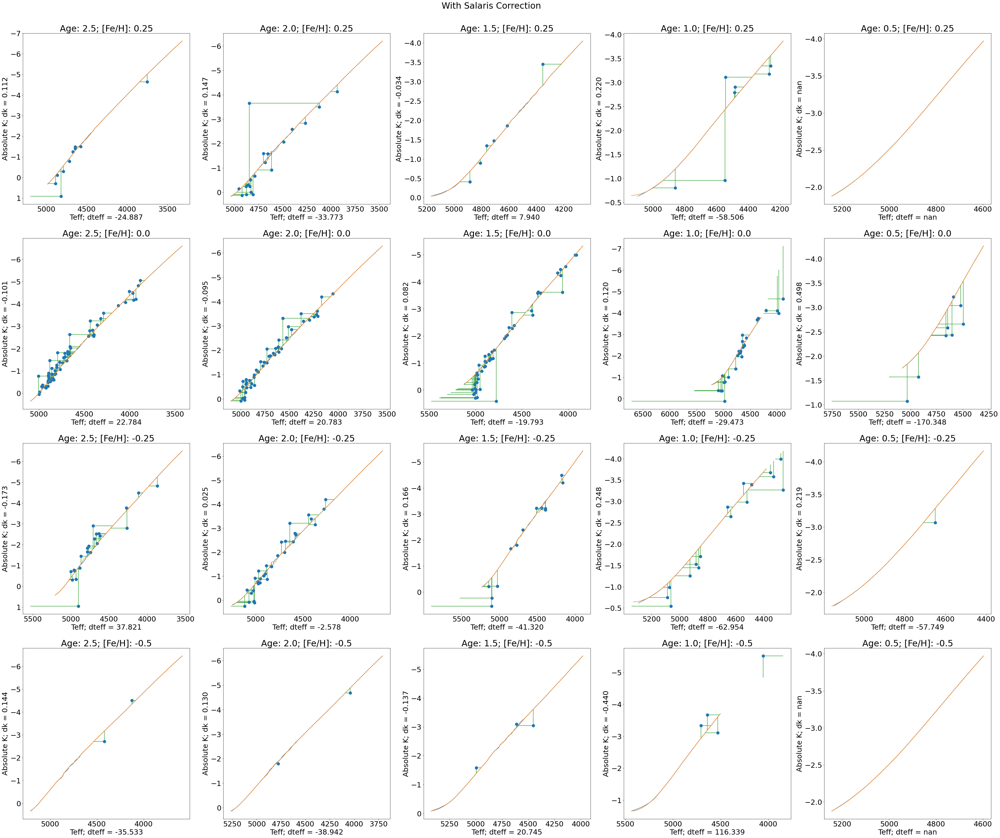

In [359]:
fehs = np.array([0.25,0.0,-0.25,-0.5])
ages =  np.array([2.5,2.0,1.5,1.0,0.5])

dteff_arr_salaris = np.zeros((4,5))
dk_arr_salaris = np.zeros((4,5))

fehs_arr = np.zeros((4,5))
ages_arr = np.zeros((4,5))

alpha_arr = np.zeros((4,5))
salcorr_arr = np.zeros((4,5))

# ids_single = np.array([])

# sal_dlg_single = np.array([])
# sal_dlt_single = np.array([])

fig, ax = plt.subplots(4,5,figsize=[60,50])
for i in range(4):
    for j in range(5):
        
        fehs_arr[i,j] = fehs[i]
        ages_arr[i,j] = ages[j]
        
        ### Select stars and their properties
        stars_select = np.where((k3dr17['IntAge']>=ages[j]-0.25)&(k3dr17['IntAge']<=ages[j]+0.25)&
                                (k3dr17['Fe/H']<=fehs[i]+0.05)&(k3dr17['Fe/H']>=fehs[i]-0.05)&(absK<100))
        
        starskmag = absK[stars_select]
        starsids = kdr17['APOGEE_ID'][stars_select]
        starsteff = kdr17['TEFF'][stars_select]
        
        salcorr = np.nanmedian(np.log10(0.655*(10**(apoafe[stars_select]))+0.345))
        starsals = np.log10(0.655*(10**(apoafe[stars_select]))+0.345)
#         alpha_arr[i,j] = np.nanmedian(apoafe[stars_select])
#         salcorr_arr[i,j] = salcorr
        
        starsids = starsids[np.argsort(starsteff)]
        ids_single = np.append(ids_single,starsids)

        ### Select isochrone
        stars_iso = massive[np.where((massive['MH']==closest(massive['MH'],fehs[i]+salcorr))&
                                     (massive['logAge']==closest(massive['logAge'],np.log10(ages[j]*10**9))))]
        
        ### plot stars
        ax[i,j].scatter(starsteff,starskmag,s=100)
        
        ### dteff
        stars_iso = stars_iso[np.argsort(stars_iso['Ksmag'])]

        spl1 = US(stars_iso['Ksmag'][::2],10**stars_iso['logTe'][::2],s=0)
        spl_xs1 = np.linspace(min(stars_iso['Ksmag']),max(stars_iso['Ksmag']))
        dteffs = starsteff-spl1(starskmag)
#         sal_dlt_single = np.append(sal_dlt_single,dteffs)
#         dteff_arr_salaris[i,j] = np.nanmedian(dteffs)
        
        for k in range(len(dteffs)):
            ax[i,j].hlines(y=starskmag[k],xmin=starsteff[k],xmax=starsteff[k]-dteffs[k],
                           color='tab:green',zorder=0)
        
        ax[i,j].plot(spl1(spl_xs1),spl_xs1)
        
        ### dk
        stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]
        
        spl2 = US(10**stars_iso['logTe'][::2],stars_iso['Ksmag'][::2],s=0)
        spl_xs2 = np.linspace(min(10**stars_iso['logTe']),max(10**stars_iso['logTe']))
        dks = starskmag - spl2(starsteff)
#         sal_dlg_single = np.append(sal_dlg_single,dks)
#         dk_arr_salaris[i,j] = np.nanmedian(dks)
        
        for k in range(len(dks)):
            ax[i,j].vlines(x=starsteff[k],ymin=starskmag[k],ymax=starskmag[k]-dks[k],
                           color='tab:green',zorder=0)
            
        ax[i,j].plot(spl_xs2,spl2(spl_xs2))
        
        ### Formatting
        ax[i,j].invert_xaxis()
        ax[i,j].invert_yaxis()
        
        ax[i,j].set_title(r'Age: {}; [Fe/H]: {}'.format(ages[j],fehs[i]))
        
        ax[i,j].set_xlabel(r'Teff; dteff = {:.3f}'.format(np.nanmedian(dteffs)))
        ax[i,j].set_ylabel(r'Absolute K; dk = {:.3f}'.format(np.nanmedian(dks)))

plt.suptitle(r'With Salaris Correction',y=0.91)
# plt.savefig('../plots/isochrone_compare_Salaris.pdf',dpi=300,bbox_inches='tight')
plt.show()

In [215]:
# plt.scatter(starsteff,starskmag,s=100)

In [216]:
# stars_select

In [217]:
# ### Select stars and their properties
# stars_select = np.where((k3dr17['IntAge']>=8.125-0.25)&(k3dr17['IntAge']<=8.125+0.25)&
#                         (k3dr17['Fe/H']<=0.25+0.05)&(k3dr17['Fe/H']>=0.25-0.05)&(absK<100))

# starskmag = absK[stars_select]
# starsids = kdr17['APOGEE_ID'][stars_select]
# starsteff = kdr17['TEFF'][stars_select]

# salcorr = np.nanmedian(np.log10(0.655*(10**(apoafe[stars_select]))+0.345))
# starsals = np.log10(0.655*(10**(apoafe[stars_select]))+0.345)
# alpha_arr[i,j] = np.nanmedian(apoafe[stars_select])
# salcorr_arr[i,j] = salcorr

# starsids = starsids[np.argsort(starsteff)]
# ids_single = np.append(ids_single,starsids)

# ### Select isochrone
# stars_iso = massive[np.where((massive['MH']==closest(massive['MH'],fehs[i]+salcorr))&
#                              (massive['logAge']==closest(massive['logAge'],np.log10(ages[j]*10**9))))]

# # ### plot stars
# plt.scatter(starsteff,starskmag,s=100)

# # ### dteff
# # stars_iso = stars_iso[np.argsort(stars_iso['Ksmag'])]

# # spl1 = US(stars_iso['Ksmag'][::2],10**stars_iso['logTe'][::2],s=0)
# # spl_xs1 = np.linspace(min(stars_iso['Ksmag']),max(stars_iso['Ksmag']))
# # dteffs = starsteff-spl1(starskmag)
# # sal_dlt_single = np.append(sal_dlt_single,dteffs)
# # dteff_arr_salaris[i,j] = np.nanmedian(dteffs)

# # for k in range(len(dteffs)):
# #     ax[i,j].hlines(y=starskmag[k],xmin=starsteff[k],xmax=starsteff[k]-dteffs[k],
# #                    color='tab:green',zorder=0)

# # ax[i,j].plot(spl1(spl_xs1),spl_xs1)

# # ### dk
# # stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]

# # spl2 = US(10**stars_iso['logTe'][::2],stars_iso['Ksmag'][::2],s=0)
# # spl_xs2 = np.linspace(min(10**stars_iso['logTe']),max(10**stars_iso['logTe']))
# # dks = starskmag - spl2(starsteff)
# # sal_dlg_single = np.append(sal_dlg_single,dks)
# # dk_arr_salaris[i,j] = np.nanmedian(dks)

# # for k in range(len(dks)):
# #     ax[i,j].vlines(x=starsteff[k],ymin=starskmag[k],ymax=starskmag[k]-dks[k],
# #                    color='tab:green',zorder=0)

# # ax[i,j].plot(spl_xs2,spl2(spl_xs2))

# # ### Formatting
# plt.gca().invert_xaxis()
# plt.gca().invert_yaxis()

# # ax[i,j].set_title(r'Age: {}; [Fe/H]: {}'.format(ages[j],fehs[i]))

# # ax[i,j].set_xlabel(r'Teff; dteff = {:.3f}'.format(np.nanmedian(dteffs)))
# # ax[i,j].set_ylabel(r'Absolute K; dk = {:.3f}'.format(np.nanmedian(dks)))

In [218]:
dteffs_mag = 999999.0*np.ones(len(kdr17))
dks_mag = 999999.0*np.ones(len(kdr17))

for i in tqdm_notebook(range(len(kdr17))):
    
    salcorr = np.nanmedian(np.log10(0.655*(10**(apoafe[i]))+0.345))

    stars_iso = massive[np.where((massive['MH']==closest(massive['MH'],kdr17['FE_H'][i]+salcorr))&
                             (massive['logAge']==closest(massive['logAge'],np.log10(k3dr17['IntAge'][i]*10**9))))]
    
    try:
        
        ### dteff 
        stars_iso = stars_iso[np.argsort(stars_iso['Ksmag'])]
        spl1 = US(stars_iso['Ksmag'][::2],10**stars_iso['logTe'][::2],s=0)
        dteffs_mag[i] = kdr17['Teff'][i]-spl1(absK[i])

        ### dk
        stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]
        spl2 = US(10**stars_iso['logTe'][::2],stars_iso['Ksmag'][::2],s=0)
        dks_mag[i] = absK[i] - spl2(k3dr17['Teff'][i])
    
    except:
        
        try:
            ### dteff 
            stars_iso = stars_iso[np.argsort(stars_iso['Ksmag'])]
            spl1 = US(stars_iso['Ksmag'][::3],10**stars_iso['logTe'][::3],s=0)
            dteffs_mag[i] = kdr17['Teff'][i]-spl1(absK[i])

            ### dk
            stars_iso = stars_iso[np.argsort(stars_iso['logTe'])]
            spl2 = US(10**stars_iso['logTe'][::3],stars_iso['Ksmag'][::3],s=0)
            dks_mag[i] = absK[i] - spl2(k3dr17['Teff'][i])

        except:
            dteffs_mag[i] = 999999.0
            dks_mag[i] = 999999.0

<ipython-input-218-29aec0735b7c>:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i in tqdm_notebook(range(len(kdr17))):


/opt/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


In [219]:
len(np.squeeze(np.where(dteffs_mag>-1000)))/len(dteffs_mag)

0.8496055226824457

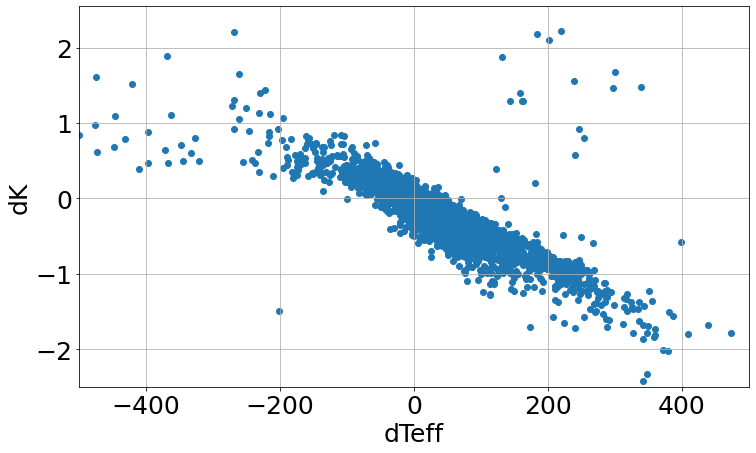

In [220]:
plt.figure(figsize=[12,7])
plt.scatter(dteffs_mag[np.where((dteffs_mag>-1000)&(dks_mag<10)&(dks_mag>-10))],
            dks_mag[np.where((dteffs_mag>-1000)&(dks_mag<10)&(dks_mag>-10))])
plt.xlim(-500,500)
plt.ylim(-2.5,2.55)

plt.xlabel(r'dTeff')
plt.ylabel(r'dK')
plt.grid()

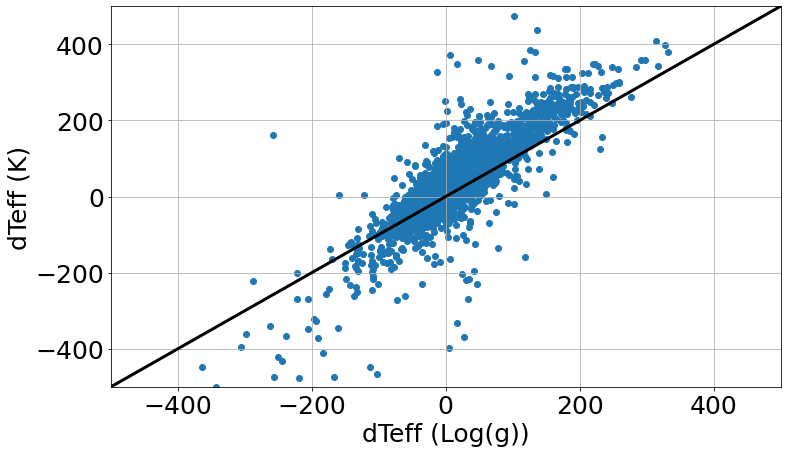

In [221]:
plt.figure(figsize=[12,7])
plt.scatter(kdteffs[np.where((dteffs_mag>-1000)&(dks_mag<10)&(dks_mag>-10))],
            dteffs_mag[np.where((dteffs_mag>-1000)&(dks_mag<10)&(dks_mag>-10))])
plt.plot([-500,500],[-500,500],c='k',lw=3.0)

plt.xlim(-500,500)
plt.ylim(-500,500)
plt.xlabel(r'dTeff (Log(g))')
plt.ylabel(r'dTeff (K)')

plt.grid()

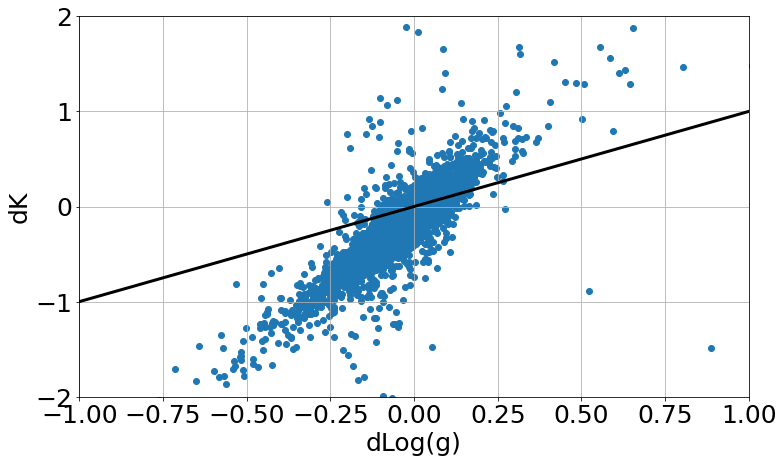

In [222]:
plt.figure(figsize=[12,7])
plt.scatter(kdloggs[np.where((dteffs_mag>-1000)&(dks_mag<10)&(dks_mag>-10))],
            dks_mag[np.where((dteffs_mag>-1000)&(dks_mag<10)&(dks_mag>-10))])
plt.plot([-2,2],[-2,2],c='k',lw=3.0)

plt.xlim(-1,1)
plt.ylim(-2,2)
plt.xlabel(r'dLog(g)')
plt.ylabel(r'dK')

plt.grid()

## [Fe/H] dTeff From Teff-K

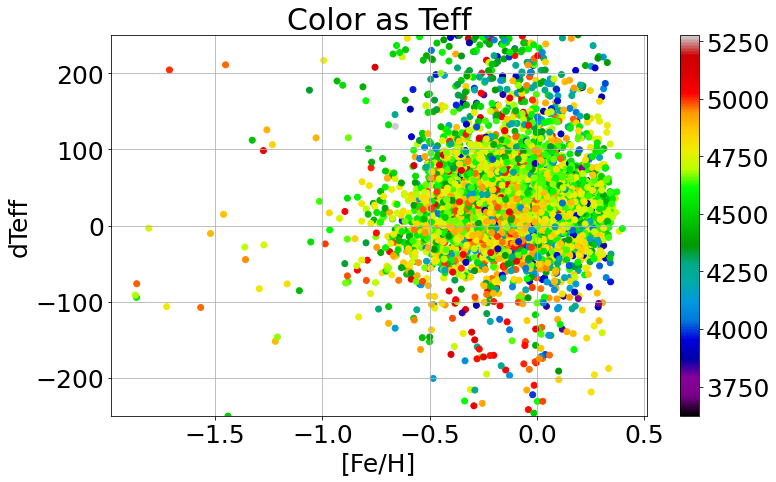

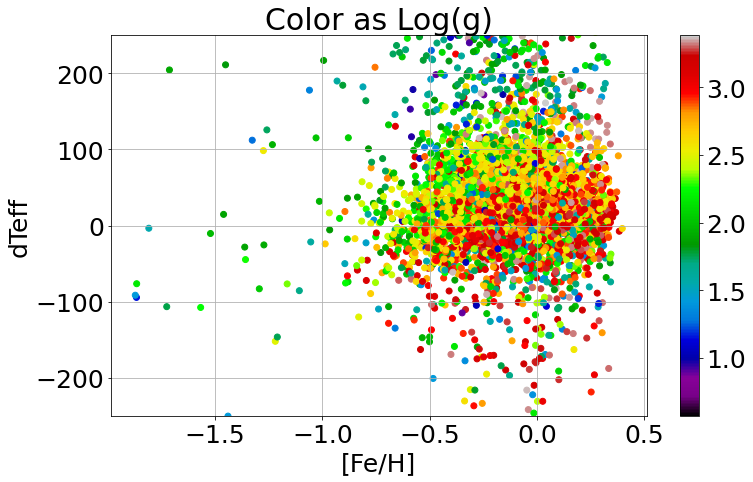

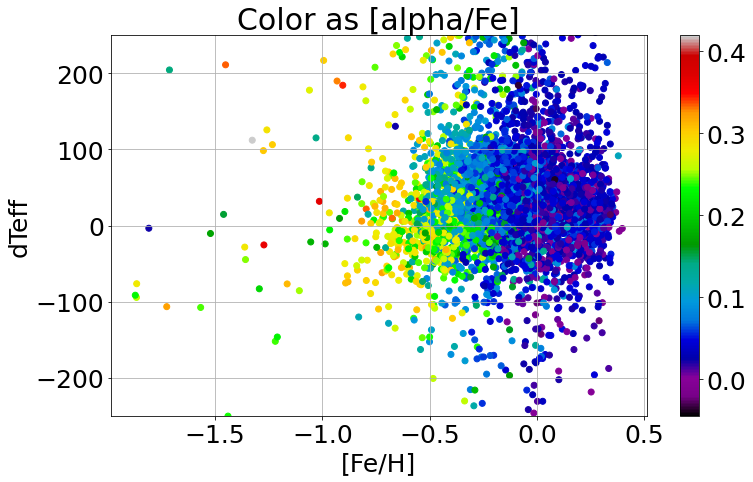

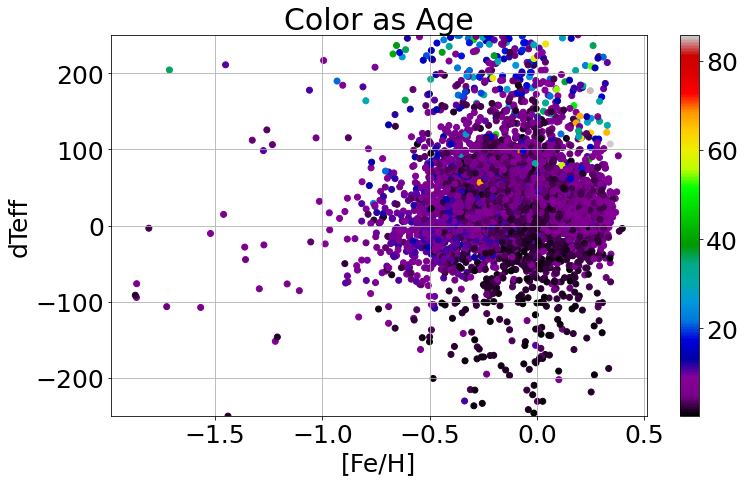

In [223]:
dfull_mag_colors = np.array([kdr17['TEFF'],k3dr17['Logg'],apoafe,k3dr17['IntAge']])
dfull_mag_titles = np.array(['Teff','Log(g)','[alpha/Fe]','Age'])

for i in range(len(dfull_mag_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['FE_H'],dteffs_mag,c=dfull_mag_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-250,250)

    plt.title(r'Color as {}'.format(dfull_mag_titles[i]))
    plt.xlabel(r'[Fe/H]')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

Fit Parameters:
a = -134.56129
b = -16.84827
feh0 = -0.62602
dteff0 = -4.71220


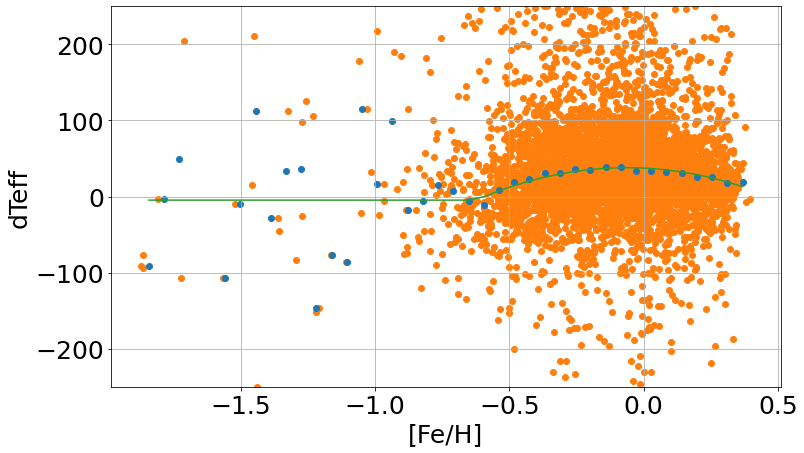

In [257]:
from scipy.optimize import curve_fit

def dteff_feh_k(x,a,b,feh0,dteff0):
    return np.piecewise(x,[x<feh0],[lambda x: dteff0, 
                                    lambda x: a*(x**2-feh0**2)+b*(x-feh0)+dteff0])

cut = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(dteffs_mag)==True)&
               (dteffs_mag>-250)&(dteffs_mag<250))
bin_means, bin_edges, _ = binned_statistic(kdr17['FE_H'][cut],dteffs_mag[cut],statistic='median',bins=40)
bin_centers = (bin_edges[:-1]+np.diff(bin_edges)/2)

fincut = np.where((np.isfinite(bin_means)==True)&(np.isfinite(bin_centers)==True))

param_labels = np.array(['a','b','feh0','dteff0'])
popt_feh_k, _ = curve_fit(dteff_feh_k,bin_centers[fincut],bin_means[fincut],p0=[1., 1., -0.5, 0.])

print('Fit Parameters:')
for i in range(4):
    print(r'{} = {:.5f}'.format(param_labels[i],popt_feh_k[i]))

plt.figure(figsize=[12,7])
plt.scatter(kdr17['FE_H'],dteffs_mag,c='tab:orange')
plt.scatter(bin_centers[fincut], bin_means[fincut],c='tab:blue')
plt.plot(bin_centers[fincut],dteff_feh_k(bin_centers[fincut],*popt_feh_k),c='tab:green')
plt.ylim(-250,250)
plt.grid()

plt.xlabel(r'[Fe/H]')
plt.ylabel(r'dTeff')
plt.show()

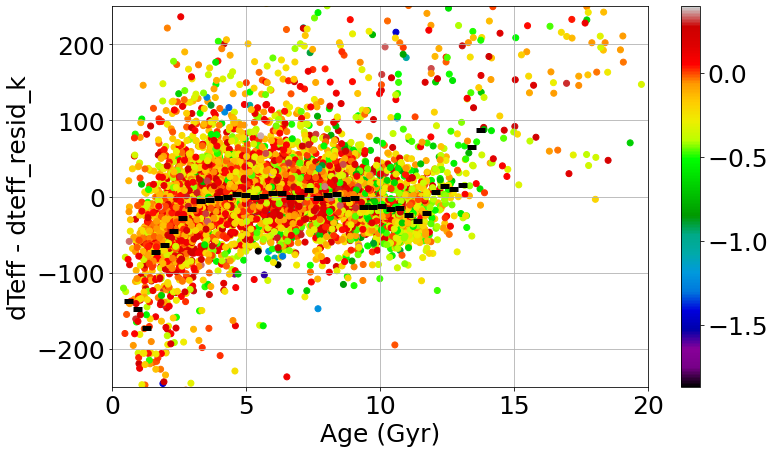

Fit Parameters:
a = 0.62717
b = -14.69484
c = 104.66032
dteff0_age = 69.53277


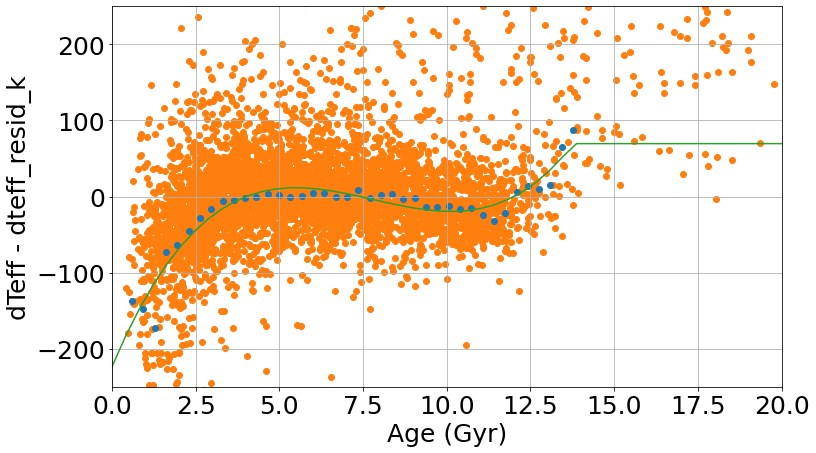

In [260]:
dteff_resid_k = dteffs_mag-dteff_feh_k(kdr17['FE_H'],*popt_feh_k)

cut = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(k3dr17['IntAge'])==True)&
               (k3dr17['IntAge']<14)&(np.isfinite(dteff_resid_k)==True))
bin_means, bin_edges, _ = binned_statistic(k3dr17['IntAge'][cut],dteff_resid_k[cut],statistic='median',bins=40)
bin_centers = (bin_edges[:-1]+np.diff(bin_edges)/2)

plt.figure(figsize=[12,7])
plt.scatter(k3dr17['IntAge'],dteff_resid_k,c=kdr17['FE_H'],cmap='nipy_spectral')
plt.hlines(bin_means, bin_edges[:-1], bin_edges[1:], colors='k', lw=5.)
plt.colorbar()

plt.xlim(0,20)
plt.ylim(-250,250)
plt.grid()

plt.xlabel(r'Age (Gyr)')
plt.ylabel(r'dTeff - dteff_resid_k')
plt.show()

# ##############################
# def dteffresid_age_k(x,a,b,c,d):
#     return a*x**3+b*x**2+c*x+d

def dteffresid_age_k(x,a,b,c,dteff0_age):
    return np.piecewise(x,[x>13.787],[lambda x: dteff0_age, 
                                    lambda x: a*(x**3-13.787**3)+b*(x**2-13.787**2)+c*(x-13.787)+dteff0_age])

popt_age_k, _ = curve_fit(dteffresid_age_k, bin_centers, bin_means)

param_labels = np.array(['a','b','c','dteff0_age'])
print('Fit Parameters:')
for i in range(4):
    print(r'{} = {:.5f}'.format(param_labels[i],popt_age_k[i]))
    
plt.figure(figsize=[12,7])
plt.scatter(k3dr17['IntAge'],dteff_resid_k,c='tab:orange')
plt.scatter(bin_centers, bin_means,c='tab:blue')
plt.plot(np.linspace(0,20),dteffresid_age_k(np.linspace(0,20),*popt_age_k),c='tab:green')
plt.xlim(0,20)
plt.ylim(-250,250)
plt.grid()

plt.xlabel(r'Age (Gyr)')
plt.ylabel(r'dTeff - dteff_resid_k')
plt.show()

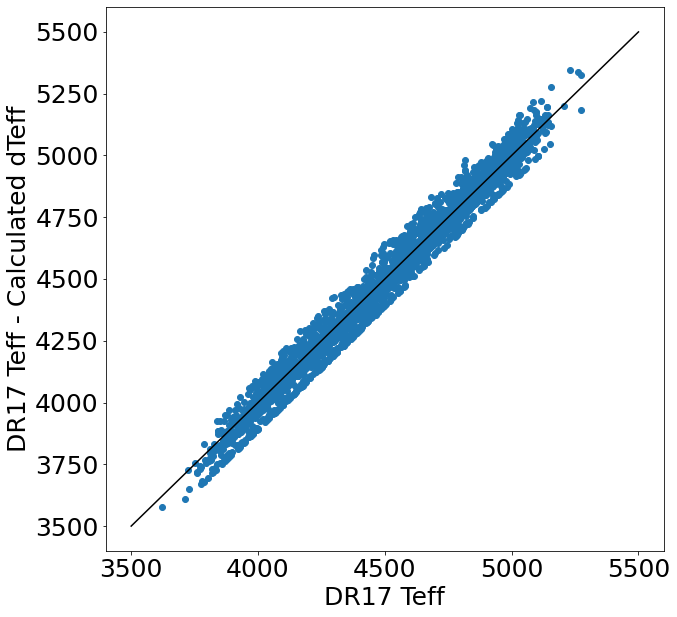

In [261]:
dteff_new = dteffresid_age_k(k3dr17['IntAge'],*popt_age_k)+dteff_feh_k(kdr17['FE_H'],*popt_feh_k)

plt.figure(figsize=[10,10])
plt.scatter(kdr17['TEFF'],kdr17['TEFF']-dteff_new)
plt.plot([3500,5500],[3500,5500],c='k')
plt.xlabel(r'DR17 Teff')
plt.ylabel(r'DR17 Teff - Calculated dTeff')
plt.show()

## [Fe/H] dK From Teff-K

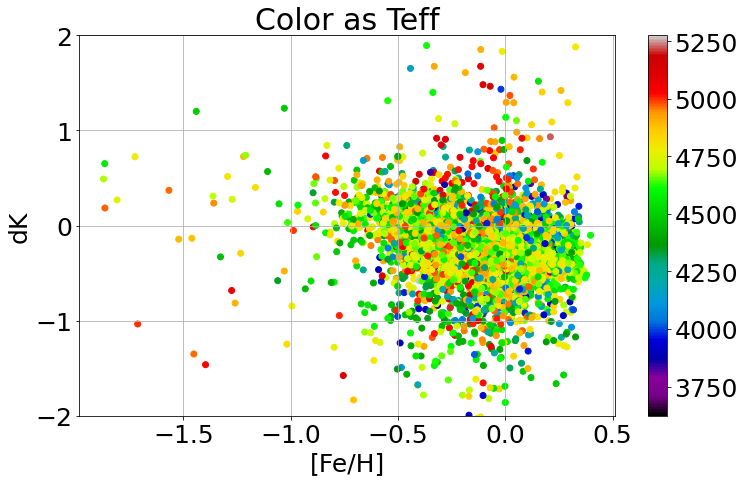

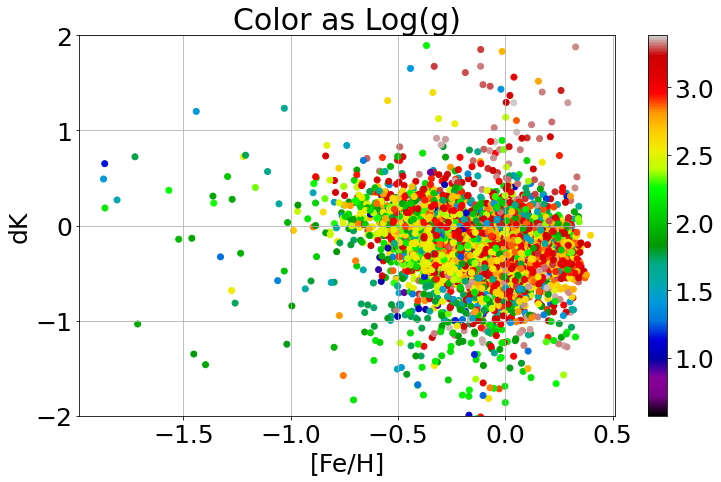

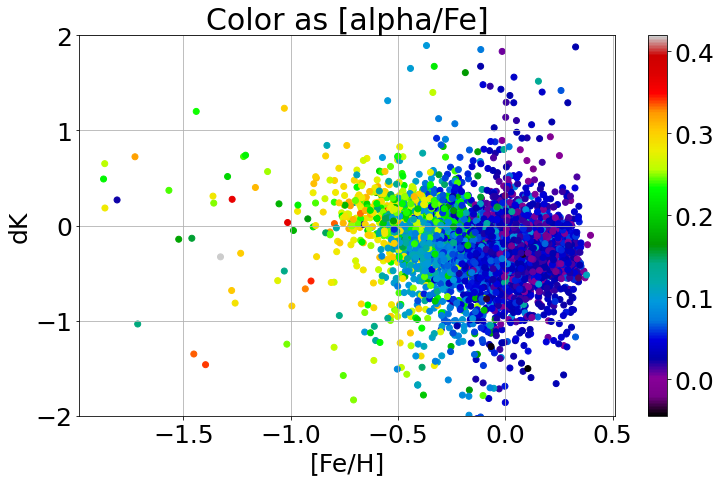

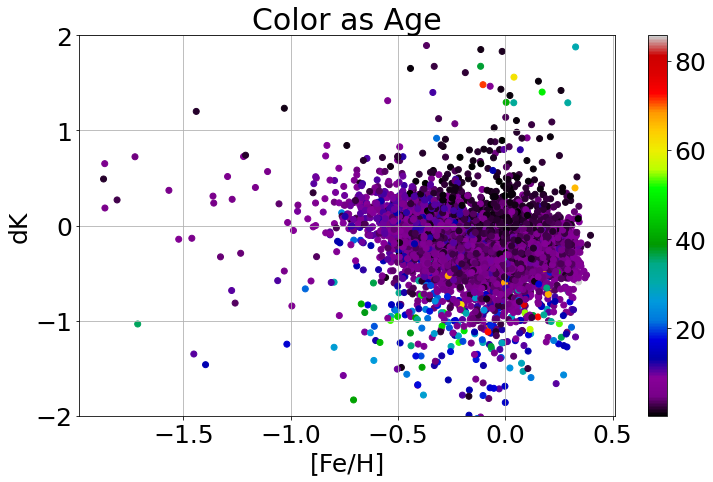

In [224]:
dfull_mag_colors = np.array([kdr17['TEFF'],k3dr17['Logg'],apoafe,k3dr17['IntAge']])
dfull_mag_titles = np.array(['Teff','Log(g)','[alpha/Fe]','Age'])

for i in range(len(dfull_mag_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['FE_H'],dks_mag,c=dfull_mag_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-2.0,2.0)

    plt.title(r'Color as {}'.format(dfull_mag_titles[i]))
    plt.xlabel(r'[Fe/H]')
    plt.ylabel(r'dK')
    plt.grid()
    plt.show()

## Teff dTeff From Teff-K

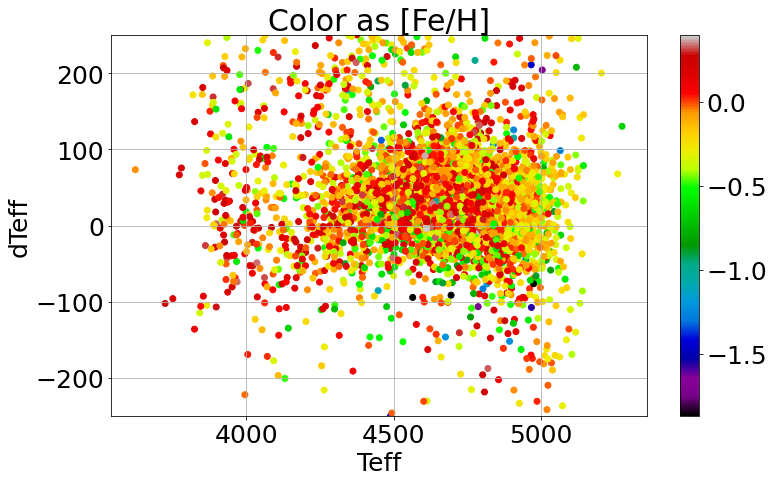

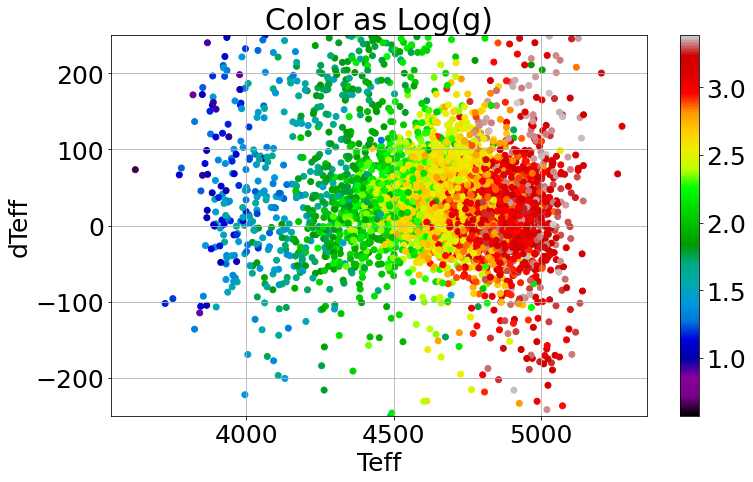

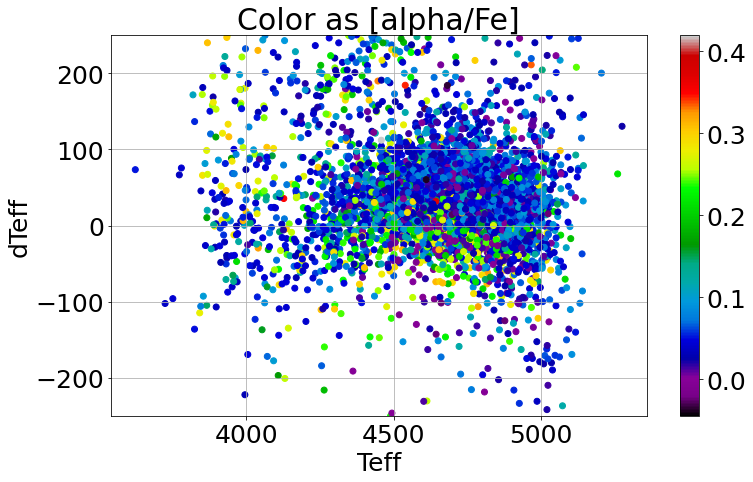

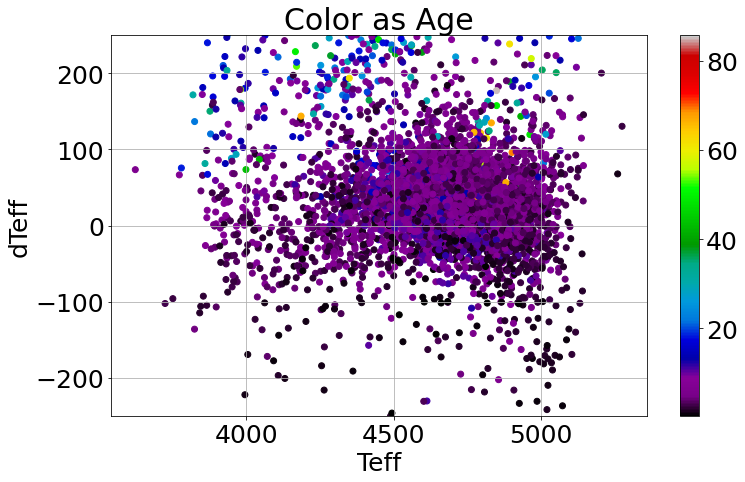

In [225]:
dfull_mag_colors = np.array([kdr17['FE_H'],k3dr17['Logg'],apoafe,k3dr17['IntAge']])
dfull_mag_titles = np.array(['[Fe/H]','Log(g)','[alpha/Fe]','Age'])

for i in range(len(dfull_mag_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['TEFF'],dteffs_mag,c=dfull_mag_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-250,250)

    plt.title(r'Color as {}'.format(dfull_mag_titles[i]))
    plt.xlabel(r'Teff')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

## Teff dK From Teff-K

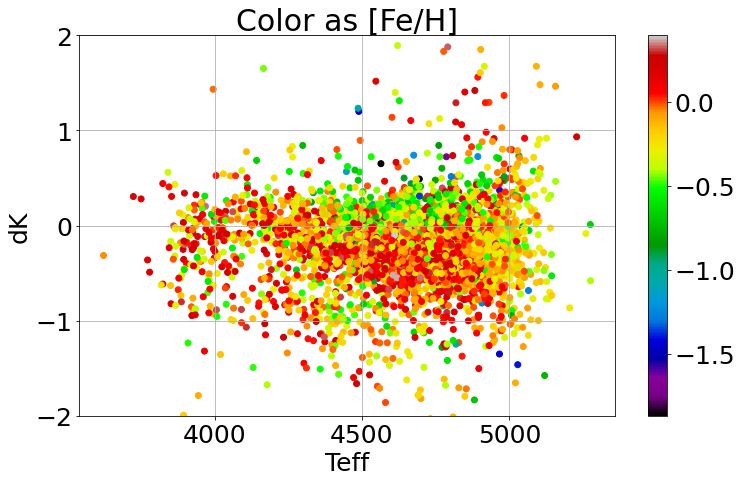

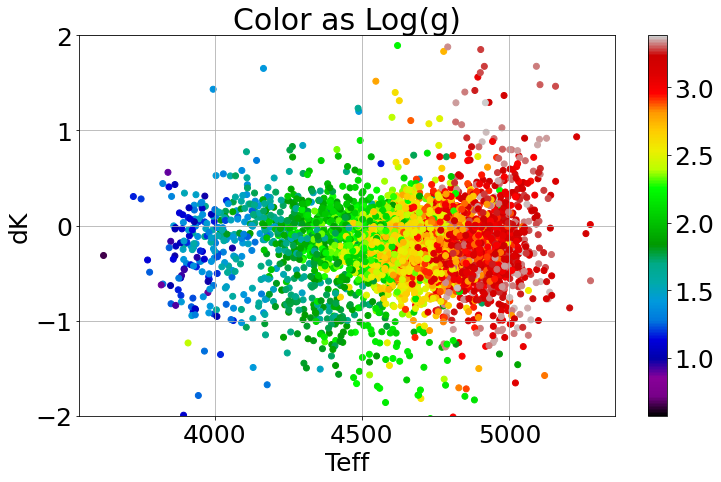

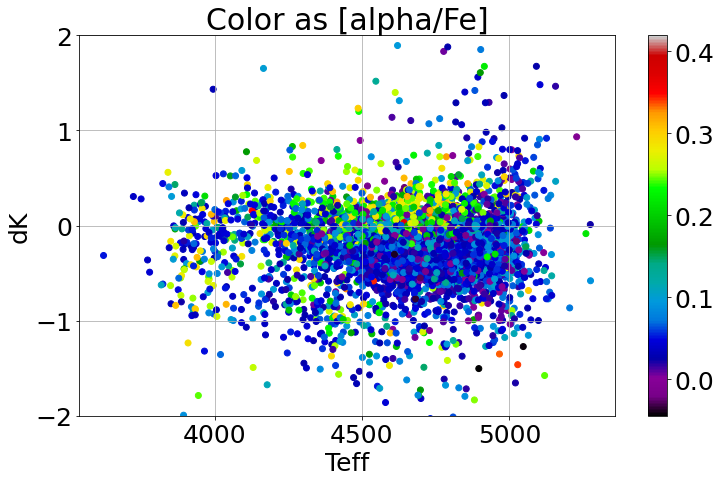

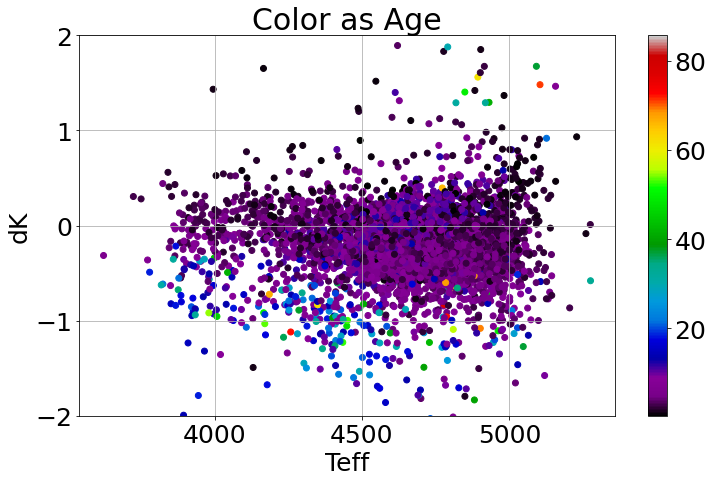

In [226]:
dfull_mag_colors = np.array([kdr17['FE_H'],k3dr17['Logg'],apoafe,k3dr17['IntAge']])
dfull_mag_titles = np.array(['[Fe/H]','Log(g)','[alpha/Fe]','Age'])

for i in range(len(dfull_mag_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['TEFF'],dks_mag,c=dfull_mag_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-2.0,2.0)

    plt.title(r'Color as {}'.format(dfull_mag_titles[i]))
    plt.xlabel(r'Teff')
    plt.ylabel(r'dK')
    plt.grid()
    plt.show()

## Log(g) dTeff From Teff-K

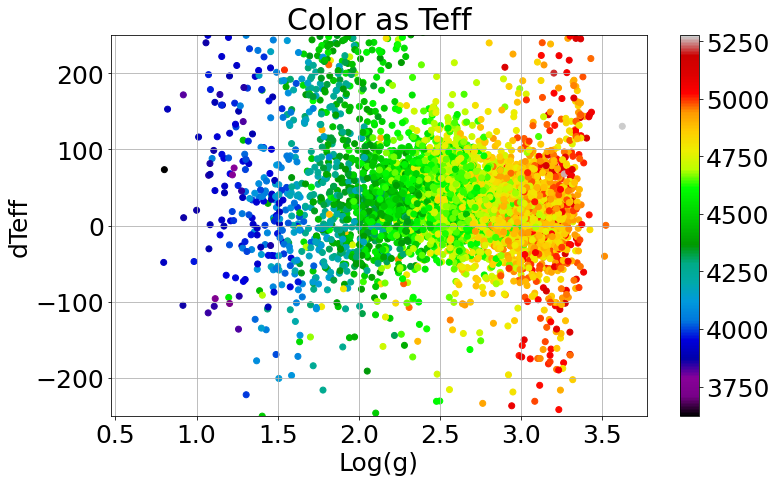

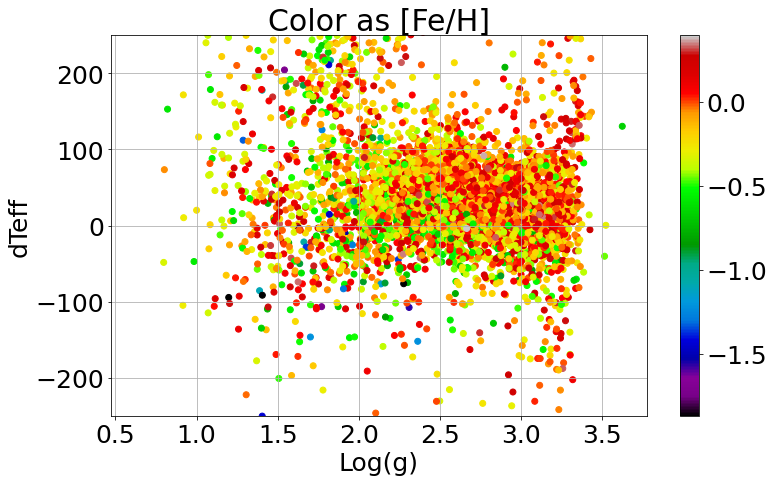

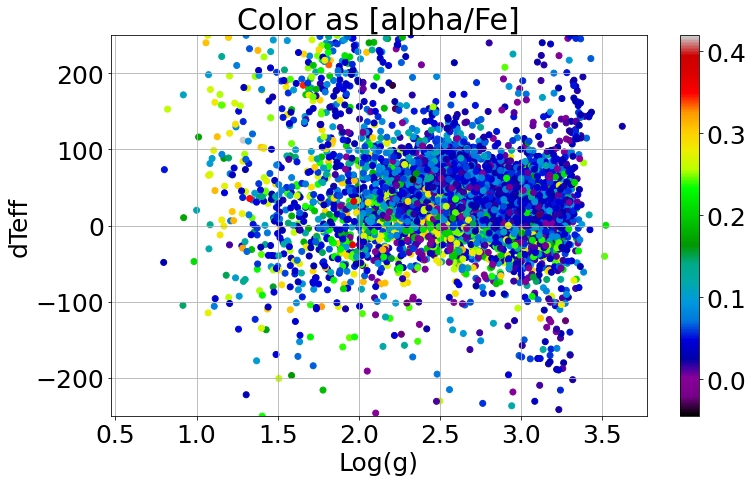

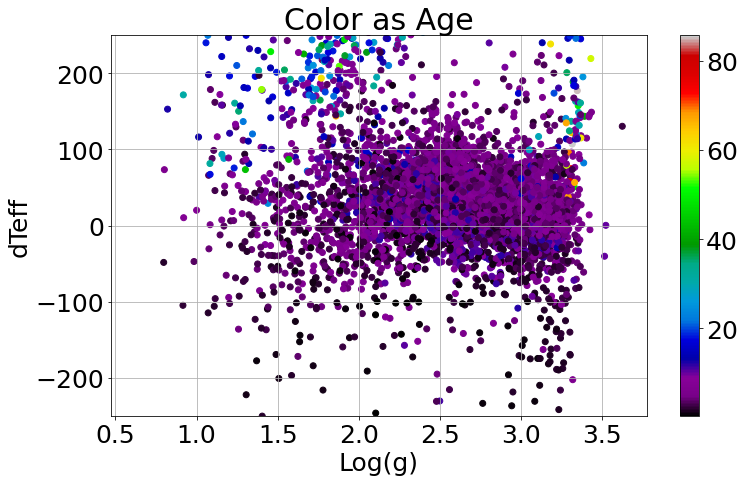

In [227]:
dfull_mag_colors = np.array([kdr17['TEFF'],kdr17['FE_H'],apoafe,k3dr17['IntAge']])
dfull_mag_titles = np.array(['Teff','[Fe/H]','[alpha/Fe]','Age'])

for i in range(len(dfull_mag_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['LOGG'],dteffs_mag,c=dfull_mag_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-250,250)

    plt.title(r'Color as {}'.format(dfull_mag_titles[i]))
    plt.xlabel(r'Log(g)')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

## Log(g) dK From Teff-K

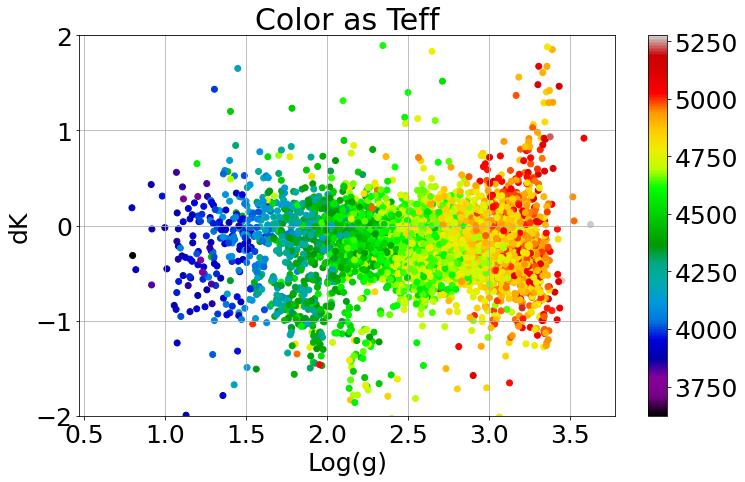

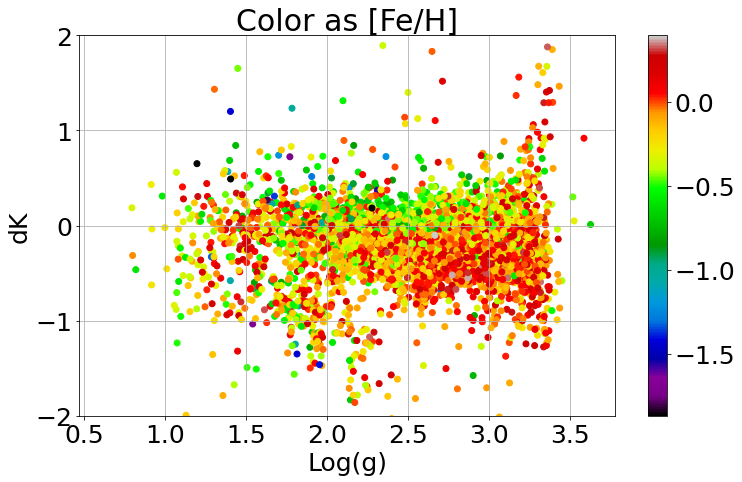

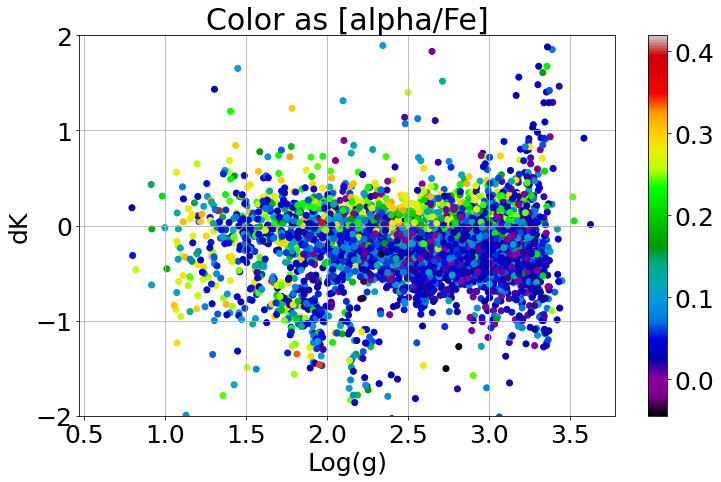

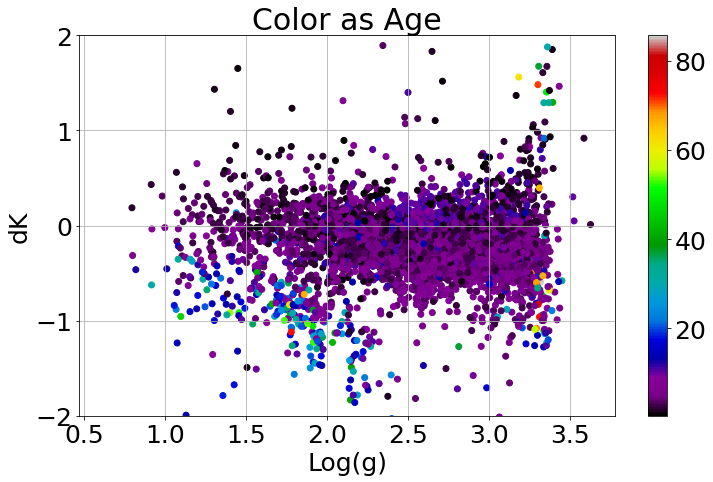

In [228]:
dfull_mag_colors = np.array([kdr17['TEFF'],kdr17['FE_H'],apoafe,k3dr17['IntAge']])
dfull_mag_titles = np.array(['Teff','[Fe/H]','[alpha/Fe]','Age'])

for i in range(len(dfull_mag_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(kdr17['LOGG'],dks_mag,c=dfull_mag_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-2.0,2.0)

    plt.title(r'Color as {}'.format(dfull_mag_titles[i]))
    plt.xlabel(r'Log(g)')
    plt.ylabel(r'dK')
    plt.grid()
    plt.show()

## [alpha/Fe] dTeff From Teff-K

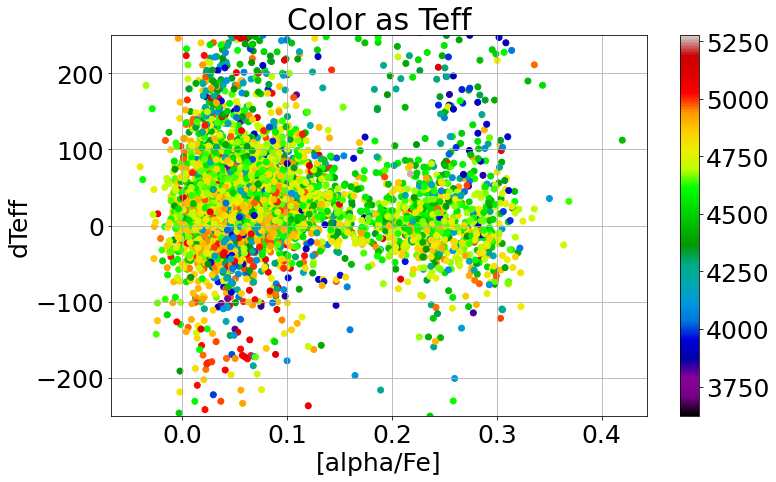

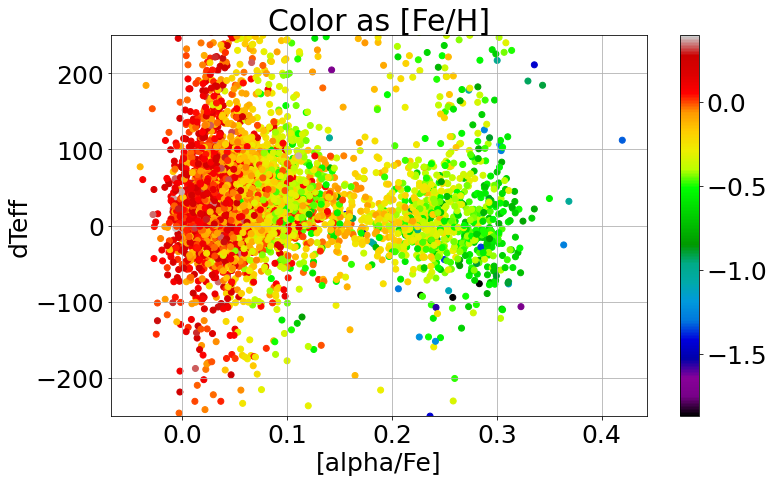

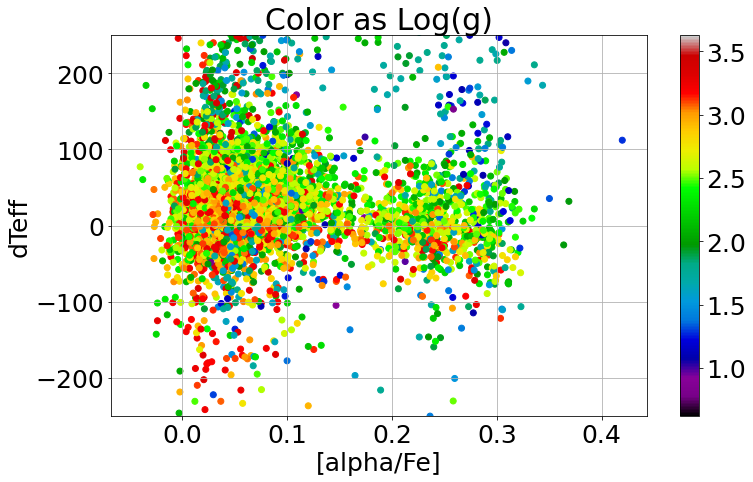

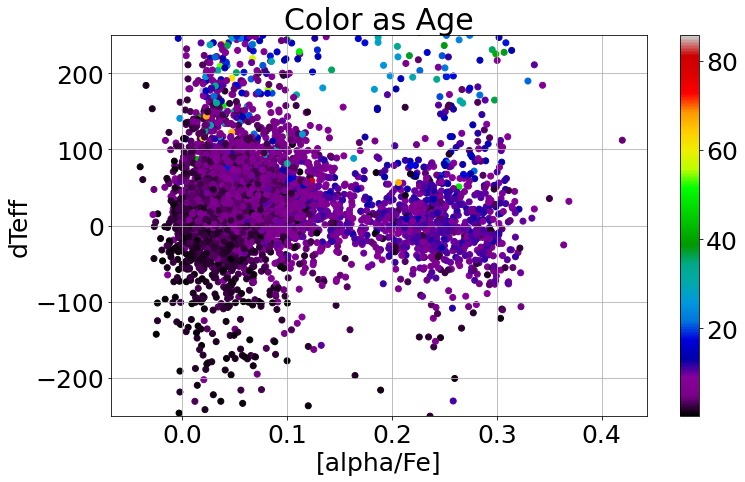

In [229]:
dfull_mag_colors = np.array([kdr17['TEFF'],kdr17['FE_H'],kdr17['LOGG'],k3dr17['IntAge']])
dfull_mag_titles = np.array(['Teff','[Fe/H]','Log(g)','Age'])

for i in range(len(dfull_mag_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(apoafe,dteffs_mag,c=dfull_mag_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-250,250)

    plt.title(r'Color as {}'.format(dfull_mag_titles[i]))
    plt.xlabel(r'[alpha/Fe]')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

## [alpha/Fe] dK From Teff-K

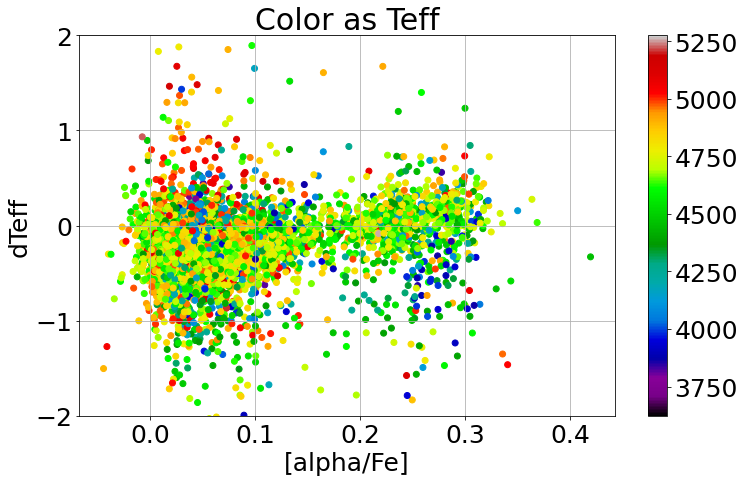

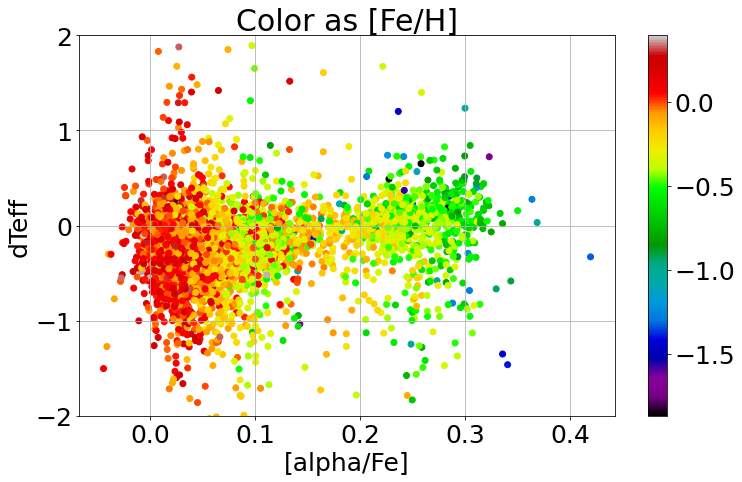

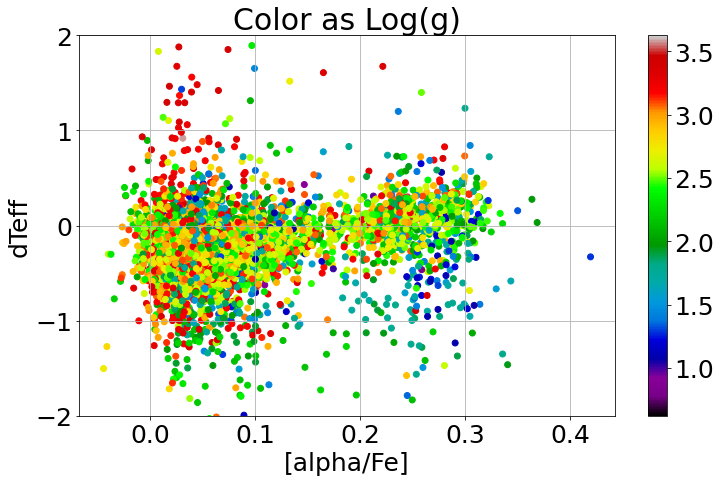

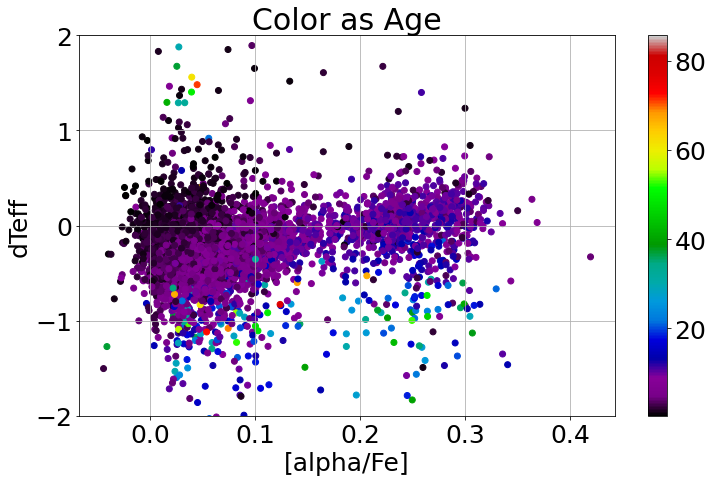

In [230]:
dfull_mag_colors = np.array([kdr17['TEFF'],kdr17['FE_H'],kdr17['LOGG'],k3dr17['IntAge']])
dfull_mag_titles = np.array(['Teff','[Fe/H]','Log(g)','Age'])

for i in range(len(dfull_mag_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(apoafe,dks_mag,c=dfull_mag_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-2.0,2.0)

    plt.title(r'Color as {}'.format(dfull_mag_titles[i]))
    plt.xlabel(r'[alpha/Fe]')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

## Age dTeff From Teff-K

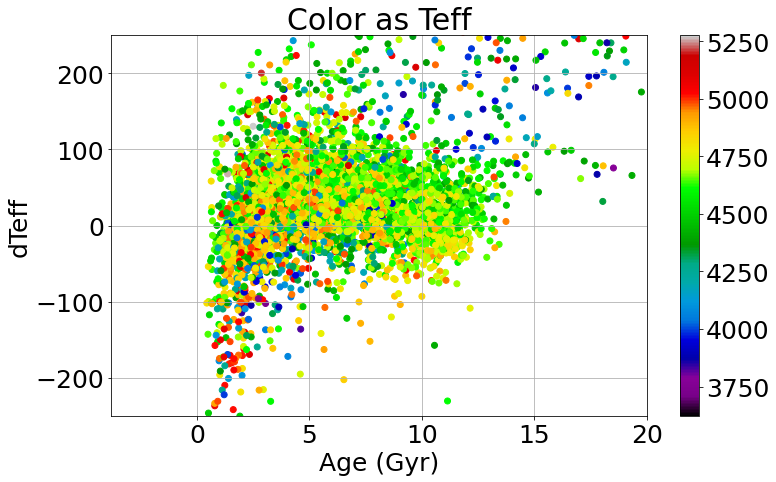

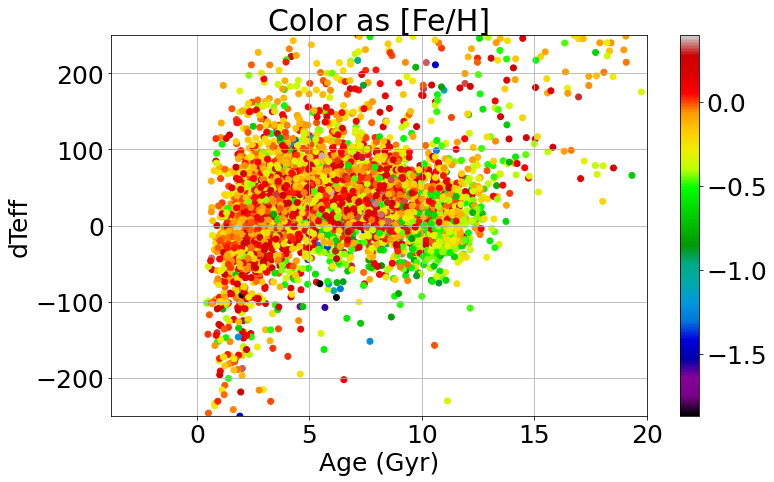

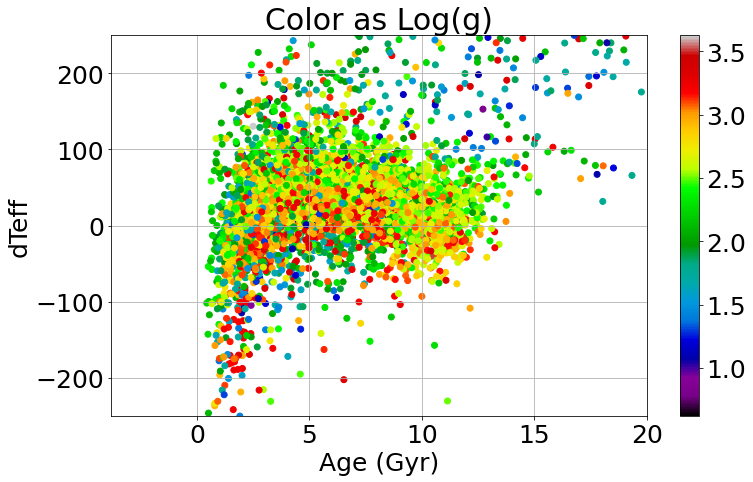

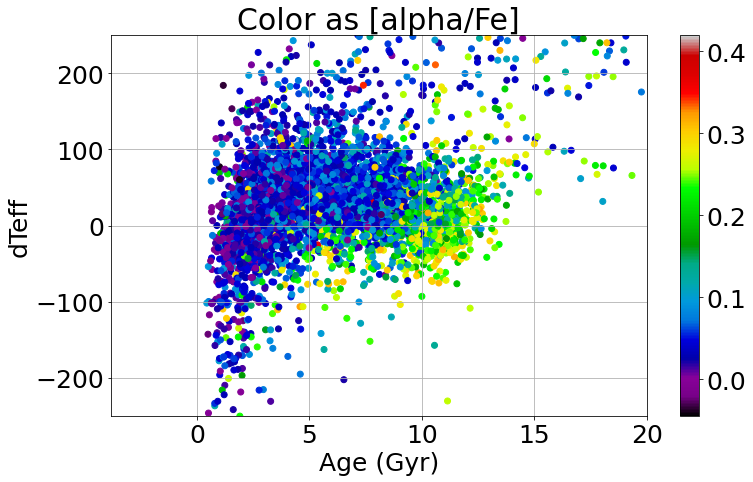

In [231]:
dfull_mag_colors = np.array([kdr17['TEFF'],kdr17['FE_H'],kdr17['LOGG'],apoafe])
dfull_mag_titles = np.array(['Teff','[Fe/H]','Log(g)','[alpha/Fe]'])

for i in range(len(dfull_mag_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(k3dr17['IntAge'],dteffs_mag,c=dfull_mag_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-250,250)
    plt.xlim(right=20)

    plt.title(r'Color as {}'.format(dfull_mag_titles[i]))
    plt.xlabel(r'Age (Gyr)')
    plt.ylabel(r'dTeff')
    plt.grid()
    plt.show()

## Age dK From Teff-K

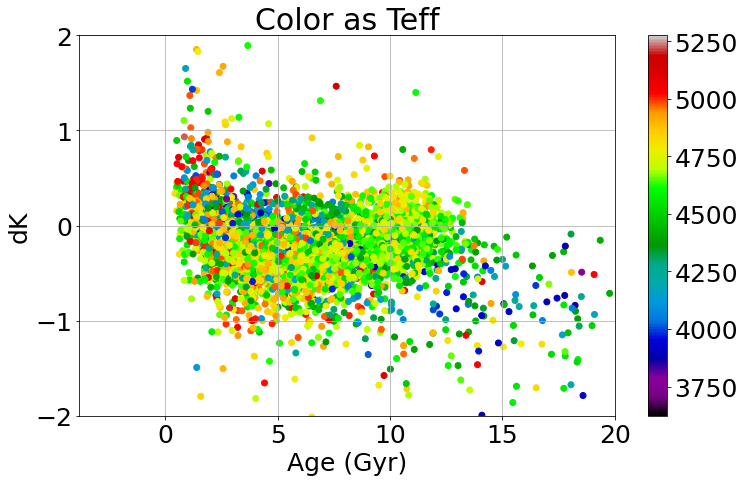

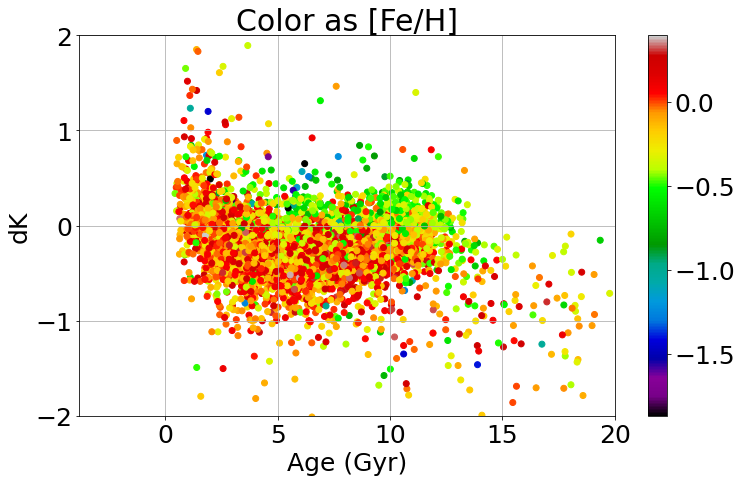

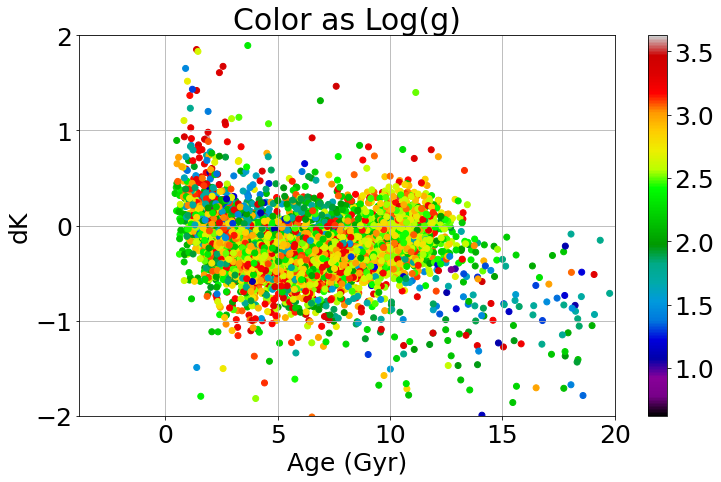

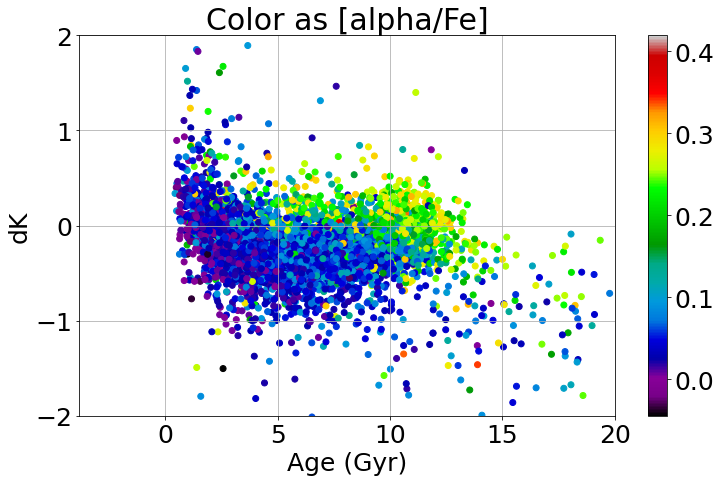

In [232]:
dfull_mag_colors = np.array([kdr17['TEFF'],kdr17['FE_H'],kdr17['LOGG'],apoafe])
dfull_mag_titles = np.array(['Teff','[Fe/H]','Log(g)','[alpha/Fe]'])

for i in range(len(dfull_mag_colors)):

    plt.figure(figsize=[12,7])
    plt.scatter(k3dr17['IntAge'],dks_mag,c=dfull_mag_colors[i],cmap='nipy_spectral')
    plt.colorbar()
    plt.ylim(-2.0,2.0)
    plt.xlim(right=20)

    plt.title(r'Color as {}'.format(dfull_mag_titles[i]))
    plt.xlabel(r'Age (Gyr)')
    plt.ylabel(r'dK')
    plt.grid()
    plt.show()

In [233]:
fincut = np.where((np.isfinite(kdr17['FE_H'])==True)&(np.isfinite(k3dr17['IntAge'])==True)&
                  (np.isfinite(apoafe)==True)&(np.isfinite(kdr17['LOGG'])==True)&
                  (np.isfinite(dteffs_mag)==True)&(k3dr17['IntAge']<20.)&(kdr17['FE_H']>-1.0)&
                  (dteffs_mag>-250)&(dteffs_mag<250))


### [Fe/H] age ###
print('Model: [Fe/H], Age')
pmodl = np.array([kdr17['FE_H'][fincut],k3dr17['IntAge'][fincut]]).T
pmodl = sm.add_constant(pmodl)
model = sm.RLM(dteffs_mag[fincut],pmodl).fit()
# print(model.summary())
predictions = model.predict(pmodl)
residual = predictions - dteffs_mag[fincut]
print('Params:',np.asarray(model.params))
print('Max Resid:',np.max(np.absolute(residual)))
print('Mad of Resid:',mad(residual))
print(r'-----')

print('Model: [Fe/H], [Fe/H]**2, age')
pmodl = np.array([kdr17['FE_H'][fincut],(kdr17['FE_H'][fincut])**2,k3dr17['IntAge'][fincut]]).T
pmodl = sm.add_constant(pmodl)
model = sm.RLM(dteffs_mag[fincut],pmodl).fit()
# print(model.summary())
predictions = model.predict(pmodl)
residual = predictions - dteffs_mag[fincut]
print('Params:',np.asarray(model.params))
print('Max Resid:',np.max(np.absolute(residual)))
print('Mad of Resid:',mad(residual))
print(r'-----')

print('Model: [Fe/H], [Fe/H]**2, [Fe/H]**3, age')
pmodl = np.array([kdr17['FE_H'][fincut],(kdr17['FE_H'][fincut])**2,(kdr17['FE_H'][fincut])**3,
                  k3dr17['IntAge'][fincut]]).T
pmodl = sm.add_constant(pmodl)
model = sm.RLM(dteffs_mag[fincut],pmodl).fit()
# print(model.summary())
predictions = model.predict(pmodl)
residual = predictions - dteffs_mag[fincut]
print('Params:',np.asarray(model.params))
print('Max Resid:',np.max(np.absolute(residual)))
print('Mad of Resid:',mad(residual))
print(r'-----')

Model: [Fe/H], Age
Params: [14.46629875 16.31645319  2.7584336 ]
Max Resid: 270.21718218095134
Mad of Resid: 30.9004906790274
-----
Model: [Fe/H], [Fe/H]**2, age
Params: [  16.02241006  -21.5642255  -126.66144246    3.21203133]
Max Resid: 281.7106968685283
Mad of Resid: 30.205011262710965
-----
Model: [Fe/H], [Fe/H]**2, [Fe/H]**3, age
Params: [  17.461025    -18.28020138 -180.64749594  -88.04420617    3.26940414]
Max Resid: 273.38476893539973
Mad of Resid: 30.11661815487104
-----


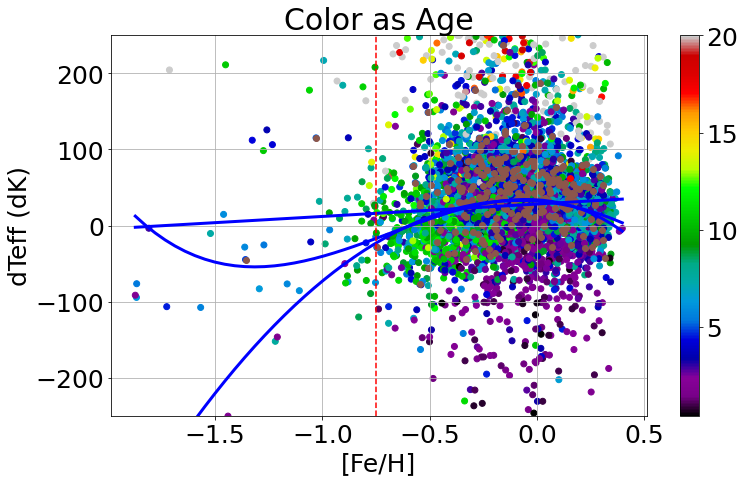

In [234]:
def fehage(feh,age):
    return 14.46629875 +  16.31645319*feh + 2.7584336*age

def fehsqage(feh,age):
    return 16.02241006 +  -21.5642255*feh -126.66144246*feh**2 + 3.21203133*age

def fehcuage(feh,age):
    return 17.461025 + -18.28020138*feh -180.64749594*feh**2 -88.04420617*feh**3 + 3.26940414*age

consage = 5
agecut = np.where((k3dr17['IntAge']<consage+0.25)&(k3dr17['IntAge']>consage-0.25))

plt.figure(figsize=[12,7])
plt.scatter(kdr17['FE_H'],dteffs_mag,c=k3dr17['IntAge'],cmap='nipy_spectral',vmax=20)
plt.colorbar()
plt.scatter(kdr17['FE_H'][agecut],dteffs_mag[agecut],c='tab:brown')

xs = np.linspace(min(kdr17['FE_H']),max(kdr17['FE_H']))

plt.plot(xs,fehage(xs,consage),lw=3.,c='b',label='10 Gyr Line')
plt.plot(xs,fehsqage(xs,consage),lw=3.,c='b',label='10 Gyr Quad')
plt.plot(xs,fehcuage(xs,consage),lw=3.,c='b',label='10 Gyr Quad')

plt.axvline(-0.75,c='r',ls='--')

plt.ylim(-250,250)

plt.title(r'Color as Age')
plt.xlabel(r'[Fe/H]')
plt.ylabel(r'dTeff (dK)')
plt.grid()
plt.show()

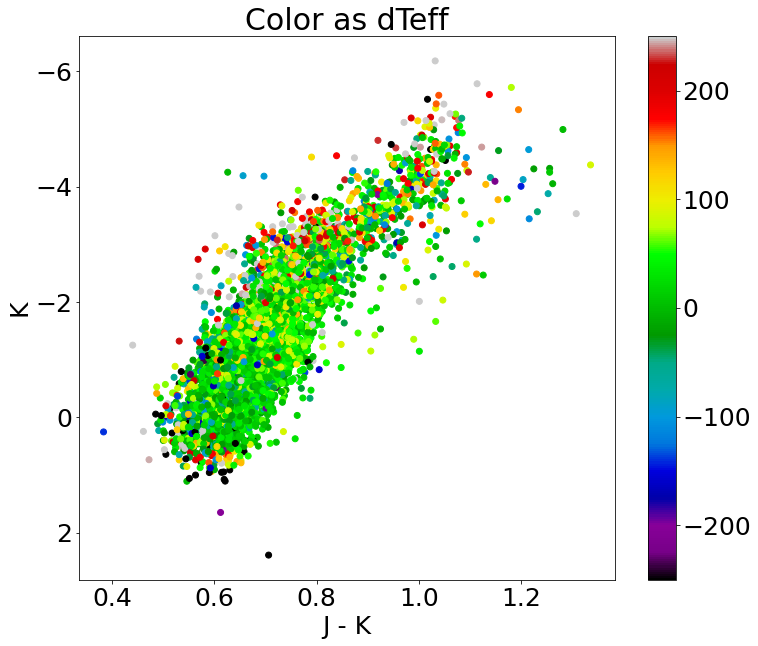

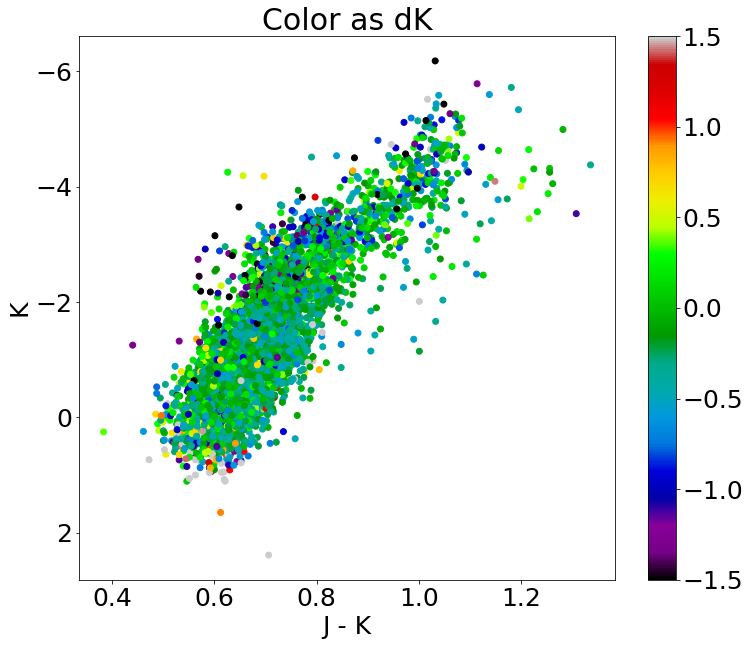

In [235]:
plt.figure(figsize=[12,10])
plt.scatter((kdr17['J']-kdr17['K'])[np.where(absK<1000)],absK[np.where(absK<1000)],
            c=dteffs_mag[np.where(absK<1000)],vmax=250,vmin=-250,cmap='nipy_spectral')
plt.colorbar()
plt.gca().invert_yaxis()
plt.title('Color as dTeff')
plt.xlabel(r'J - K')
plt.ylabel(r'K')
plt.show()

plt.figure(figsize=[12,10])
plt.scatter((kdr17['J']-kdr17['K'])[np.where(absK<1000)],absK[np.where(absK<1000)],
            c=dks_mag[np.where(absK<1000)],vmax=1.5,vmin=-1.5,cmap='nipy_spectral')
plt.colorbar()
plt.gca().invert_yaxis()
plt.title('Color as dK')
plt.xlabel(r'J - K')
plt.ylabel(r'K')
plt.show()

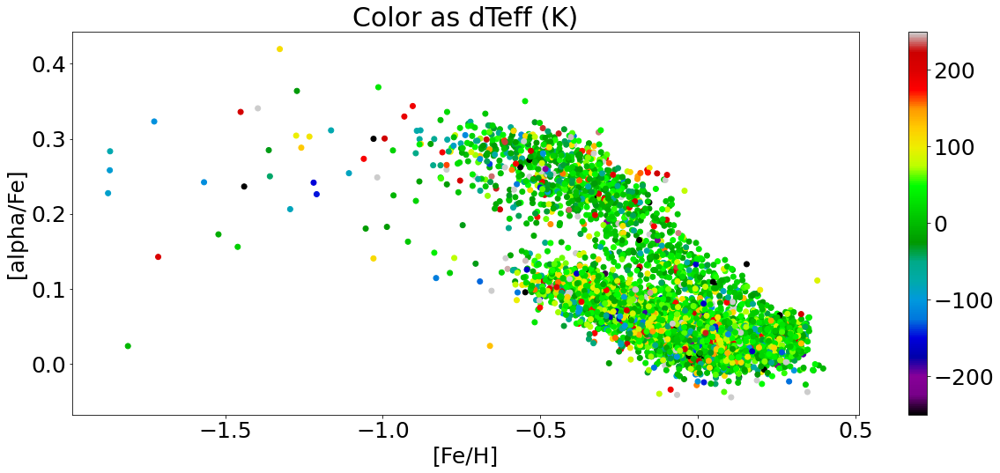

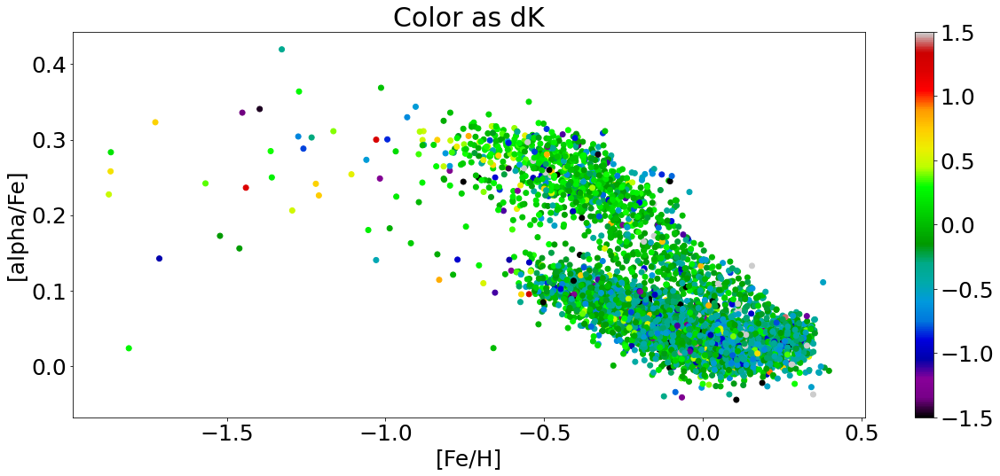

In [236]:
plt.figure(figsize=[20,8])
plt.scatter(kdr17['FE_H'][np.where(absK<1000)],apoafe[np.where(absK<1000)],c=dteffs_mag[np.where(absK<1000)],
            cmap='nipy_spectral',vmax=250,vmin=-250)
plt.title(r'Color as dTeff (K)')
plt.xlabel(r'[Fe/H]')
plt.ylabel(r'[alpha/Fe]')
plt.colorbar()

plt.figure(figsize=[20,8])
plt.scatter(kdr17['FE_H'][np.where(absK<1000)],apoafe[np.where(absK<1000)],c=dks_mag[np.where(absK<1000)],
            cmap='nipy_spectral',vmax=1.5,vmin=-1.5)
plt.title(r'Color as dK')
plt.xlabel(r'[Fe/H]')
plt.ylabel(r'[alpha/Fe]')
plt.colorbar()